In [4]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs

génération d'un dataset x y, comprenant 100 lignes et 2 variables grace à make_blobs

dimensions de X : (100, 2)
dimensions de y : (100, 1)


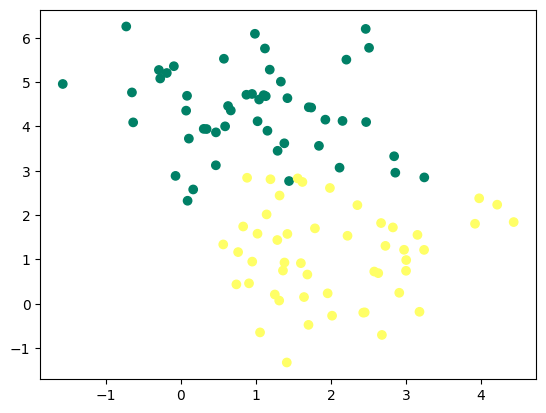

In [5]:
X, y = make_blobs(n_samples=100, centers=2, n_features=2, random_state=0)
y = y.reshape((y.shape[0], 1))

print(f"dimensions de X : {X.shape}")
print(f"dimensions de y : {y.shape}")

plt.scatter(X[:, 0], X[:, 1], c=y, cmap='summer')
plt.show()

création de la fonction d'initialisation

In [6]:
def initialisation(X) :
    W = np.random.randn(X.shape[1], 1)
    b = np.random.randn(1)
    return (W, b)

In [7]:
W, b = initialisation(X)

création de la fonction du model

$$
Z = X*W + b
$$

$$
A = \frac{1}{1+e^{-Z}}
$$

In [8]:
def model(X, W, b) :
    Z = np.dot(X, W) + b
    A = 1 / (1 + np.exp(-Z))
    return A

fonction coût

In [9]:
def log_loss(A, y) :
    return 1 / len(y) * np.sum(-y * np.log(A) - (1 - y) * np.log(1 - A))

fonction des gradients

$$
\begin{gather}
\frac{\partial \mathcal{L}}{\partial W} = \frac{1}{m}X^T * (A-y)\\
\frac{\partial \mathcal{L}}{\partial b} = \frac{1}{m} \sum (A-y)
\end{gather}
$$

In [10]:
def gradients(A, X, y) :
    dW = 1 / len(y) * np.dot(X.T, (A - y))
    db = 1 / len(y) * np.sum(A - y)
    return (dW, db)

fonction de mise à jour

$$
\begin{gather}
W = W - \alpha \frac{\partial \mathcal{L}}{\partial W}\\
b = b - \alpha \frac{\partial \mathcal{L}}{\partial b}
\end{gather}
$$

In [11]:
def update(W, b, dW, db, learning_rate) :
    W = W - learning_rate * dW
    b = b - learning_rate * db
    return (W, b)

ajout de la fonction de prédiction

In [ ]:
def predict(X, W, b):
    A = model(X, W, b)
    #print(A)
    return A >= 0.5

In [13]:
from sklearn.metrics import accuracy_score

fonction d'initialisation, rassemblant toutes les fonctions

In [14]:
def artificial_neuron(X, y, learning_rate=0.1, n_iterations=100) :
    W, b = initialisation(X)
    loss = []

    for i in range(n_iterations) :
        A = model(X, W, b)
        loss.append(log_loss(A, y))

        dW, db = gradients(A, X, y)
        W, b = update(W, b, dW, db, learning_rate)

    y_pred = predict(X, W, b)
    print(accuracy_score(y, y_pred))

    plt.plot(loss)
    plt.show()

    return (W, b)

[[0.96384559]
 [0.72355248]
 [0.00714998]
 [0.13813052]
 [0.95599087]
 [0.35173026]
 [0.08145228]
 [0.94541192]
 [0.05524565]
 [0.8352977 ]
 [0.0379372 ]
 [0.84793684]
 [0.03401066]
 [0.02159189]
 [0.69797749]
 [0.98071011]
 [0.98725469]
 [0.04184149]
 [0.6856743 ]
 [0.61780424]
 [0.05547984]
 [0.04342467]
 [0.38932968]
 [0.00706426]
 [0.93933147]
 [0.03991601]
 [0.86140186]
 [0.01252863]
 [0.0801716 ]
 [0.73540044]
 [0.96938336]
 [0.05368806]
 [0.63237357]
 [0.96990527]
 [0.40742236]
 [0.25917245]
 [0.74755472]
 [0.55059744]
 [0.47960761]
 [0.42511978]
 [0.07128833]
 [0.09897417]
 [0.0013366 ]
 [0.18107789]
 [0.20357946]
 [0.82175283]
 [0.95325496]
 [0.94434656]
 [0.00612221]
 [0.01302431]
 [0.92105997]
 [0.52643888]
 [0.06452906]
 [0.05186218]
 [0.8184982 ]
 [0.05256274]
 [0.71763562]
 [0.79670741]
 [0.93998897]
 [0.98583139]
 [0.62510423]
 [0.20485123]
 [0.00683573]
 [0.91397698]
 [0.02013455]
 [0.37085668]
 [0.04064941]
 [0.6356996 ]
 [0.9336847 ]
 [0.29086832]
 [0.18929214]
 [0.89

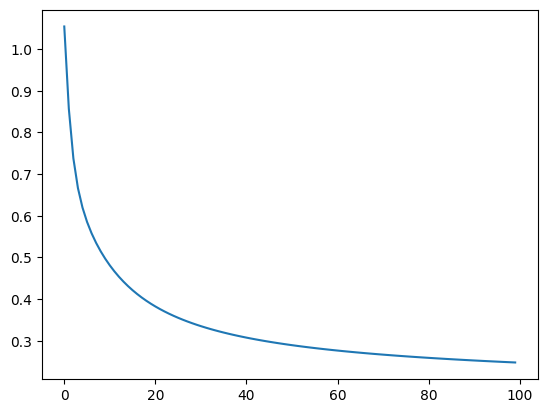

In [15]:
W, b = artificial_neuron(X, y)

In [16]:
W, b

(array([[ 1.21753949],
        [-0.96369682]]),
 array([0.30002091]))

maintenant, on récolte un élément, qu'on situe dans le dataset, puis on veut prédire à quelle classe elle appartient

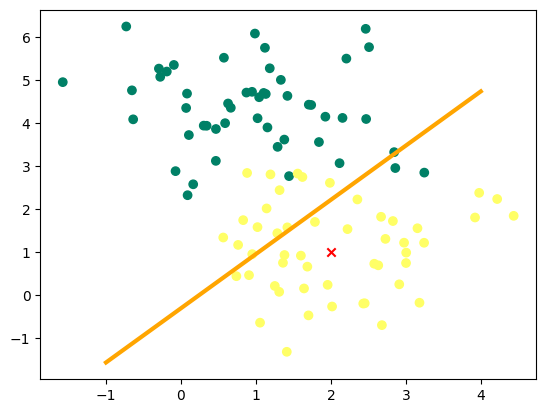

[0.85463207]


array([ True])

In [17]:
new_element = np.array([2, 1])

# pour tracer la frontière de décision
x0 = np.linspace(-1, 4, 100)
x1 = -(W[0] * x0 - b) / W[1]


plt.scatter(X[:, 0], X[:, 1], c=y, cmap='summer')
plt.scatter(new_element[0], new_element[1], c='red', marker='x')
plt.plot(x0, x1, c='orange', lw=3)
plt.show()
predict(new_element, W, b)

on vient de développer un code permettant d'entrainer des models de neurones artificiels
c'est comme si on venait de développer une usine à modèles
on peut alors fournir des données (dataset) à l'usine, et elle, elle nous retourne un model

maintenant, on aimerait donner à notre model des photos de chats et de chiens, afin qu'il nous retourne un model capable de classer ce genre de photos

In [18]:
from utilities import *

In [19]:
X_train, y_train, X_test, y_test = load_data()

In [20]:
print(f"dimensions de X_train : {X_train.shape}")
print(f"dimensions de y_train : {y_train.shape}")
print(np.unique(y_train, return_counts=True))

dimensions de X_train : (1000, 64, 64)
dimensions de y_train : (1000, 1)
(array([0., 1.]), array([500, 500]))


In [21]:
print(f"dimensions de X_test : {X_test.shape}")
print(f"dimensions de y_test : {y_test.shape}")
print(np.unique(y_test, return_counts=True))

dimensions de X_test : (200, 64, 64)
dimensions de y_test : (200, 1)
(array([0., 1.]), array([100, 100]))


maintenant, on utilise ces données directement dans notre fonction artificial_neuron

In [22]:
W, b = artificial_neuron(X_train, y_train)

C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3015143504.py:3: RuntimeWarning: overflow encountered in exp
  A = 1 / (1 + np.exp(-Z))
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3205743716.py:2: RuntimeWarning: divide by zero encountered in log
  return 1 / len(y) * np.sum(-y * np.log(A) - (1 - y) * np.log(1 - A))


ValueError: operands could not be broadcast together with shapes (1000,1) (1000,64,1) 

ces erreurs sont parfaitement normales, car nous avions codé un programme qui était capable de traiter des tableaux x à 2 dimensions, la 1ère pour les différentes données, la 2nde pour les différentes variables
or ici, on a X_train qui a 3 dimensions, il faut donc applatir chaque phtoo de notre datset afin de mettre sur un seul axe, uen seule dimension, tous les pixels de chaque photo, il faut donc faire 64*64 = 4096
pour cela on fait :

In [23]:
X_train_reshape = X_train.reshape(X_train.shape[0], -1)
X_train_reshape.shape

(1000, 4096)

In [24]:
X_test_reshape = X_test.reshape(X_test.shape[0], -1)
X_test_reshape.shape

(200, 4096)

on refait à présent le test

C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3015143504.py:3: RuntimeWarning: overflow encountered in exp
  A = 1 / (1 + np.exp(-Z))
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3205743716.py:2: RuntimeWarning: divide by zero encountered in log
  return 1 / len(y) * np.sum(-y * np.log(A) - (1 - y) * np.log(1 - A))
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3205743716.py:2: RuntimeWarning: invalid value encountered in multiply
  return 1 / len(y) * np.sum(-y * np.log(A) - (1 - y) * np.log(1 - A))


[[1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.

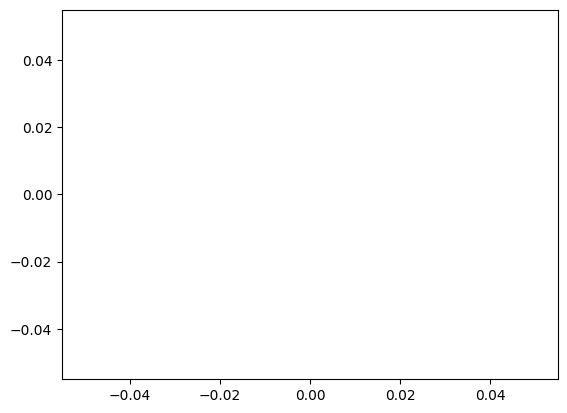

In [25]:
W, b = artificial_neuron(X_train_reshape, y_train)

il reste un problème dans notre code, une erreur qui vient de l'exponentielle : OverFlow error

In [26]:
from math import exp

In [27]:
exp(1000)

OverflowError: math range error

mathématiquement, on ne peut pas calculer ça, tout simplement parce que l'exp est la fonction qui croit le plus vite dans l'univers, donc très rapidement, on s'approche de l'infini, et donc de l'erreur car c'est trop grand

In [28]:
exp(200)

7.225973768125749e+86

pour info, le nb d'atomes dans l'univers est estimé à 10^80, donc rien qu'avec une exp200 on est déjà largement au-dessus

il va donc falloir, absolument, résoudre le problème de la valeur de notre Z qui fait exploser le truc

In [29]:
def model(X, W, b) :
    Z = X.dot(W) + b
    #print(Z.max())
    A = 1 / (1 + np.exp(-Z))
    return A

In [30]:
def artificial_neuron(X, y, learning_rate=0.1, n_iterations=100) :
    W, b = initialisation(X)
    loss = []

    for i in range(n_iterations) :
        A = model(X, W, b)
        loss.append(log_loss(A, y))

        dW, db = gradients(A, X, y)
        W, b = update(W, b, dW, db, learning_rate)

    y_pred = predict(X, W, b)
    print(accuracy_score(y, y_pred))

    plt.plot(loss)
    plt.show()

    return (W, b)

C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3990568963.py:4: RuntimeWarning: overflow encountered in exp
  A = 1 / (1 + np.exp(-Z))
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3205743716.py:2: RuntimeWarning: divide by zero encountered in log
  return 1 / len(y) * np.sum(-y * np.log(A) - (1 - y) * np.log(1 - A))
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3205743716.py:2: RuntimeWarning: invalid value encountered in multiply
  return 1 / len(y) * np.sum(-y * np.log(A) - (1 - y) * np.log(1 - A))


[[1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.

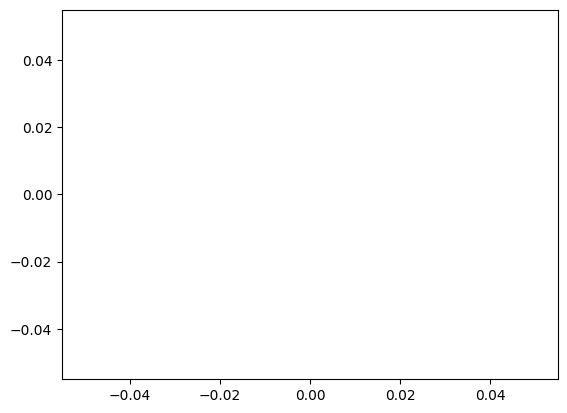

In [31]:
W, b = artificial_neuron(X_train_reshape, y_train)

comme nous disposons de valeurs Z qui sont importantes, que ce soit dans le positif comme le négatif, cela fait qu'on obtient une exp(-Z) qui nous retourne soit 0 soit plus l'infini (overflow error), du coup, quand on injecte cette exp(-Z) à l'intérieur de notre fonction sigmoide (def model) on obtient un résultat dans lequel on fera soit intervenir 0 soit l'infini

et cette valeur qu'on calcule, le exp(-Z) que nous mettons dans A, ce A nous l'utilisons dans la fonction log_loss dans laquelle nous utilisons le log, qui, quand on obtient la valeur 0 ne marche pas, tout simplement parce que mathématiquement log(0) n'existe pas

donc on fait passer dans log_loss la valeur A qui est soit 0 soit 1, alors même que log_loss utilise le log qui ne marche pas avec 0 ni 1 car font la même erreur

donc notre programme se retrouve dans l'incapacité de calculer le coût de notre model
ce qui fait que, il ne peut pas afficher notre courbe d'apprentissage
d'où le graphique vide

alors comment on peut faire pour éviter ces erreurs ?
on peut modifier notre fonction log_loss, pour faire intervenir une petite valeur epsilon dans les log

In [32]:
def log_loss(A, y) :
    epsilon = 1e-15
    return 1 / len(y) * np.sum(-y * np.log(A + epsilon) - (1 - y) * np.log(1 - A + epsilon))

avec ça on peut réentrainer notre model

C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\3990568963.py:4: RuntimeWarning: overflow encountered in exp
  A = 1 / (1 + np.exp(-Z))


[[1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.

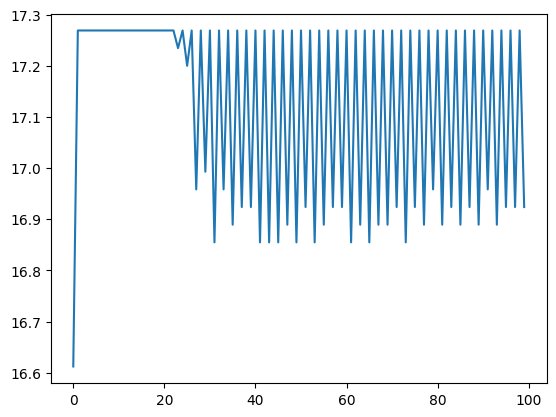

In [33]:
W, b = artificial_neuron(X_train_reshape, y_train)

bon on voit que le model n'a pas apprit grand chose, son apprentissage a plutôt été chaotique, car nous avons toujours notre overflow error
on va devoir effectuer une normalisation de nos données

mettre sur une même échelle toutes les variables d'un dataset, pour éviter que les plus grandes n'écrasent les plus petites

expérience sur normalisation des données

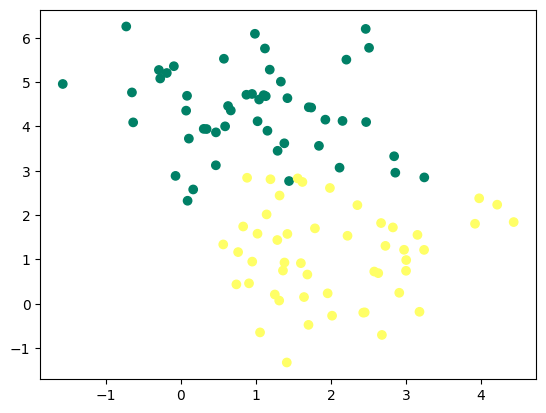

In [34]:
from sklearn.datasets import make_blobs
X, y = make_blobs(n_samples=100, centers=2, n_features=2, random_state=0)
y = y.reshape((y.shape[0], 1))
plt.scatter(X[:, 0], X[:, 1], c=y, cmap='summer')
plt.show()  

on définit une rangée de valeurs pour W1 et W2

In [35]:
lim = 10
h = 100
W1 = np.linspace(-lim, lim, h)
W1

array([-10.        ,  -9.7979798 ,  -9.5959596 ,  -9.39393939,
        -9.19191919,  -8.98989899,  -8.78787879,  -8.58585859,
        -8.38383838,  -8.18181818,  -7.97979798,  -7.77777778,
        -7.57575758,  -7.37373737,  -7.17171717,  -6.96969697,
        -6.76767677,  -6.56565657,  -6.36363636,  -6.16161616,
        -5.95959596,  -5.75757576,  -5.55555556,  -5.35353535,
        -5.15151515,  -4.94949495,  -4.74747475,  -4.54545455,
        -4.34343434,  -4.14141414,  -3.93939394,  -3.73737374,
        -3.53535354,  -3.33333333,  -3.13131313,  -2.92929293,
        -2.72727273,  -2.52525253,  -2.32323232,  -2.12121212,
        -1.91919192,  -1.71717172,  -1.51515152,  -1.31313131,
        -1.11111111,  -0.90909091,  -0.70707071,  -0.50505051,
        -0.3030303 ,  -0.1010101 ,   0.1010101 ,   0.3030303 ,
         0.50505051,   0.70707071,   0.90909091,   1.11111111,
         1.31313131,   1.51515152,   1.71717172,   1.91919192,
         2.12121212,   2.32323232,   2.52525253,   2.72

In [36]:
W2 = np.linspace(-lim, lim, h)
W2

array([-10.        ,  -9.7979798 ,  -9.5959596 ,  -9.39393939,
        -9.19191919,  -8.98989899,  -8.78787879,  -8.58585859,
        -8.38383838,  -8.18181818,  -7.97979798,  -7.77777778,
        -7.57575758,  -7.37373737,  -7.17171717,  -6.96969697,
        -6.76767677,  -6.56565657,  -6.36363636,  -6.16161616,
        -5.95959596,  -5.75757576,  -5.55555556,  -5.35353535,
        -5.15151515,  -4.94949495,  -4.74747475,  -4.54545455,
        -4.34343434,  -4.14141414,  -3.93939394,  -3.73737374,
        -3.53535354,  -3.33333333,  -3.13131313,  -2.92929293,
        -2.72727273,  -2.52525253,  -2.32323232,  -2.12121212,
        -1.91919192,  -1.71717172,  -1.51515152,  -1.31313131,
        -1.11111111,  -0.90909091,  -0.70707071,  -0.50505051,
        -0.3030303 ,  -0.1010101 ,   0.1010101 ,   0.3030303 ,
         0.50505051,   0.70707071,   0.90909091,   1.11111111,
         1.31313131,   1.51515152,   1.71717172,   1.91919192,
         2.12121212,   2.32323232,   2.52525253,   2.72

In [37]:
W11, W22 = np.meshgrid(W1, W2)

In [38]:
W_final = np.c_[W11.ravel(), W22.ravel()].T
W_final.shape

(2, 10000)

In [39]:
b = 0
z = X.dot(W_final) +b
A = 1 / (1 + np.exp(-z))

epsilon = 1e-15
L = 1 / len(y) * np.sum(-y * np.log(A + epsilon) - (1 - y) * np.log(1 - A + epsilon), axis=0).reshape(W11.shape)
L.shape

(100, 100)

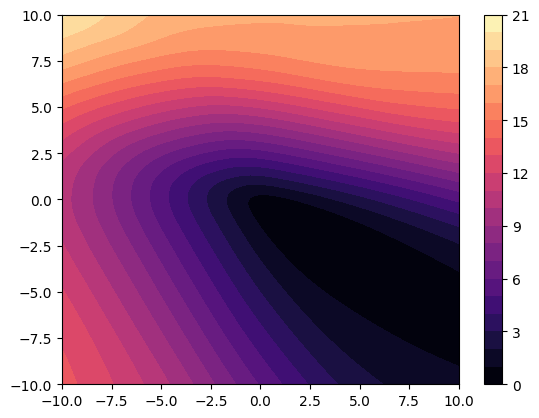

In [40]:
plt.contourf(W11, W22, L, 20, cmap='magma')
plt.colorbar()

donc on vient de démontrer que quand une variable devient trop imposante, le graphique commence à se compresser

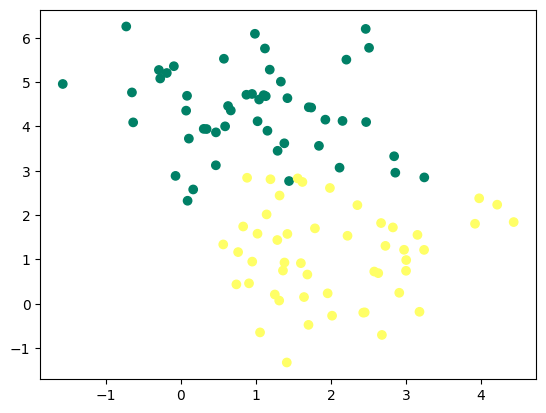

In [41]:
from sklearn.datasets import make_blobs
X, y = make_blobs(n_samples=100, centers=2, n_features=2, random_state=0)
X[:, 1] = X[:, 1] * 1
y = y.reshape((y.shape[0], 1))
plt.scatter(X[:, 0], X[:, 1], c=y, cmap='summer')
plt.show()  

In [42]:
b = 0
z = X.dot(W_final) +b
A = 1 / (1 + np.exp(-z))

epsilon = 1e-15
L = 1 / len(y) * np.sum(-y * np.log(A + epsilon) - (1 - y) * np.log(1 - A + epsilon), axis=0).reshape(W11.shape)
L.shape

(100, 100)

on obtient une fonction cout complètement compressée, du coup notre alog de descente de gradient va avoir du mal à converger pour trouver le minimum, ce qui donne les zig zag de toute à l'heure

In [44]:
def articial_neuron_2(X, y, learning_rate=0.1, n_iterations=1000) :
    W, b = initialisation(X)

    W[0], W[1] = -7.5, -7.5

    nb = 10
    j = 0
    history = np.zeros((n_iterations // nb, 5))
    loss = []

    for i in range(n_iterations) :
        A = model(X, W, b)
        loss.append(log_loss(A, y))

        dW, db = gradients(A, X, y)
        W, b = update(W, b, dW, db, learning_rate)

        if (i % nb == 0) :
            history[j, 0] = i
            history[j, 1] = W[0]
            history[j, 2] = W[1]
            history[j, 3] = b
            history[j, 4] = log_loss(A, y)
            j += 1

    # y_pred = predict(X, W, b)
    # print(accuracy_score(y, y_pred))

    plt.plot(loss)
    plt.show()

    return (b, history)

C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\1915410673.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  history[j, 1] = W[0]
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\1915410673.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  history[j, 2] = W[1]
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_8940\1915410673.py:22: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  history[j, 3] = b


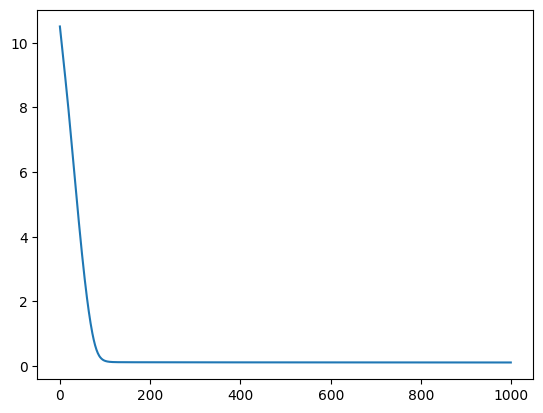

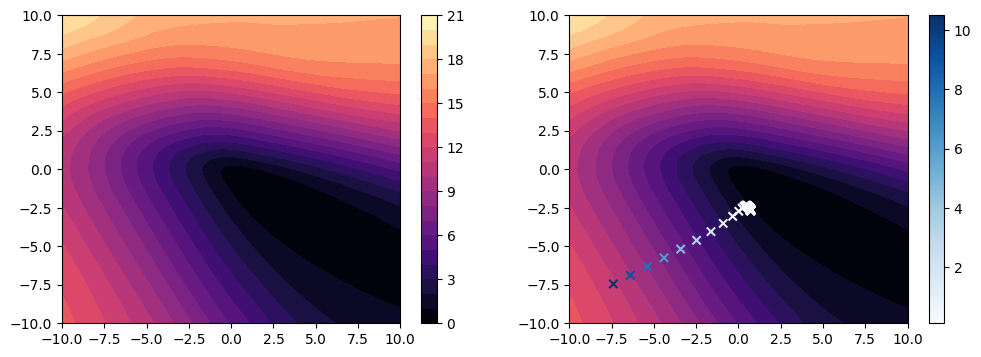

In [46]:
# plt.contourf(W11, W22, L, 20, cmap='magma')
# plt.colorbar()

# First, run the function to get history
b_val, history = articial_neuron_2(X, y)

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.contourf(W11, W22, L, 20, cmap='magma')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.contourf(W11, W22, L, 20, cmap='magma')
plt.scatter(history[:, 1], history[:, 2], c=history[:, 4], cmap='Blues', marker='x')
plt.colorbar()

C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_13364\1915410673.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  history[j, 1] = W[0]
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_13364\1915410673.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  history[j, 2] = W[1]
C:\Users\blemeill.LESMUIDS\AppData\Local\Temp\ipykernel_13364\1915410673.py:22: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  history[j, 3] = b


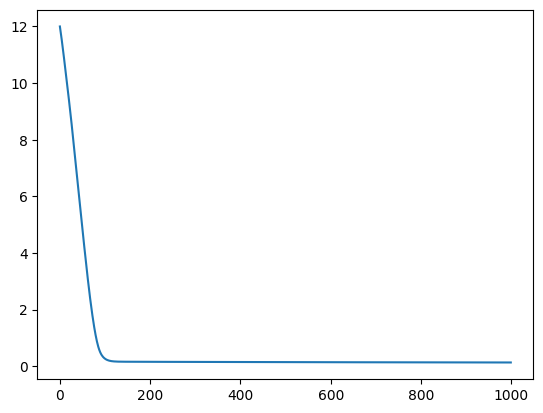

In [ ]:
history, b = articial_neuron_2(X, y)

du coup, comment on fait une normalisation ?

normalisation MinMax :
$$
X = \frac{X-X_min}{X_max - X_min}
$$

In [47]:
X_train_reshape = X_train.reshape(X_train.shape[0], -1) / X_train.max()
X_train_reshape.shape

(1000, 4096)

In [48]:
X_test_reshape = X_test.reshape(X_test.shape[0], -1) / X_train.max()
X_test_reshape.shape

(200, 4096)

[[1.03531559e-14]
 [1.15256834e-02]
 [8.51851290e-15]
 [1.24635984e-02]
 [7.84220794e-08]
 [7.56517426e-06]
 [1.64596804e-11]
 [1.96811308e-14]
 [8.14911380e-07]
 [3.55942453e-06]
 [4.41493541e-02]
 [5.00237012e-09]
 [2.98162370e-08]
 [6.79246478e-06]
 [5.23441762e-11]
 [2.68627178e-07]
 [1.68341280e-08]
 [1.53600262e-11]
 [1.65259361e-17]
 [1.25776208e-08]
 [7.22349216e-14]
 [5.51068146e-09]
 [3.97595323e-05]
 [3.04370536e-21]
 [7.32999776e-08]
 [3.01320713e-06]
 [9.79700867e-07]
 [1.37925696e-13]
 [3.38343735e-07]
 [4.83486218e-05]
 [4.73161288e-13]
 [5.39355482e-13]
 [1.44138288e-16]
 [1.25103114e-07]
 [1.79838350e-20]
 [3.94095354e-11]
 [6.94780894e-09]
 [3.78621715e-10]
 [2.50248274e-06]
 [2.28965194e-08]
 [2.51376095e-07]
 [3.73346252e-11]
 [6.14751913e-01]
 [2.76500071e-12]
 [3.38942431e-05]
 [6.63478867e-14]
 [3.91777917e-09]
 [5.32424598e-11]
 [1.50349692e-06]
 [1.31346963e-03]
 [3.30300455e-13]
 [2.28987932e-05]
 [3.30011147e-09]
 [8.10886780e-08]
 [4.10421553e-09]
 [3.939867

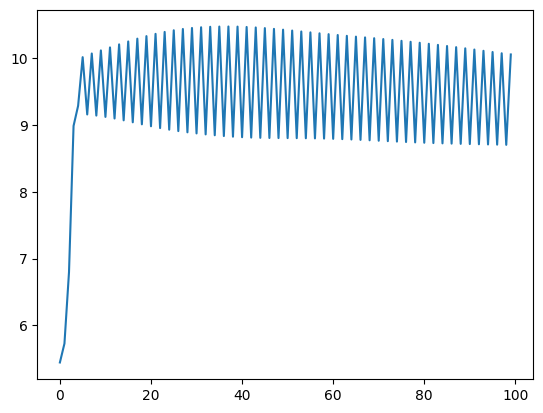

In [49]:
W, b = artificial_neuron(X_train_reshape, y_train)

maintenant, on va gérer les hyper-paramètres de notre model

si notre algo de descente de gradient décide de faire des pas beaucoup trop grands, alors il va osciller et faire des va et viens
c'est pourquoi on va définir un learning_rate à par ex 0.01
on peut aussi ajouter plus d'itérations

[[9.98593154e-01]
 [9.99887075e-01]
 [9.98584852e-01]
 [6.22270147e-02]
 [3.86342377e-01]
 [9.30178529e-01]
 [6.31710000e-02]
 [3.89761328e-06]
 [9.93663142e-01]
 [3.29073596e-10]
 [3.56426206e-01]
 [9.99999633e-01]
 [3.24586044e-04]
 [5.28526411e-01]
 [6.72680758e-01]
 [2.27041474e-02]
 [5.23353699e-01]
 [9.99995032e-01]
 [1.51824553e-01]
 [1.20513039e-04]
 [4.04649350e-04]
 [9.99803490e-01]
 [2.39128669e-01]
 [8.29812000e-01]
 [9.89500449e-01]
 [4.15796873e-02]
 [9.25931136e-03]
 [4.78501026e-03]
 [6.93102763e-01]
 [8.05543385e-01]
 [3.72301555e-01]
 [9.99999813e-01]
 [3.00545932e-01]
 [8.68779827e-06]
 [8.87912625e-01]
 [8.14331241e-01]
 [4.77948428e-04]
 [7.23191020e-01]
 [9.60292078e-04]
 [2.61332353e-04]
 [3.35165786e-01]
 [1.06392954e-02]
 [9.99999892e-01]
 [9.99981690e-01]
 [9.99999925e-01]
 [6.60622042e-03]
 [3.87982046e-02]
 [1.04849399e-01]
 [9.97794713e-01]
 [9.69614613e-04]
 [9.99494921e-01]
 [2.55944827e-05]
 [2.23070418e-08]
 [3.05128875e-04]
 [9.09856290e-07]
 [1.183513

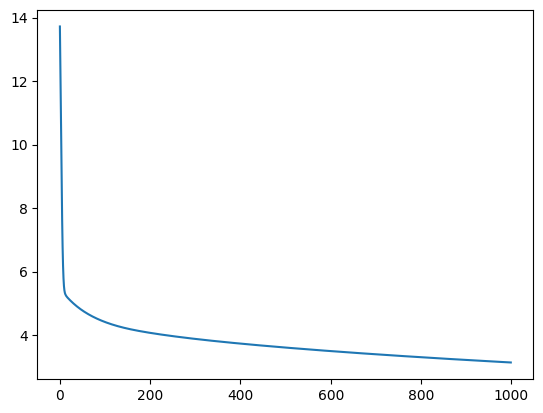

In [50]:
W, b = artificial_neuron(X_train_reshape, y_train, learning_rate = 0.01, n_iterations=1000)

maintenant on veut savoir quelle est la performance de notre model

In [51]:
def artificial_neuron(X, y, learning_rate=0.1, n_iterations=100) :
    W, b = initialisation(X)

    loss = []
    acc = []

    # boucle d'apprentissage
    for i in range(n_iterations) :

        # activations
        A = model(X, W, b)

        # calcul 
        loss.append(log_loss(A, y))

        # calcul de l'accuracy
        y_pred = predict(X, W, b)
        acc.append(accuracy_score(y, y_pred))

        dW, db = gradients(A, X, y)
        W, b = update(W, b, dW, db, learning_rate)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(loss)
    plt.subplot(1, 2, 2)
    plt.plot(acc)
    plt.show()

    return (W, b)

[[1.39726978e-12]
 [1.00309231e-09]
 [2.34664175e-18]
 [5.90018448e-14]
 [5.32852314e-10]
 [1.10541186e-09]
 [9.76206168e-01]
 [1.95569318e-02]
 [2.70326468e-13]
 [9.99710326e-01]
 [8.80327337e-02]
 [1.07283141e-08]
 [1.32903402e-03]
 [1.83471665e-10]
 [3.62747983e-02]
 [3.94966786e-08]
 [1.64231455e-03]
 [3.66040929e-08]
 [9.19607302e-05]
 [5.84658538e-18]
 [9.99999025e-01]
 [3.42557787e-04]
 [3.37086436e-07]
 [1.79249816e-07]
 [9.99733994e-01]
 [6.91808169e-10]
 [3.67237892e-10]
 [9.99983797e-01]
 [1.12475175e-12]
 [5.45683871e-07]
 [2.16237692e-02]
 [9.82657111e-11]
 [9.99441089e-01]
 [2.66949265e-04]
 [4.85066948e-14]
 [1.73818820e-10]
 [2.46090543e-02]
 [1.48319028e-09]
 [2.02181909e-06]
 [1.30228744e-20]
 [2.24758252e-03]
 [3.38852656e-10]
 [8.62880035e-01]
 [1.76060142e-10]
 [9.00524434e-04]
 [6.22672820e-17]
 [6.14804114e-05]
 [7.54356401e-09]
 [3.64700326e-03]
 [7.75382600e-03]
 [9.99867461e-01]
 [2.13774899e-05]
 [3.71740646e-08]
 [1.73579495e-01]
 [1.63122697e-16]
 [7.014982

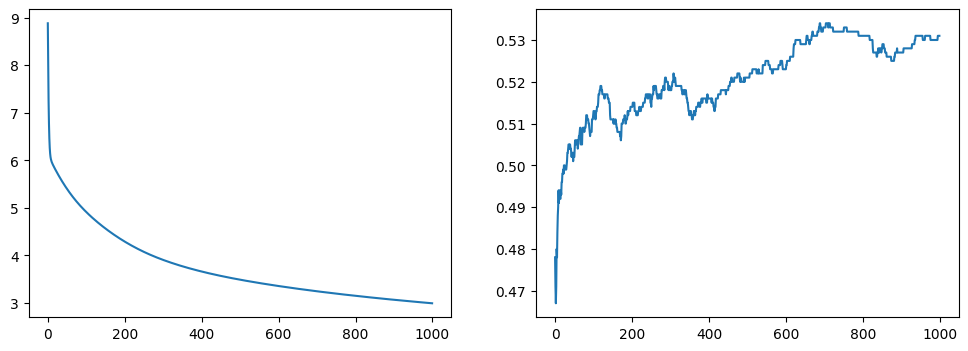

In [52]:
W, b = artificial_neuron(X_train_reshape, y_train, learning_rate = 0.01, n_iterations=1000)

le modèle aurait besoin de plus de temps pour se stabiliser, pour apprendre, il aurait besoin de plus d'itération
on pourrait donc augmenter le nb d'itération, mais attention en faisant ça, le code va être considérablement ralenti
il faut alors mieux ajouter la petite modfi suivante :

In [53]:
# pour ajouter une barre de progression d'un code très long
from tqdm import tqdm

In [55]:
def artificial_neuron(X, y, learning_rate=0.1, n_iterations=100) :
    W, b = initialisation(X)

    loss = []
    acc = []

    # boucle d'apprentissage
    for i in tqdm(range(n_iterations)) :

        # activations
        A = model(X, W, b)

        if i%10 == 0 : # améliore la rapidité du code

            # calcul 
            loss.append(log_loss(A, y))

            # calcul de l'accuracy
            y_pred = predict(X, W, b)
            acc.append(accuracy_score(y, y_pred))

        dW, db = gradients(A, X, y)
        W, b = update(W, b, dW, db, learning_rate)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(loss)
    plt.subplot(1, 2, 2)
    plt.plot(acc)
    plt.show()

    return (W, b)

  0%|          | 0/1000 [00:00<?, ?it/s]

  1%|          | 9/1000 [00:00<00:12, 81.20it/s]

[[1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99958688e-01]
 [1.00000000e+00]
 [9.99999972e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999999e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99991296e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99996756e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [3.11038893e-01]
 [1.00000000e+00]
 [9.99999327e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999607e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999807e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999894e-01]
 [9.99999999e-01]
 [9.99976100e-01]
 [4.39522333e-06]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.000000

  4%|▍         | 38/1000 [00:00<00:11, 82.58it/s]

[[9.99857486e-01]
 [9.99921048e-01]
 [9.99871340e-01]
 [9.99999984e-01]
 [9.99868784e-01]
 [2.84943838e-05]
 [6.75507992e-01]
 [3.76014257e-02]
 [9.99999374e-01]
 [9.99999986e-01]
 [8.13992030e-01]
 [9.99999999e-01]
 [2.13055012e-02]
 [5.99530764e-01]
 [9.99627127e-01]
 [9.96723384e-01]
 [9.60243080e-01]
 [9.97402270e-01]
 [9.99999793e-01]
 [1.00000000e+00]
 [6.53100414e-09]
 [1.65562530e-01]
 [6.92594119e-01]
 [9.99167266e-01]
 [4.30801382e-05]
 [9.76068624e-01]
 [9.52281962e-01]
 [6.40613362e-12]
 [9.99999984e-01]
 [4.39004530e-02]
 [9.99999126e-01]
 [9.46686878e-01]
 [6.96107892e-01]
 [2.10225940e-03]
 [1.00000000e+00]
 [9.99999900e-01]
 [9.99999912e-01]
 [6.19677063e-06]
 [4.36908703e-01]
 [1.00000000e+00]
 [9.99829469e-01]
 [9.96252117e-01]
 [1.00000000e+00]
 [9.99988991e-01]
 [8.97831725e-02]
 [1.78844249e-04]
 [9.99986786e-01]
 [7.76000171e-06]
 [1.15744026e-03]
 [9.56596461e-04]
 [1.00895089e-15]
 [1.00000000e+00]
 [1.62237002e-01]
 [9.92287921e-01]
 [9.99999998e-01]
 [9.996551

  8%|▊         | 79/1000 [00:00<00:07, 116.97it/s]

[[9.99948119e-01]
 [9.99718411e-01]
 [9.76961062e-01]
 [9.99999007e-01]
 [9.99925937e-01]
 [1.23896847e-05]
 [4.81532614e-01]
 [2.17172209e-03]
 [9.99969017e-01]
 [9.99999983e-01]
 [2.07445087e-01]
 [9.99999996e-01]
 [3.57520659e-02]
 [1.40534345e-01]
 [9.99469424e-01]
 [9.81575378e-01]
 [8.95161687e-01]
 [9.53987412e-01]
 [9.99989069e-01]
 [9.99999998e-01]
 [9.95603044e-08]
 [1.46726740e-01]
 [6.65301509e-01]
 [9.98869831e-01]
 [1.23568269e-03]
 [9.73680437e-01]
 [8.89961785e-01]
 [1.45140872e-10]
 [9.99999501e-01]
 [1.49147507e-01]
 [9.99997756e-01]
 [8.31362483e-01]
 [7.39093962e-01]
 [4.34854237e-03]
 [1.00000000e+00]
 [9.99998019e-01]
 [9.99998573e-01]
 [1.90111189e-05]
 [6.76955422e-01]
 [1.00000000e+00]
 [9.99283576e-01]
 [9.97531143e-01]
 [1.00000000e+00]
 [9.99966945e-01]
 [6.48468843e-01]
 [1.89473077e-04]
 [9.99840013e-01]
 [3.25765292e-06]
 [2.87828275e-03]
 [2.97001861e-03]
 [8.25186332e-14]
 [9.99999999e-01]
 [4.15075398e-01]
 [9.87449480e-01]
 [9.99999907e-01]
 [9.827954

 10%|█         | 104/1000 [00:01<00:08, 109.43it/s]

[[9.99978632e-01]
 [9.99335694e-01]
 [4.78271922e-01]
 [9.99974696e-01]
 [9.99960604e-01]
 [7.64296203e-06]
 [4.16100120e-01]
 [2.68605160e-04]
 [9.99266821e-01]
 [9.99999977e-01]
 [3.36242435e-02]
 [9.99999986e-01]
 [5.47542980e-02]
 [4.09324901e-02]
 [9.99397100e-01]
 [9.40574324e-01]
 [8.06736665e-01]
 [7.14863320e-01]
 [9.99795154e-01]
 [9.99999943e-01]
 [1.16278903e-06]
 [1.61769748e-01]
 [6.51796697e-01]
 [9.98331526e-01]
 [2.22743764e-02]
 [9.77503360e-01]
 [8.25953042e-01]
 [2.89167246e-09]
 [9.99993029e-01]
 [3.45648764e-01]
 [9.99995956e-01]
 [6.66298597e-01]
 [7.90282845e-01]
 [1.02892691e-02]
 [1.00000000e+00]
 [9.99981591e-01]
 [9.99988402e-01]
 [7.10912304e-05]
 [8.45668732e-01]
 [1.00000000e+00]
 [9.98126836e-01]
 [9.98442444e-01]
 [1.00000000e+00]
 [9.99932260e-01]
 [9.60033420e-01]
 [2.95139081e-04]
 [9.99045108e-01]
 [2.57920360e-06]
 [7.56113647e-03]
 [7.95311623e-03]
 [3.80997535e-12]
 [9.99999995e-01]
 [7.33614164e-01]
 [9.86010157e-01]
 [9.99997733e-01]
 [7.687960

 12%|█▏        | 116/1000 [00:01<00:07, 110.85it/s]

[[9.99988795e-01]
 [9.98809583e-01]
 [6.16221432e-02]
 [9.99702139e-01]
 [9.99976573e-01]
 [5.95640823e-06]
 [4.42978746e-01]
 [6.71926936e-05]
 [9.91040420e-01]
 [9.99999963e-01]
 [8.87572248e-03]
 [9.99999956e-01]
 [7.03015320e-02]
 [2.12373040e-02]
 [9.99397240e-01]
 [8.78646803e-01]
 [7.19817573e-01]
 [3.67411340e-01]
 [9.98413038e-01]
 [9.99999428e-01]
 [8.85055432e-06]
 [1.94797466e-01]
 [6.26177311e-01]
 [9.97072903e-01]
 [1.91275568e-01]
 [9.81782208e-01]
 [7.73659124e-01]
 [4.17809645e-08]
 [9.99951612e-01]
 [5.39489337e-01]
 [9.99994182e-01]
 [5.14396198e-01]
 [8.29965509e-01]
 [2.44150226e-02]
 [9.99999997e-01]
 [9.99909116e-01]
 [9.99944274e-01]
 [2.63419989e-04]
 [9.23864027e-01]
 [1.00000000e+00]
 [9.96454811e-01]
 [9.98932379e-01]
 [1.00000000e+00]
 [9.99893664e-01]
 [9.95017124e-01]
 [5.56765428e-04]
 [9.96799099e-01]
 [3.14708803e-06]
 [1.82130961e-02]
 [1.68540171e-02]
 [8.57929543e-11]
 [9.99999979e-01]
 [9.05113981e-01]
 [9.87152554e-01]
 [9.99974696e-01]
 [3.270292

 15%|█▌        | 151/1000 [00:01<00:10, 84.64it/s] 

[[9.99991844e-01]
 [9.98382605e-01]
 [1.69906693e-02]
 [9.98851914e-01]
 [9.99982126e-01]
 [5.38618138e-06]
 [4.84989901e-01]
 [3.45083828e-05]
 [9.64092905e-01]
 [9.99999945e-01]
 [4.52980526e-03]
 [9.99999903e-01]
 [7.68915223e-02]
 [1.67282176e-02]
 [9.99411759e-01]
 [8.31497891e-01]
 [6.65445199e-01]
 [2.14885286e-01]
 [9.95486783e-01]
 [9.99998092e-01]
 [2.78166860e-05]
 [2.21266798e-01]
 [6.00864869e-01]
 [9.95409548e-01]
 [4.62254509e-01]
 [9.83845706e-01]
 [7.42045771e-01]
 [2.03349136e-07]
 [9.99864639e-01]
 [6.35844577e-01]
 [9.99993044e-01]
 [4.32304332e-01]
 [8.48533097e-01]
 [4.13692911e-02]
 [9.99999991e-01]
 [9.99789397e-01]
 [9.99866574e-01]
 [5.96046571e-04]
 [9.49871699e-01]
 [1.00000000e+00]
 [9.95069444e-01]
 [9.99118388e-01]
 [1.00000000e+00]
 [9.99865963e-01]
 [9.98509478e-01]
 [8.73332135e-04]
 [9.94115678e-01]
 [4.01174821e-06]
 [3.06798339e-02]
 [2.47841091e-02]
 [4.90513253e-10]
 [9.99999956e-01]
 [9.52732259e-01]
 [9.88336958e-01]
 [9.99903208e-01]
 [1.587304

 18%|█▊        | 176/1000 [00:01<00:09, 89.12it/s]

[[9.99994036e-01]
 [9.97641227e-01]
 [3.85082892e-03]
 [9.94041327e-01]
 [9.99986633e-01]
 [4.90683827e-06]
 [5.66579317e-01]
 [1.74701622e-05]
 [8.19366209e-01]
 [9.99999892e-01]
 [2.14156552e-03]
 [9.99999687e-01]
 [7.91375956e-02]
 [1.45921469e-02]
 [9.99440966e-01]
 [7.62524028e-01]
 [5.93880122e-01]
 [1.03134234e-01]
 [9.85410350e-01]
 [9.99992275e-01]
 [1.13762894e-04]
 [2.59900298e-01]
 [5.48874532e-01]
 [9.90210218e-01]
 [8.01616776e-01]
 [9.85744558e-01]
 [6.95919361e-01]
 [1.59057830e-06]
 [9.99543620e-01]
 [7.29306902e-01]
 [9.99991485e-01]
 [3.43049090e-01]
 [8.67144374e-01]
 [8.15317581e-02]
 [9.99999950e-01]
 [9.99431458e-01]
 [9.99596017e-01]
 [1.80300747e-03]
 [9.70282986e-01]
 [1.00000000e+00]
 [9.92723557e-01]
 [9.99273908e-01]
 [1.00000000e+00]
 [9.99822508e-01]
 [9.99676221e-01]
 [1.69188198e-03]
 [9.88361344e-01]
 [6.29159018e-06]
 [5.98680753e-02]
 [3.75419086e-02]
 [4.17273152e-09]
 [9.99999892e-01]
 [9.81554474e-01]
 [9.90057749e-01]
 [9.99476006e-01]
 [6.370689

 20%|█▉        | 196/1000 [00:02<00:08, 91.99it/s]

[[9.99994933e-01]
 [9.97183033e-01]
 [1.92529936e-03]
 [9.85826078e-01]
 [9.99988802e-01]
 [4.86465986e-06]
 [6.33256717e-01]
 [1.33947903e-05]
 [6.35317773e-01]
 [9.99999829e-01]
 [1.52959034e-03]
 [9.99999349e-01]
 [7.84608033e-02]
 [1.56040003e-02]
 [9.99475969e-01]
 [7.25739547e-01]
 [5.60745287e-01]
 [7.13266408e-02]
 [9.75129084e-01]
 [9.99984747e-01]
 [2.55153546e-04]
 [2.90937311e-01]
 [5.16000807e-01]
 [9.83934742e-01]
 [9.04242826e-01]
 [9.87123981e-01]
 [6.74887020e-01]
 [5.37152556e-06]
 [9.99164236e-01]
 [7.71520046e-01]
 [9.99990870e-01]
 [3.08730805e-01]
 [8.78059791e-01]
 [1.21684306e-01]
 [9.99999874e-01]
 [9.99071599e-01]
 [9.99275403e-01]
 [3.68236511e-03]
 [9.78612554e-01]
 [1.00000000e+00]
 [9.91420317e-01]
 [9.99344885e-01]
 [1.00000000e+00]
 [9.99797956e-01]
 [9.99865930e-01]
 [2.69267965e-03]
 [9.84280069e-01]
 [9.06719278e-06]
 [9.00740331e-02]
 [4.62942782e-02]
 [1.37847352e-08]
 [9.99999833e-01]
 [9.89746900e-01]
 [9.91445852e-01]
 [9.98688507e-01]
 [4.236174

 23%|██▎       | 231/1000 [00:02<00:08, 93.25it/s]

[[9.99995786e-01]
 [9.96581359e-01]
 [9.25588635e-04]
 [9.59802946e-01]
 [9.99991144e-01]
 [5.04726084e-06]
 [7.32037997e-01]
 [1.09083126e-05]
 [3.50337549e-01]
 [9.99999659e-01]
 [1.08521347e-03]
 [9.99998193e-01]
 [7.43097463e-02]
 [2.01619084e-02]
 [9.99536916e-01]
 [6.84886866e-01]
 [5.29033005e-01]
 [4.77981114e-02]
 [9.57336622e-01]
 [9.99967615e-01]
 [7.26756288e-04]
 [3.41484549e-01]
 [4.69270624e-01]
 [9.67539621e-01]
 [9.64466357e-01]
 [9.88972998e-01]
 [6.52355386e-01]
 [2.70251397e-05]
 [9.98330913e-01]
 [8.15363508e-01]
 [9.99990435e-01]
 [2.80125176e-01]
 [8.90944370e-01]
 [2.02115310e-01]
 [9.99999589e-01]
 [9.98381371e-01]
 [9.98514207e-01]
 [1.00665037e-02]
 [9.86459777e-01]
 [9.99999999e-01]
 [9.89966447e-01]
 [9.99411122e-01]
 [1.00000000e+00]
 [9.99766028e-01]
 [9.99957740e-01]
 [5.35809343e-03]
 [9.78971410e-01]
 [1.63356208e-05]
 [1.55208904e-01]
 [5.84914497e-02]
 [6.26495421e-08]
 [9.99999727e-01]
 [9.95400828e-01]
 [9.93310184e-01]
 [9.95882680e-01]
 [2.904242

 27%|██▋       | 272/1000 [00:02<00:06, 106.14it/s]

[[9.99996176e-01]
 [9.95835452e-01]
 [5.01124011e-04]
 [8.87255687e-01]
 [9.99992758e-01]
 [5.43926529e-06]
 [8.32419739e-01]
 [1.05313331e-05]
 [1.38667756e-01]
 [9.99999142e-01]
 [8.19505828e-04]
 [9.99993586e-01]
 [6.24367520e-02]
 [3.25927684e-02]
 [9.99608012e-01]
 [6.48063326e-01]
 [5.05494167e-01]
 [3.37172302e-02]
 [9.35779043e-01]
 [9.99936483e-01]
 [2.13534408e-03]
 [4.00375356e-01]
 [4.01942209e-01]
 [9.22656101e-01]
 [9.87041135e-01]
 [9.90306363e-01]
 [6.20788862e-01]
 [1.56840024e-04]
 [9.96767431e-01]
 [8.47422706e-01]
 [9.99990098e-01]
 [2.62844651e-01]
 [8.99317094e-01]
 [3.24604276e-01]
 [9.99998466e-01]
 [9.97239797e-01]
 [9.96706605e-01]
 [3.11858547e-02]
 [9.91706702e-01]
 [9.99999998e-01]
 [9.88485417e-01]
 [9.99420337e-01]
 [1.00000000e+00]
 [9.99720793e-01]
 [9.99987794e-01]
 [1.19707750e-02]
 [9.74087546e-01]
 [3.48424801e-05]
 [2.69752696e-01]
 [6.90386024e-02]
 [2.94723101e-07]
 [9.99999549e-01]
 [9.98053211e-01]
 [9.94892661e-01]
 [9.86061099e-01]
 [2.314621

 29%|██▉       | 294/1000 [00:03<00:06, 104.12it/s]

[[9.99996134e-01]
 [9.95308062e-01]
 [3.73761834e-04]
 [8.01387334e-01]
 [9.99993330e-01]
 [5.75855399e-06]
 [8.82337349e-01]
 [1.15597847e-05]
 [7.33042201e-02]
 [9.99998317e-01]
 [7.18819336e-04]
 [9.99984581e-01]
 [5.21441700e-02]
 [4.85122532e-02]
 [9.99652338e-01]
 [6.28157733e-01]
 [4.96241517e-01]
 [2.84577365e-02]
 [9.24914268e-01]
 [9.99910644e-01]
 [3.97502841e-03]
 [4.35865821e-01]
 [3.50544304e-01]
 [8.63157158e-01]
 [9.92516876e-01]
 [9.90695217e-01]
 [5.93476399e-01]
 [4.56393213e-04]
 [9.95325125e-01]
 [8.60151115e-01]
 [9.99989864e-01]
 [2.59073923e-01]
 [9.01114873e-01]
 [4.08679085e-01]
 [9.99996400e-01]
 [9.96263567e-01]
 [9.94470829e-01]
 [6.25526144e-02]
 [9.93821857e-01]
 [9.99999998e-01]
 [9.87605738e-01]
 [9.99377939e-01]
 [1.00000000e+00]
 [9.99679509e-01]
 [9.99994258e-01]
 [1.99116019e-02]
 [9.72098852e-01]
 [5.84300939e-05]
 [3.64159192e-01]
 [7.21074474e-02]
 [7.17652654e-07]
 [9.99999383e-01]
 [9.98820625e-01]
 [9.95611807e-01]
 [9.70571396e-01]
 [2.219760

 32%|███▏      | 323/1000 [00:03<00:07, 84.77it/s] 

[[9.99995919e-01]
 [9.94829776e-01]
 [3.02351320e-04]
 [6.95523836e-01]
 [9.99993608e-01]
 [6.07820668e-06]
 [9.15843148e-01]
 [1.35483892e-05]
 [4.22693632e-02]
 [9.99996812e-01]
 [6.58377194e-04]
 [9.99965260e-01]
 [4.30233892e-02]
 [7.17524445e-02]
 [9.99689964e-01]
 [6.11303874e-01]
 [4.90857157e-01]
 [2.52989558e-02]
 [9.19167476e-01]
 [9.99885578e-01]
 [6.63114918e-03]
 [4.64817899e-01]
 [3.02294873e-01]
 [7.79262050e-01]
 [9.95066162e-01]
 [9.90764959e-01]
 [5.64053076e-01]
 [1.11575428e-03]
 [9.93672158e-01]
 [8.67709484e-01]
 [9.99989619e-01]
 [2.60435924e-01]
 [9.00636591e-01]
 [4.76693385e-01]
 [9.99992237e-01]
 [9.95193115e-01]
 [9.91188095e-01]
 [1.11812136e-01]
 [9.95200445e-01]
 [9.99999997e-01]
 [9.86888172e-01]
 [9.99296205e-01]
 [1.00000000e+00]
 [9.99626984e-01]
 [9.99996970e-01]
 [3.07112129e-02]
 [9.71236475e-01]
 [9.28611035e-05]
 [4.55651718e-01]
 [7.19973419e-02]
 [1.47970108e-06]
 [9.99999182e-01]
 [9.99209913e-01]
 [9.96094703e-01]
 [9.44268997e-01]
 [2.276581

 34%|███▍      | 343/1000 [00:03<00:09, 70.01it/s]

[[9.99995700e-01]
 [9.94549509e-01]
 [2.69925418e-04]
 [6.20187848e-01]
 [9.99993683e-01]
 [6.28943475e-06]
 [9.31660338e-01]
 [1.54445785e-05]
 [3.07249912e-02]
 [9.99995223e-01]
 [6.32219025e-04]
 [9.99942332e-01]
 [3.79387536e-02]
 [9.17935643e-02]
 [9.99711631e-01]
 [6.00841377e-01]
 [4.88346292e-01]
 [2.38855535e-02]
 [9.17814335e-01]
 [9.99870264e-01]
 [8.91477458e-03]
 [4.80903938e-01]
 [2.72886368e-01]
 [7.12749908e-01]
 [9.96038111e-01]
 [9.90680883e-01]
 [5.43788757e-01]
 [1.86282264e-03]
 [9.92441079e-01]
 [8.70898585e-01]
 [9.99989444e-01]
 [2.63370165e-01]
 [8.99394440e-01]
 [5.11898653e-01]
 [9.99987524e-01]
 [9.94421345e-01]
 [9.88274958e-01]
 [1.55129831e-01]
 [9.95871022e-01]
 [9.99999996e-01]
 [9.86481122e-01]
 [9.99217948e-01]
 [1.00000000e+00]
 [9.99583030e-01]
 [9.99997915e-01]
 [3.93972901e-02]
 [9.71127477e-01]
 [1.22636619e-04]
 [5.11684433e-01]
 [7.06541611e-02]
 [2.23083961e-06]
 [9.99999022e-01]
 [9.99365307e-01]
 [9.96326518e-01]
 [9.18995521e-01]
 [2.374686

 36%|███▌      | 361/1000 [00:04<00:08, 75.75it/s]

[[9.99995429e-01]
 [9.94308129e-01]
 [2.44758386e-04]
 [5.45903906e-01]
 [9.99993695e-01]
 [6.50286613e-06]
 [9.43780050e-01]
 [1.78708204e-05]
 [2.31358445e-02]
 [9.99992971e-01]
 [6.14475329e-04]
 [9.99906778e-01]
 [3.36470857e-02]
 [1.15634977e-01]
 [9.99730946e-01]
 [5.90808348e-01]
 [4.86356505e-01]
 [2.28612725e-02]
 [9.18096130e-01]
 [9.99856569e-01]
 [1.16534979e-02]
 [4.94868788e-01]
 [2.46075652e-01]
 [6.42009621e-01]
 [9.96696666e-01]
 [9.90518861e-01]
 [5.23515409e-01]
 [2.93570732e-03]
 [9.91094855e-01]
 [8.73058533e-01]
 [9.99989266e-01]
 [2.67551711e-01]
 [8.97579594e-01]
 [5.39501316e-01]
 [9.99980469e-01]
 [9.93600451e-01]
 [9.84689137e-01]
 [2.05945817e-01]
 [9.96406688e-01]
 [9.99999995e-01]
 [9.86125695e-01]
 [9.99118504e-01]
 [1.00000000e+00]
 [9.99530014e-01]
 [9.99998512e-01]
 [4.90952070e-02]
 [9.71309330e-01]
 [1.58326585e-04]
 [5.62599068e-01]
 [6.86199771e-02]
 [3.21142858e-06]
 [9.99998838e-01]
 [9.99472943e-01]
 [9.96506727e-01]
 [8.86705512e-01]
 [2.514511

 38%|███▊      | 378/1000 [00:04<00:09, 67.18it/s]

[[9.99995114e-01]
 [9.94112244e-01]
 [2.24666473e-04]
 [4.76023324e-01]
 [9.99993661e-01]
 [6.72469358e-06]
 [9.53178633e-01]
 [2.09228589e-05]
 [1.79864603e-02]
 [9.99989846e-01]
 [6.03726499e-04]
 [9.99853132e-01]
 [3.00753371e-02]
 [1.43268757e-01]
 [9.99748301e-01]
 [5.81245557e-01]
 [4.84832991e-01]
 [2.21494003e-02]
 [9.19711486e-01]
 [9.99844771e-01]
 [1.48978092e-02]
 [5.07205765e-01]
 [2.22030621e-01]
 [5.71345874e-01]
 [9.97160045e-01]
 [9.90302083e-01]
 [5.03749722e-01]
 [4.40025680e-03]
 [9.89623444e-01]
 [8.74486232e-01]
 [9.99989092e-01]
 [2.72776011e-01]
 [8.95333414e-01]
 [5.60452634e-01]
 [9.99970155e-01]
 [9.92731194e-01]
 [9.80370202e-01]
 [2.62672574e-01]
 [9.96843219e-01]
 [9.99999994e-01]
 [9.85823739e-01]
 [9.98995827e-01]
 [1.00000000e+00]
 [9.99466240e-01]
 [9.99998904e-01]
 [5.96243818e-02]
 [9.71732854e-01]
 [2.00357463e-04]
 [6.08217650e-01]
 [6.61470077e-02]
 [4.45123299e-06]
 [9.99998626e-01]
 [9.99549576e-01]
 [9.96649033e-01]
 [8.47324855e-01]
 [2.694565

 41%|████      | 410/1000 [00:04<00:07, 81.57it/s]

[[9.99994761e-01]
 [9.93967563e-01]
 [2.08242902e-04]
 [4.12680066e-01]
 [9.99993596e-01]
 [6.96191444e-06]
 [9.60564250e-01]
 [2.47229365e-05]
 [1.43890102e-02]
 [9.99985605e-01]
 [5.99014415e-04]
 [9.99774388e-01]
 [2.71386504e-02]
 [1.74490293e-01]
 [9.99764044e-01]
 [5.72218128e-01]
 [4.83805020e-01]
 [2.16999785e-02]
 [9.22369390e-01]
 [9.99835006e-01]
 [1.87171964e-02]
 [5.18399413e-01]
 [2.00783581e-01]
 [5.04642460e-01]
 [9.97497782e-01]
 [9.90052892e-01]
 [4.84973256e-01]
 [6.31517802e-03]
 [9.88014606e-01]
 [8.75429728e-01]
 [9.99988932e-01]
 [2.78895102e-01]
 [8.92804238e-01]
 [5.75746840e-01]
 [9.99955421e-01]
 [9.91815796e-01]
 [9.75283679e-01]
 [3.23247856e-01]
 [9.97205844e-01]
 [9.99999992e-01]
 [9.85579218e-01]
 [9.98847791e-01]
 [1.00000000e+00]
 [9.99389761e-01]
 [9.99999170e-01]
 [7.07962548e-02]
 [9.72357659e-01]
 [2.49182747e-04]
 [6.48776845e-01]
 [6.34496910e-02]
 [5.98337737e-06]
 [9.99998381e-01]
 [9.99605430e-01]
 [9.96763970e-01]
 [8.01514940e-01]
 [2.914970

 44%|████▍     | 444/1000 [00:05<00:06, 85.66it/s]

[[9.99993976e-01]
 [9.93841988e-01]
 [1.82585426e-04]
 [3.08409257e-01]
 [9.99993422e-01]
 [7.50486729e-06]
 [9.71150771e-01]
 [3.51817433e-05]
 [9.91096052e-03]
 [9.99972694e-01]
 [6.04814184e-04]
 [9.99505528e-01]
 [2.28351151e-02]
 [2.45532361e-01]
 [9.99791619e-01]
 [5.55721716e-01]
 [4.83288262e-01]
 [2.14396342e-02]
 [9.29722693e-01]
 [9.99821394e-01]
 [2.84601931e-02]
 [5.38773126e-01]
 [1.66150750e-01]
 [3.92771884e-01]
 [9.97948263e-01]
 [9.89524429e-01]
 [4.51595482e-01]
 [1.16570081e-02]
 [9.84305528e-01]
 [8.76604532e-01]
 [9.99988670e-01]
 [2.93273554e-01]
 [8.87429536e-01]
 [5.92518680e-01]
 [9.99906593e-01]
 [9.89850767e-01]
 [9.62794542e-01]
 [4.46818213e-01]
 [9.97774127e-01]
 [9.99999989e-01]
 [9.85263853e-01]
 [9.98465992e-01]
 [1.00000000e+00]
 [9.99188316e-01]
 [9.99999488e-01]
 [9.42284971e-02]
 [9.74054155e-01]
 [3.68658557e-04]
 [7.16363682e-01]
 [5.79806390e-02]
 [1.00847439e-05]
 [9.99997778e-01]
 [9.99677807e-01]
 [9.96938082e-01]
 [6.96466472e-01]
 [3.478060

 46%|████▋     | 463/1000 [00:05<00:06, 82.73it/s]

[[9.99993558e-01]
 [9.93857503e-01]
 [1.72022580e-04]
 [2.66968478e-01]
 [9.99993327e-01]
 [7.81733552e-06]
 [9.74963837e-01]
 [4.22169055e-05]
 [8.48601426e-03]
 [9.99963471e-01]
 [6.14067644e-04]
 [9.99293625e-01]
 [2.13115464e-02]
 [2.83674335e-01]
 [9.99803731e-01]
 [5.48078256e-01]
 [4.83751276e-01]
 [2.15670781e-02]
 [9.33945042e-01]
 [9.99817181e-01]
 [3.46135180e-02]
 [5.48410313e-01]
 [1.52285161e-01]
 [3.49227815e-01]
 [9.98103492e-01]
 [9.89265616e-01]
 [4.37212164e-01]
 [1.51074688e-02]
 [9.82150193e-01]
 [8.77093185e-01]
 [9.99988568e-01]
 [3.01273670e-01]
 [8.84791221e-01]
 [5.95137874e-01]
 [9.99868596e-01]
 [9.88798882e-01]
 [9.55431125e-01]
 [5.05633490e-01]
 [9.98000774e-01]
 [9.99999987e-01]
 [9.85183827e-01]
 [9.98226480e-01]
 [1.00000000e+00]
 [9.99056483e-01]
 [9.99999586e-01]
 [1.06040859e-01]
 [9.75048635e-01]
 [4.39632171e-04]
 [7.44286840e-01]
 [5.53858658e-02]
 [1.27474152e-05]
 [9.99997405e-01]
 [9.99700989e-01]
 [9.97004670e-01]
 [6.40972769e-01]
 [3.819932

 48%|████▊     | 485/1000 [00:05<00:05, 87.23it/s]

[[9.99993130e-01]
 [9.93917834e-01]
 [1.62410858e-04]
 [2.31713247e-01]
 [9.99993232e-01]
 [8.15961504e-06]
 [9.78069990e-01]
 [5.07667536e-05]
 [7.39569215e-03]
 [9.99952060e-01]
 [6.26808794e-04]
 [9.99013797e-01]
 [2.01156681e-02]
 [3.22295465e-01]
 [9.99814871e-01]
 [5.40695234e-01]
 [4.84666429e-01]
 [2.18351382e-02]
 [9.38290295e-01]
 [9.99814368e-01]
 [4.17968039e-02]
 [5.57927261e-01]
 [1.40368027e-01]
 [3.13511976e-01]
 [9.98228619e-01]
 [9.89019222e-01]
 [4.24364643e-01]
 [1.90490499e-02]
 [9.79754806e-01]
 [8.77641567e-01]
 [9.99988485e-01]
 [3.09694095e-01]
 [8.82293094e-01]
 [5.94509916e-01]
 [9.99818283e-01]
 [9.87698823e-01]
 [9.47373956e-01]
 [5.60440773e-01]
 [9.98198919e-01]
 [9.99999984e-01]
 [9.85147174e-01]
 [9.97950233e-01]
 [1.00000000e+00]
 [9.98898232e-01]
 [9.99999659e-01]
 [1.17657899e-01]
 [9.76096257e-01]
 [5.18050540e-04]
 [7.68917180e-01]
 [5.29465162e-02]
 [1.58878633e-05]
 [9.99996973e-01]
 [9.99718238e-01]
 [9.97060921e-01]
 [5.85933085e-01]
 [4.200522

 50%|█████     | 503/1000 [00:05<00:05, 84.50it/s]

[[9.99992699e-01]
 [9.94015065e-01]
 [1.53527410e-04]
 [2.01823900e-01]
 [9.99993142e-01]
 [8.53295267e-06]
 [9.80617919e-01]
 [6.11242465e-05]
 [6.54877921e-03]
 [9.99938252e-01]
 [6.42541885e-04]
 [9.98653659e-01]
 [1.91914232e-02]
 [3.60546115e-01]
 [9.99825141e-01]
 [5.33491226e-01]
 [4.86043623e-01]
 [2.22289049e-02]
 [9.42636345e-01]
 [9.99812705e-01]
 [5.01569763e-02]
 [5.67513821e-01]
 [1.30160329e-01]
 [2.84748530e-01]
 [9.98331355e-01]
 [9.88790919e-01]
 [4.13016227e-01]
 [2.34291580e-02]
 [9.77095068e-01]
 [8.78326201e-01]
 [9.99988418e-01]
 [3.18499528e-01]
 [8.80001271e-01]
 [5.91039660e-01]
 [9.99752668e-01]
 [9.86551436e-01]
 [9.38683178e-01]
 [6.10440289e-01]
 [9.98374063e-01]
 [9.99999981e-01]
 [9.85148526e-01]
 [9.97633921e-01]
 [1.00000000e+00]
 [9.98708562e-01]
 [9.99999714e-01]
 [1.28957260e-01]
 [9.77171704e-01]
 [6.03759587e-04]
 [7.90719258e-01]
 [5.06855739e-02]
 [1.95625686e-05]
 [9.99996474e-01]
 [9.99730912e-01]
 [9.97109079e-01]
 [5.32796546e-01]
 [4.618201

 54%|█████▍    | 541/1000 [00:06<00:04, 106.65it/s]

[[9.99992057e-01]
 [9.94210567e-01]
 [1.41312300e-04]
 [1.65368245e-01]
 [9.99993023e-01]
 [9.15301688e-06]
 [9.83636030e-01]
 [8.08384345e-05]
 [5.60422865e-03]
 [9.99912728e-01]
 [6.70730019e-04]
 [9.97938671e-01]
 [1.82127614e-02]
 [4.15793975e-01]
 [9.99839113e-01]
 [5.22908386e-01]
 [4.89030057e-01]
 [2.30342796e-02]
 [9.48973258e-01]
 [9.99811850e-01]
 [6.52396954e-02]
 [5.82400529e-01]
 [1.17591744e-01]
 [2.52484226e-01]
 [9.98455030e-01]
 [9.88492314e-01]
 [3.98681108e-01]
 [3.06557635e-02]
 [9.72576221e-01]
 [8.79741017e-01]
 [9.99988344e-01]
 [3.32406706e-01]
 [8.77057002e-01]
 [5.81342873e-01]
 [9.99617878e-01]
 [9.84749789e-01]
 [9.24624311e-01]
 [6.75828145e-01]
 [9.98602628e-01]
 [9.99999975e-01]
 [9.85210458e-01]
 [9.97077343e-01]
 [1.00000000e+00]
 [9.98352731e-01]
 [9.99999775e-01]
 [1.45188654e-01]
 [9.78793698e-01]
 [7.45528334e-04]
 [8.19033050e-01]
 [4.76505077e-02]
 [2.61999418e-05]
 [9.99995575e-01]
 [9.99743484e-01]
 [9.97170500e-01]
 [4.58802467e-01]
 [5.309335

 59%|█████▉    | 589/1000 [00:06<00:03, 125.65it/s]

[[9.99991221e-01]
 [9.94516822e-01]
 [1.26803935e-04]
 [1.28964098e-01]
 [9.99992903e-01]
 [1.00922766e-05]
 [9.86569359e-01]
 [1.17318979e-04]
 [4.75564758e-03]
 [9.99869385e-01]
 [7.14465586e-04]
 [9.96618069e-01]
 [1.74708605e-02]
 [4.83236686e-01]
 [9.99855388e-01]
 [5.09060462e-01]
 [4.94784998e-01]
 [2.44732348e-02]
 [9.56793364e-01]
 [9.99812659e-01]
 [9.08290874e-02]
 [6.03740928e-01]
 [1.04973815e-01]
 [2.24996477e-01]
 [9.98580528e-01]
 [9.88183756e-01]
 [3.84099960e-01]
 [4.10010609e-02]
 [9.65540581e-01]
 [8.82528375e-01]
 [9.99988289e-01]
 [3.52156253e-01]
 [8.74150214e-01]
 [5.61816979e-01]
 [9.99348086e-01]
 [9.82229113e-01]
 [9.04394935e-01]
 [7.45675471e-01]
 [9.98857383e-01]
 [9.99999966e-01]
 [9.85369348e-01]
 [9.96166620e-01]
 [1.00000000e+00]
 [9.97710121e-01]
 [9.99999829e-01]
 [1.65438949e-01]
 [9.80890474e-01]
 [9.57754304e-04]
 [8.50298812e-01]
 [4.42595741e-02]
 [3.74029562e-05]
 [9.99994037e-01]
 [9.99751631e-01]
 [9.97238970e-01]
 [3.73192907e-01]
 [6.333340

 60%|██████    | 603/1000 [00:07<00:09, 42.98it/s] 

[[9.99990399e-01]
 [9.94819695e-01]
 [1.14112403e-04]
 [1.02755213e-01]
 [9.99992822e-01]
 [1.11544410e-05]
 [9.88638619e-01]
 [1.69758320e-04]
 [4.20778341e-03]
 [9.99815444e-01]
 [7.62016041e-04]
 [9.94857314e-01]
 [1.71528497e-02]
 [5.41935379e-01]
 [9.99869204e-01]
 [4.95389746e-01]
 [5.02382998e-01]
 [2.62855516e-02]
 [9.63658340e-01]
 [9.99814408e-01]
 [1.23313139e-01]
 [6.26848028e-01]
 [9.59076269e-02]
 [2.09910178e-01]
 [9.98674673e-01]
 [9.87960443e-01]
 [3.73774824e-01]
 [5.13285518e-02]
 [9.57393555e-01]
 [8.86360468e-01]
 [9.99988266e-01]
 [3.72938407e-01]
 [8.72302272e-01]
 [5.36804536e-01]
 [9.98937178e-01]
 [9.79622810e-01]
 [8.82987569e-01]
 [7.98174878e-01]
 [9.99065625e-01]
 [9.99999953e-01]
 [9.85552423e-01]
 [9.95045163e-01]
 [1.00000000e+00]
 [9.96815793e-01]
 [9.99999865e-01]
 [1.84129304e-01]
 [9.82825923e-01]
 [1.19415694e-03]
 [8.75782677e-01]
 [4.15433127e-02]
 [5.14881341e-05]
 [9.99992006e-01]
 [9.99752791e-01]
 [9.97295174e-01]
 [3.02722553e-01]
 [7.438185

 61%|██████▏   | 613/1000 [00:07<00:12, 31.84it/s]

[[9.99990191e-01]
 [9.94889730e-01]
 [1.11203349e-04]
 [9.74250592e-02]
 [9.99992805e-01]
 [1.14380009e-05]
 [9.89055024e-01]
 [1.86040385e-04]
 [4.10378729e-03]
 [9.99800335e-01]
 [7.74131057e-04]
 [9.94350217e-01]
 [1.71172911e-02]
 [5.55167146e-01]
 [9.99872292e-01]
 [4.91990456e-01]
 [5.04519981e-01]
 [2.67915286e-02]
 [9.65211144e-01]
 [9.99814866e-01]
 [1.32520696e-01]
 [6.32842953e-01]
 [9.40689615e-02]
 [2.07554894e-01]
 [9.98694325e-01]
 [9.87913699e-01]
 [3.71730855e-01]
 [5.38023958e-02]
 [9.55194351e-01]
 [8.87463462e-01]
 [9.99988263e-01]
 [3.78231392e-01]
 [8.71974320e-01]
 [5.29909271e-01]
 [9.98806540e-01]
 [9.78963495e-01]
 [8.77502173e-01]
 [8.08987133e-01]
 [9.99111257e-01]
 [9.99999950e-01]
 [9.85593670e-01]
 [9.94730154e-01]
 [1.00000000e+00]
 [9.96543843e-01]
 [9.99999872e-01]
 [1.88559746e-01]
 [9.83277130e-01]
 [1.25674981e-03]
 [8.81394985e-01]
 [4.09570643e-02]
 [5.54593560e-05]
 [9.99991405e-01]
 [9.99752211e-01]
 [9.97307196e-01]
 [2.87293238e-01]
 [7.721400

 63%|██████▎   | 628/1000 [00:08<00:11, 32.57it/s]

[[9.99989981e-01]
 [9.94956582e-01]
 [1.08394658e-04]
 [9.25045176e-02]
 [9.99992790e-01]
 [1.17284112e-05]
 [9.89437911e-01]
 [2.03803556e-04]
 [4.01031307e-03]
 [9.99784584e-01]
 [7.86250865e-04]
 [9.93817749e-01]
 [1.70945427e-02]
 [5.67823431e-01]
 [9.99875238e-01]
 [4.88597020e-01]
 [5.06734844e-01]
 [2.73172528e-02]
 [9.66697778e-01]
 [9.99815306e-01]
 [1.42146491e-01]
 [6.38900497e-01]
 [9.23730889e-02]
 [2.05658699e-01]
 [9.98712607e-01]
 [9.87869344e-01]
 [3.69869525e-01]
 [5.62083558e-02]
 [9.52933685e-01]
 [8.88617067e-01]
 [9.99988261e-01]
 [3.83544548e-01]
 [8.71690134e-01]
 [5.22806256e-01]
 [9.98662926e-01]
 [9.78302229e-01]
 [8.71973076e-01]
 [8.18985473e-01]
 [9.99154498e-01]
 [9.99999946e-01]
 [9.85631152e-01]
 [9.94401003e-01]
 [1.00000000e+00]
 [9.96249792e-01]
 [9.99999878e-01]
 [1.92892886e-01]
 [9.83714077e-01]
 [1.32067624e-03]
 [8.86733767e-01]
 [4.04045681e-02]
 [5.96047052e-05]
 [9.99990761e-01]
 [9.99751323e-01]
 [9.97318327e-01]
 [2.72671330e-01]
 [8.005789

 64%|██████▍   | 645/1000 [00:08<00:10, 33.06it/s]

[[9.99989551e-01]
 [9.95079590e-01]
 [1.03067475e-04]
 [8.37593563e-02]
 [9.99992760e-01]
 [1.23290718e-05]
 [9.90114221e-01]
 [2.44251021e-04]
 [3.85077401e-03]
 [9.99751171e-01]
 [8.10352172e-04]
 [9.92680670e-01]
 [1.70796920e-02]
 [5.91439673e-01]
 [9.99880719e-01]
 [4.81825933e-01]
 [5.11361996e-01]
 [2.84252402e-02]
 [9.69474826e-01]
 [9.99816095e-01]
 [1.62590120e-01]
 [6.51147251e-01]
 [8.93616662e-02]
 [2.03070370e-01]
 [9.98745366e-01]
 [9.87785531e-01]
 [3.66636832e-01]
 [6.07768167e-02]
 [9.48234917e-01]
 [8.91059887e-01]
 [9.99988258e-01]
 [3.94194819e-01]
 [8.71233836e-01]
 [5.08065298e-01]
 [9.98332705e-01]
 [9.76975409e-01]
 [8.60798103e-01]
 [8.36757130e-01]
 [9.99234169e-01]
 [9.99999937e-01]
 [9.85691626e-01]
 [9.93700045e-01]
 [1.00000000e+00]
 [9.95589325e-01]
 [9.99999889e-01]
 [2.01266258e-01]
 [9.84543938e-01]
 [1.45243133e-03]
 [8.96642664e-01]
 [3.93946128e-02]
 [6.83983037e-05]
 [9.99989334e-01]
 [9.99748681e-01]
 [9.97337758e-01]
 [2.45704401e-01]
 [8.574784

 67%|██████▋   | 671/1000 [00:09<00:07, 46.98it/s]

[[9.99989101e-01]
 [9.95187112e-01]
 [9.81086625e-05]
 [7.62810080e-02]
 [9.99992731e-01]
 [1.29550657e-05]
 [9.90687177e-01]
 [2.92126455e-04]
 [3.72197130e-03]
 [9.99715222e-01]
 [8.34039579e-04]
 [9.91455246e-01]
 [1.70947566e-02]
 [6.12869803e-01]
 [9.99885675e-01]
 [4.75074523e-01]
 [5.16192856e-01]
 [2.96044007e-02]
 [9.71997926e-01]
 [9.99816710e-01]
 [1.84485544e-01]
 [6.63474241e-01]
 [8.67873610e-02]
 [2.01841716e-01]
 [9.98773506e-01]
 [9.87704986e-01]
 [3.63971275e-01]
 [6.49686047e-02]
 [9.43310526e-01]
 [8.93656336e-01]
 [9.99988255e-01]
 [4.04820650e-01]
 [8.70897259e-01]
 [4.92748277e-01]
 [9.97937798e-01]
 [9.75644611e-01]
 [8.49486709e-01]
 [8.51906322e-01]
 [9.99305360e-01]
 [9.99999928e-01]
 [9.85728472e-01]
 [9.92942306e-01]
 [1.00000000e+00]
 [9.94821561e-01]
 [9.99999898e-01]
 [2.09248974e-01]
 [9.85314265e-01]
 [1.58926381e-03]
 [9.05606781e-01]
 [3.85018902e-02]
 [7.78225041e-05]
 [9.99987699e-01]
 [9.99744970e-01]
 [9.97353201e-01]
 [2.21533497e-01]
 [9.138647

 69%|██████▉   | 688/1000 [00:09<00:05, 59.12it/s]

[[9.99988627e-01]
 [9.95278478e-01]
 [9.34963047e-05]
 [6.98699123e-02]
 [9.99992701e-01]
 [1.36052020e-05]
 [9.91172911e-01]
 [3.48572551e-04]
 [3.61822676e-03]
 [9.99676745e-01]
 [8.57075724e-04]
 [9.90152327e-01]
 [1.71292223e-02]
 [6.32231695e-01]
 [9.99890140e-01]
 [4.68343768e-01]
 [5.21159753e-01]
 [3.08503092e-02]
 [9.74280545e-01]
 [9.99817103e-01]
 [2.07628443e-01]
 [6.75770979e-01]
 [8.45791463e-02]
 [2.01728634e-01]
 [9.98797519e-01]
 [9.87624633e-01]
 [3.61784970e-01]
 [6.87415167e-02]
 [9.38172747e-01]
 [8.96374579e-01]
 [9.99988250e-01]
 [4.15363149e-01]
 [8.70649023e-01]
 [4.77007069e-01]
 [9.97468516e-01]
 [9.74310917e-01]
 [8.38058166e-01]
 [8.64814598e-01]
 [9.99368808e-01]
 [9.99999917e-01]
 [9.85737917e-01]
 [9.92128606e-01]
 [1.00000000e+00]
 [9.93932586e-01]
 [9.99999905e-01]
 [2.16844463e-01]
 [9.86025591e-01]
 [1.73107966e-03]
 [9.13715193e-01]
 [3.77162659e-02]
 [8.78213170e-05]
 [9.99985827e-01]
 [9.99740276e-01]
 [9.97364503e-01]
 [1.99883393e-01]
 [9.691213

 71%|███████   | 708/1000 [00:10<00:05, 51.47it/s]

[[9.99988123e-01]
 [9.95353718e-01]
 [8.92100376e-05]
 [6.43602810e-02]
 [9.99992668e-01]
 [1.42785347e-05]
 [9.91584735e-01]
 [4.14857656e-04]
 [3.53507067e-03]
 [9.99635743e-01]
 [8.79272022e-04]
 [9.88784067e-01]
 [1.71752529e-02]
 [6.49663635e-01]
 [9.99894150e-01]
 [4.61638109e-01]
 [5.26201358e-01]
 [3.21595491e-02]
 [9.76339594e-01]
 [9.99817248e-01]
 [2.31780018e-01]
 [6.87937482e-01]
 [8.26789697e-02]
 [2.02534277e-01]
 [9.98817843e-01]
 [9.87542342e-01]
 [3.60007621e-01]
 [7.20746801e-02]
 [9.32833166e-01]
 [8.99184252e-01]
 [9.99988244e-01]
 [4.25775129e-01]
 [8.70463166e-01]
 [4.60979562e-01]
 [9.96914198e-01]
 [9.72974630e-01]
 [8.26530570e-01]
 [8.75821337e-01]
 [9.99425252e-01]
 [9.99999905e-01]
 [9.85717614e-01]
 [9.91260615e-01]
 [1.00000000e+00]
 [9.92907477e-01]
 [9.99999912e-01]
 [2.24061177e-01]
 [9.86679861e-01]
 [1.87785363e-03]
 [9.21050044e-01]
 [3.70288996e-02]
 [9.83317735e-05]
 [9.99983685e-01]
 [9.99734672e-01]
 [9.97371646e-01]
 [1.80499800e-01]
 [1.022693

 73%|███████▎  | 727/1000 [00:10<00:06, 43.11it/s]

[[9.99987583e-01]
 [9.95413352e-01]
 [8.52317835e-05]
 [5.96151533e-02]
 [9.99992631e-01]
 [1.49744177e-05]
 [9.91933655e-01]
 [4.92387212e-04]
 [3.46900456e-03]
 [9.99592216e-01]
 [9.00493578e-04]
 [9.87363570e-01]
 [1.72273158e-02]
 [6.65313779e-01]
 [9.99897744e-01]
 [4.54965602e-01]
 [5.31263694e-01]
 [3.35299680e-02]
 [9.78193933e-01]
 [9.99817130e-01]
 [2.56678948e-01]
 [6.99888539e-01]
 [8.10396347e-02]
 [2.04098797e-01]
 [9.98834859e-01]
 [9.87456804e-01]
 [3.58585208e-01]
 [7.49647951e-02]
 [9.27303454e-01]
 [9.02056692e-01]
 [9.99988235e-01]
 [4.36021427e-01]
 [8.70319093e-01]
 [4.44789568e-01]
 [9.96263237e-01]
 [9.71635690e-01]
 [8.14923893e-01]
 [8.85221207e-01]
 [9.99475407e-01]
 [9.99999892e-01]
 [9.85666376e-01]
 [9.90340869e-01]
 [1.00000000e+00]
 [9.91730393e-01]
 [9.99999917e-01]
 [2.30912701e-01]
 [9.87280060e-01]
 [2.02963268e-03]
 [9.27686933e-01]
 [3.64320387e-02]
 [1.09285399e-04]
 [9.99981236e-01]
 [9.99728222e-01]
 [9.97374742e-01]
 [1.63152027e-01]
 [1.074107

 75%|███████▌  | 751/1000 [00:10<00:04, 56.27it/s]

[[9.99987003e-01]
 [9.95458222e-01]
 [8.15457529e-05]
 [5.55217233e-02]
 [9.99992591e-01]
 [1.56925354e-05]
 [9.92228786e-01]
 [5.82717594e-04]
 [3.41730769e-03]
 [9.99546169e-01]
 [9.20660506e-04]
 [9.85904554e-01]
 [1.72818161e-02]
 [6.79331619e-01]
 [9.99900957e-01]
 [4.48337571e-01]
 [5.36300273e-01]
 [3.49608173e-02]
 [9.79863100e-01]
 [9.99816750e-01]
 [2.82053447e-01]
 [7.11555641e-01]
 [7.96228350e-02]
 [2.06291200e-01]
 [9.98848885e-01]
 [9.87367369e-01]
 [3.57477951e-01]
 [7.74217134e-02]
 [9.21596109e-01]
 [9.04965107e-01]
 [9.99988223e-01]
 [4.46077979e-01]
 [8.70201169e-01]
 [4.28546744e-01]
 [9.95503156e-01]
 [9.70294013e-01]
 [8.03262049e-01]
 [8.93265445e-01]
 [9.99519956e-01]
 [9.99999878e-01]
 [9.85583889e-01]
 [9.89372772e-01]
 [1.00000000e+00]
 [9.90384699e-01]
 [9.99999921e-01]
 [2.37417148e-01]
 [9.87829852e-01]
 [2.18653747e-03]
 [9.33695040e-01]
 [3.59188375e-02]
 [1.20609050e-04]
 [9.99978438e-01]
 [9.99720984e-01]
 [9.97374013e-01]
 [1.47632490e-01]
 [1.122987

 77%|███████▋  | 768/1000 [00:11<00:04, 54.64it/s]

[[9.99986378e-01]
 [9.95489360e-01]
 [7.81379040e-05]
 [5.19870270e-02]
 [9.99992546e-01]
 [1.64329142e-05]
 [9.92477689e-01]
 [6.87571557e-04]
 [3.37787455e-03]
 [9.99497617e-01]
 [9.39744753e-04]
 [9.84421046e-01]
 [1.73367648e-02]
 [6.91861863e-01]
 [9.99903824e-01]
 [4.41767833e-01]
 [5.41271898e-01]
 [3.64527735e-02]
 [9.81366309e-01]
 [9.99816120e-01]
 [3.07633212e-01]
 [7.22887160e-01]
 [7.83975069e-02]
 [2.09003360e-01]
 [9.98860186e-01]
 [9.87273901e-01]
 [3.56658145e-01]
 [7.94643532e-02]
 [9.15724968e-01]
 [9.07884866e-01]
 [9.99988209e-01]
 [4.55930218e-01]
 [8.70098205e-01]
 [4.12346994e-01]
 [9.94620722e-01]
 [9.68949702e-01]
 [7.91573925e-01]
 [9.00165671e-01]
 [9.99559529e-01]
 [9.99999862e-01]
 [9.85470471e-01]
 [9.88360589e-01]
 [1.00000000e+00]
 [9.88853110e-01]
 [9.99999925e-01]
 [2.43596248e-01]
 [9.88333271e-01]
 [2.34876113e-03]
 [9.39137310e-01]
 [3.54832508e-02]
 [1.32225856e-04]
 [9.99975246e-01]
 [9.99713005e-01]
 [9.97369773e-01]
 [1.33754667e-01]
 [1.169052

 77%|███████▋  | 774/1000 [00:11<00:05, 43.38it/s]

[[9.99986047e-01]
 [9.95500133e-01]
 [7.65341965e-05]
 [5.04046295e-02]
 [9.99992521e-01]
 [1.68115531e-05]
 [9.92586811e-01]
 [7.46032692e-04]
 [3.36223295e-03]
 [9.99472410e-01]
 [9.48884612e-04]
 [9.83674510e-01]
 [1.73641527e-02]
 [6.97612076e-01]
 [9.99905137e-01]
 [4.38509580e-01]
 [5.43723038e-01]
 [3.72222500e-02]
 [9.82061416e-01]
 [9.99815717e-01]
 [3.20418834e-01]
 [7.28415331e-01]
 [7.78485909e-02]
 [2.10525773e-01]
 [9.98864886e-01]
 [9.87225724e-01]
 [3.56350172e-01]
 [8.03378894e-02]
 [9.12732715e-01]
 [9.09341991e-01]
 [9.99988201e-01]
 [4.60777312e-01]
 [8.70049932e-01]
 [4.04289707e-01]
 [9.94129317e-01]
 [9.68276666e-01]
 [7.85730439e-01]
 [9.03243313e-01]
 [9.99577633e-01]
 [9.99999853e-01]
 [9.85402389e-01]
 [9.87839527e-01]
 [1.00000000e+00]
 [9.88012065e-01]
 [9.99999927e-01]
 [2.46571337e-01]
 [9.88568890e-01]
 [2.43194684e-03]
 [9.41664306e-01]
 [3.52928822e-02]
 [1.38119526e-04]
 [9.99973486e-01]
 [9.99708753e-01]
 [9.97366454e-01]
 [1.27378258e-01]
 [1.190965

 79%|███████▊  | 786/1000 [00:11<00:05, 40.63it/s]

[[9.99985704e-01]
 [9.95507904e-01]
 [7.49951657e-05]
 [4.89341362e-02]
 [9.99992496e-01]
 [1.71959211e-05]
 [9.92686644e-01]
 [8.08854305e-04]
 [3.34907790e-03]
 [9.99446588e-01]
 [9.57763100e-04]
 [9.82927119e-01]
 [1.73914887e-02]
 [7.03040640e-01]
 [9.99906377e-01]
 [4.35271701e-01]
 [5.46146427e-01]
 [3.80078594e-02]
 [9.82721746e-01]
 [9.99815259e-01]
 [3.33160827e-01]
 [7.33847359e-01]
 [7.73385257e-02]
 [2.12145921e-01]
 [9.98868984e-01]
 [9.87176666e-01]
 [3.56108112e-01]
 [8.11174424e-02]
 [9.09705387e-01]
 [9.10793898e-01]
 [9.99988192e-01]
 [4.65571226e-01]
 [8.70002972e-01]
 [3.96273420e-01]
 [9.93602098e-01]
 [9.67603135e-01]
 [7.79893498e-01]
 [9.06098942e-01]
 [9.99594706e-01]
 [9.99999844e-01]
 [9.85326888e-01]
 [9.87309419e-01]
 [1.00000000e+00]
 [9.87117855e-01]
 [9.99999928e-01]
 [2.49474387e-01]
 [9.88794473e-01]
 [2.51656557e-03]
 [9.44070802e-01]
 [3.51199952e-02]
 [1.44056815e-04]
 [9.99971609e-01]
 [9.99704332e-01]
 [9.97362405e-01]
 [1.21350615e-01]
 [1.212110

 80%|███████▉  | 795/1000 [00:12<00:06, 33.67it/s]

[[9.99985348e-01]
 [9.95512819e-01]
 [7.35192070e-05]
 [4.75679101e-02]
 [9.99992470e-01]
 [1.75861155e-05]
 [9.92777811e-01]
 [8.76305651e-04]
 [3.33826201e-03]
 [9.99420158e-01]
 [9.66387776e-04]
 [9.82180600e-01]
 [1.74188518e-02]
 [7.08162915e-01]
 [9.99907545e-01]
 [4.32056169e-01]
 [5.48539113e-01]
 [3.88100398e-02]
 [9.83349341e-01]
 [9.99814748e-01]
 [3.45830681e-01]
 [7.39180974e-01]
 [7.68649293e-02]
 [2.13855122e-01]
 [9.98872505e-01]
 [9.87126812e-01]
 [3.55931014e-01]
 [8.18066237e-02]
 [9.06645113e-01]
 [9.12238292e-01]
 [9.99988183e-01]
 [4.70311982e-01]
 [8.69956966e-01]
 [3.88306734e-01]
 [9.93037268e-01]
 [9.66929197e-01]
 [7.74068044e-01]
 [9.08750162e-01]
 [9.99610813e-01]
 [9.99999835e-01]
 [9.85244113e-01]
 [9.86771029e-01]
 [1.00000000e+00]
 [9.86168212e-01]
 [9.99999930e-01]
 [2.52308704e-01]
 [9.89010528e-01]
 [2.60265985e-03]
 [9.46363077e-01]
 [3.49640478e-02]
 [1.50027915e-04]
 [9.99969607e-01]
 [9.99699747e-01]
 [9.97357680e-01]
 [1.15653259e-01]
 [1.232475

 80%|████████  | 805/1000 [00:12<00:07, 27.54it/s]

[[9.99984978e-01]
 [9.95515026e-01]
 [7.21046936e-05]
 [4.62989491e-02]
 [9.99992442e-01]
 [1.79822528e-05]
 [9.92860883e-01]
 [9.48669319e-04]
 [3.32965466e-03]
 [9.99393130e-01]
 [9.74767766e-04]
 [9.81436655e-01]
 [1.74463722e-02]
 [7.12993556e-01]
 [9.99908645e-01]
 [4.28864921e-01]
 [5.50898556e-01]
 [3.96292914e-02]
 [9.83946135e-01]
 [9.99814188e-01]
 [3.58401831e-01]
 [7.44414657e-01]
 [7.64256714e-02]
 [2.15645569e-01]
 [9.98875470e-01]
 [9.87076262e-01]
 [3.55818326e-01]
 [8.24091536e-02]
 [9.03554082e-01]
 [9.13673073e-01]
 [9.99988174e-01]
 [4.74999845e-01]
 [8.69911746e-01]
 [3.80397614e-01]
 [9.92433018e-01]
 [9.66254951e-01]
 [7.68259231e-01]
 [9.11213059e-01]
 [9.99626012e-01]
 [9.99999825e-01]
 [9.85154220e-01]
 [9.86225166e-01]
 [1.00000000e+00]
 [9.85160861e-01]
 [9.99999931e-01]
 [2.55077634e-01]
 [9.89217551e-01]
 [2.69027566e-03]
 [9.48547098e-01]
 [3.48245448e-02]
 [1.56023217e-04]
 [9.99967472e-01]
 [9.99695003e-01]
 [9.97352337e-01]
 [1.10268595e-01]
 [1.252053

 82%|████████▏ | 817/1000 [00:12<00:06, 29.47it/s]

[[9.99984594e-01]
 [9.95514670e-01]
 [7.07499665e-05]
 [4.51208189e-02]
 [9.99992413e-01]
 [1.83844678e-05]
 [9.92936381e-01]
 [1.02624166e-03]
 [3.32313952e-03]
 [9.99365513e-01]
 [9.82913448e-04]
 [9.80696954e-01]
 [1.74742234e-02]
 [7.17546515e-01]
 [9.99909681e-01]
 [4.25699832e-01]
 [5.53222612e-01]
 [4.04661688e-02]
 [9.84513957e-01]
 [9.99813581e-01]
 [3.70849832e-01]
 [7.49547558e-01]
 [7.60188481e-02]
 [2.17510280e-01]
 [9.98877901e-01]
 [9.87025132e-01]
 [3.55769833e-01]
 [8.29288231e-02]
 [9.00434526e-01]
 [9.15096346e-01]
 [9.99988164e-01]
 [4.79635271e-01]
 [8.69867318e-01]
 [3.72553436e-01]
 [9.91787533e-01]
 [9.65580501e-01]
 [7.62472377e-01]
 [9.13502343e-01]
 [9.99640362e-01]
 [9.99999815e-01]
 [9.85057379e-01]
 [9.85672685e-01]
 [1.00000000e+00]
 [9.84093528e-01]
 [9.99999932e-01]
 [2.57784540e-01]
 [9.89416024e-01]
 [2.77946219e-03]
 [9.50628527e-01]
 [3.47010370e-02]
 [1.62033415e-04]
 [9.99965198e-01]
 [9.99690105e-01]
 [9.97346434e-01]
 [1.05179857e-01]
 [1.270839

 83%|████████▎ | 829/1000 [00:13<00:04, 38.09it/s]

[[9.99984195e-01]
 [9.95511896e-01]
 [6.94533286e-05]
 [4.40275939e-02]
 [9.99992383e-01]
 [1.87929120e-05]
 [9.93004782e-01]
 [1.10933322e-03]
 [3.31861240e-03]
 [9.99337320e-01]
 [9.90836153e-04]
 [9.79963127e-01]
 [1.75026158e-02]
 [7.21835057e-01]
 [9.99910655e-01]
 [4.22562692e-01]
 [5.55509520e-01]
 [4.13212739e-02]
 [9.85054524e-01]
 [9.99812930e-01]
 [3.83152483e-01]
 [7.54579424e-01]
 [7.56427583e-02]
 [2.19443038e-01]
 [9.98879819e-01]
 [9.86973551e-01]
 [3.55785603e-01]
 [8.33694624e-02]
 [8.97288697e-01]
 [9.16506412e-01]
 [9.99988154e-01]
 [4.84218857e-01]
 [8.69823849e-01]
 [3.64781020e-01]
 [9.91098991e-01]
 [9.64905959e-01]
 [7.56712914e-01]
 [9.15631471e-01]
 [9.99653916e-01]
 [9.99999805e-01]
 [9.84953769e-01]
 [9.85114483e-01]
 [1.00000000e+00]
 [9.82963943e-01]
 [9.99999933e-01]
 [2.60432771e-01]
 [9.89606410e-01]
 [2.87027146e-03]
 [9.52612736e-01]
 [3.45931193e-02]
 [1.68049591e-04]
 [9.99962775e-01]
 [9.99685056e-01]
 [9.97340029e-01]
 [1.00371067e-01]
 [1.288834

 83%|████████▎ | 834/1000 [00:13<00:06, 27.54it/s]

[[9.99983782e-01]
 [9.95506841e-01]
 [6.82130438e-05]
 [4.30138060e-02]
 [9.99992352e-01]
 [1.92077524e-05]
 [9.93066524e-01]
 [1.19826910e-03]
 [3.31597928e-03]
 [9.99308565e-01]
 [9.98547882e-04]
 [9.79236753e-01]
 [1.75317886e-02]
 [7.25871780e-01]
 [9.99911571e-01]
 [4.19455182e-01]
 [5.57757877e-01]
 [4.21952474e-02]
 [9.85569449e-01]
 [9.99812239e-01]
 [3.95289891e-01]
 [7.59510516e-01]
 [7.52958792e-02]
 [2.21438332e-01]
 [9.98881244e-01]
 [9.86921658e-01]
 [3.55865929e-01]
 [8.37349130e-02]
 [8.94118852e-01]
 [9.17901761e-01]
 [9.99988143e-01]
 [4.88751292e-01]
 [8.69781641e-01]
 [3.57086669e-01]
 [9.90365579e-01]
 [9.64231431e-01]
 [7.50986332e-01]
 [9.17612763e-01]
 [9.99666726e-01]
 [9.99999794e-01]
 [9.84843576e-01]
 [9.84551491e-01]
 [9.99999999e-01]
 [9.81769850e-01]
 [9.99999934e-01]
 [2.63025628e-01]
 [9.89789152e-01]
 [2.96275810e-03]
 [9.54504819e-01]
 [3.45004281e-02]
 [1.74063302e-04]
 [9.99960195e-01]
 [9.99679860e-01]
 [9.97333183e-01]
 [9.58269865e-02]
 [1.306038

 84%|████████▍ | 845/1000 [00:14<00:07, 22.08it/s]

[[9.99983353e-01]
 [9.95499642e-01]
 [6.70273405e-05]
 [4.20744009e-02]
 [9.99992320e-01]
 [1.96291691e-05]
 [9.93122007e-01]
 [1.29338936e-03]
 [3.31515470e-03]
 [9.99279264e-01]
 [1.00606107e-03]
 [9.78519359e-01]
 [1.75620034e-02]
 [7.29668636e-01]
 [9.99912432e-01]
 [4.16378865e-01]
 [5.59966618e-01]
 [4.30887616e-02]
 [9.86060238e-01]
 [9.99811510e-01]
 [4.07244496e-01]
 [7.64341532e-01]
 [7.49768437e-02]
 [2.23491289e-01]
 [9.98882198e-01]
 [9.86869599e-01]
 [3.56011269e-01]
 [8.40290045e-02]
 [8.90927238e-01]
 [9.19281068e-01]
 [9.99988133e-01]
 [4.93233312e-01]
 [8.69741119e-01]
 [3.49476200e-01]
 [9.89585490e-01]
 [9.63557024e-01]
 [7.45298128e-01]
 [9.19457506e-01]
 [9.99678838e-01]
 [9.99999783e-01]
 [9.84726990e-01]
 [9.83984678e-01]
 [9.99999999e-01]
 [9.80509011e-01]
 [9.99999935e-01]
 [2.65566347e-01]
 [9.89964674e-01]
 [3.05697897e-03]
 [9.56309601e-01]
 [3.44226383e-02]
 [1.80066642e-04]
 [9.99957451e-01]
 [9.99674523e-01]
 [9.97325954e-01]
 [9.15330866e-02]
 [1.322457

 85%|████████▌ | 853/1000 [00:14<00:08, 18.29it/s]

[[9.99982908e-01]
 [9.95490429e-01]
 [6.58944188e-05]
 [4.12046998e-02]
 [9.99992286e-01]
 [2.00573537e-05]
 [9.93171601e-01]
 [1.39504938e-03]
 [3.31606028e-03]
 [9.99249436e-01]
 [1.01338836e-03]
 [9.77812404e-01]
 [1.75935372e-02]
 [7.33236965e-01]
 [9.99913240e-01]
 [4.13335170e-01]
 [5.62134985e-01]
 [4.40025125e-02]
 [9.86528298e-01]
 [9.99810744e-01]
 [4.19001036e-01]
 [7.69073530e-01]
 [7.46844174e-02]
 [2.25597607e-01]
 [9.98882701e-01]
 [9.86817527e-01]
 [3.56222189e-01]
 [8.42555342e-02]
 [8.87716071e-01]
 [9.20643175e-01]
 [9.99988122e-01]
 [4.97665662e-01]
 [8.69702808e-01]
 [3.41954971e-01]
 [9.88756935e-01]
 [9.62882832e-01]
 [7.39653747e-01]
 [9.21176045e-01]
 [9.99690298e-01]
 [9.99999771e-01]
 [9.84604208e-01]
 [9.83415038e-01]
 [9.99999999e-01]
 [9.79179217e-01]
 [9.99999936e-01]
 [2.68058070e-01]
 [9.90133380e-01]
 [3.15299291e-03]
 [9.58031651e-01]
 [3.43594595e-02]
 [1.86052291e-04]
 [9.99954531e-01]
 [9.99669046e-01]
 [9.97318401e-01]
 [8.74755144e-02]
 [1.338097

 87%|████████▋ | 869/1000 [00:15<00:04, 27.36it/s]

[[9.99982447e-01]
 [9.95479328e-01]
 [6.48124599e-05]
 [4.04003667e-02]
 [9.99992252e-01]
 [2.04925065e-05]
 [9.93215642e-01]
 [1.50362021e-03]
 [3.31862356e-03]
 [9.99219100e-01]
 [1.02054244e-03]
 [9.77117271e-01]
 [1.76266764e-02]
 [7.36587528e-01]
 [9.99913998e-01]
 [4.10325389e-01]
 [5.64262497e-01]
 [4.49372131e-02]
 [9.86974944e-01]
 [9.99809946e-01]
 [4.30546484e-01]
 [7.73707860e-01]
 [7.44174771e-02]
 [2.27753475e-01]
 [9.98882774e-01]
 [9.86765596e-01]
 [3.56499313e-01]
 [8.44182490e-02]
 [8.84487532e-01]
 [9.21987080e-01]
 [9.99988111e-01]
 [5.02049065e-01]
 [8.69667314e-01]
 [3.34527913e-01]
 [9.87878144e-01]
 [9.62208944e-01]
 [7.34058534e-01]
 [9.22777866e-01]
 [9.99701148e-01]
 [9.99999759e-01]
 [9.84475425e-01]
 [9.82843587e-01]
 [9.99999999e-01]
 [9.77778290e-01]
 [9.99999936e-01]
 [2.70503826e-01]
 [9.90295648e-01]
 [3.25086042e-03]
 [9.59675289e-01]
 [3.43106319e-02]
 [1.92013552e-04]
 [9.99951427e-01]
 [9.99663435e-01]
 [9.97310579e-01]
 [8.36410660e-02]
 [1.352965

 88%|████████▊ | 878/1000 [00:15<00:03, 31.58it/s]

[[9.99981970e-01]
 [9.95466456e-01]
 [6.37796389e-05]
 [3.96573805e-02]
 [9.99992217e-01]
 [2.09348347e-05]
 [9.93254442e-01]
 [1.61948896e-03]
 [3.32277700e-03]
 [9.99188278e-01]
 [1.02753589e-03]
 [9.76435263e-01]
 [1.76617109e-02]
 [7.39730539e-01]
 [9.99914709e-01]
 [4.07350675e-01]
 [5.66348921e-01]
 [4.58935869e-02]
 [9.87401398e-01]
 [9.99809115e-01]
 [4.41869937e-01]
 [7.78246095e-01]
 [7.41749908e-02]
 [2.29955493e-01]
 [9.98882438e-01]
 [9.86713961e-01]
 [3.56843269e-01]
 [8.45208307e-02]
 [8.81243755e-01]
 [9.23311916e-01]
 [9.99988101e-01]
 [5.06384191e-01]
 [8.69635302e-01]
 [3.27199551e-01]
 [9.86947370e-01]
 [9.61535434e-01]
 [7.28517683e-01]
 [9.24271675e-01]
 [9.99711426e-01]
 [9.99999746e-01]
 [9.84340839e-01]
 [9.82271358e-01]
 [9.99999999e-01]
 [9.76304099e-01]
 [9.99999937e-01]
 [2.72906522e-01]
 [9.90451838e-01]
 [3.35064340e-03]
 [9.61244601e-01]
 [3.42759221e-02]
 [1.97944355e-04]
 [9.99948129e-01]
 [9.99657693e-01]
 [9.97302546e-01]
 [8.00171630e-02]
 [1.367071

 89%|████████▉ | 888/1000 [00:15<00:03, 32.34it/s]

[[9.99981475e-01]
 [9.95451926e-01]
 [6.27941374e-05]
 [3.89720106e-02]
 [9.99992181e-01]
 [2.13845497e-05]
 [9.93288286e-01]
 [1.74305911e-03]
 [3.32845712e-03]
 [9.99156993e-01]
 [1.03438107e-03]
 [9.75767588e-01]
 [1.76989286e-02]
 [7.42675699e-01]
 [9.99915374e-01]
 [4.04412038e-01]
 [5.68394237e-01]
 [4.68723617e-02]
 [9.87808800e-01]
 [9.99808255e-01]
 [4.52962488e-01]
 [7.82689975e-01]
 [7.39559985e-02]
 [2.32200594e-01]
 [9.98881712e-01]
 [9.86662774e-01]
 [3.57254644e-01]
 [8.45668822e-02]
 [8.77986823e-01]
 [9.24616944e-01]
 [9.99988090e-01]
 [5.10671636e-01]
 [8.69607481e-01]
 [3.19974028e-01]
 [9.85962896e-01]
 [9.60862364e-01]
 [7.23036200e-01]
 [9.25665462e-01]
 [9.99721170e-01]
 [9.99999733e-01]
 [9.84200647e-01]
 [9.81699394e-01]
 [9.99999999e-01]
 [9.74754565e-01]
 [9.99999937e-01]
 [2.75268930e-01]
 [9.90602287e-01]
 [3.45240497e-03]
 [9.62743446e-01]
 [3.42551186e-02]
 [2.03839255e-04]
 [9.99944626e-01]
 [9.99651823e-01]
 [9.97294355e-01]
 [7.65918305e-02]
 [1.380425

 90%|████████▉ | 899/1000 [00:16<00:03, 31.25it/s]

[[9.99980964e-01]
 [9.95435844e-01]
 [6.18541568e-05]
 [3.83407957e-02]
 [9.99992144e-01]
 [2.18418647e-05]
 [9.93317435e-01]
 [1.87475096e-03]
 [3.33560390e-03]
 [9.99125270e-01]
 [1.04109005e-03]
 [9.75115353e-01]
 [1.77386115e-02]
 [7.45432234e-01]
 [9.99915996e-01]
 [4.01510357e-01]
 [5.70398605e-01]
 [4.78742652e-02]
 [9.88198213e-01]
 [9.99807366e-01]
 [4.63817083e-01]
 [7.87041348e-01]
 [7.37595959e-02]
 [2.34485963e-01]
 [9.98880618e-01]
 [9.86612180e-01]
 [3.57733949e-01]
 [8.45599169e-02]
 [8.74718770e-01]
 [9.25901530e-01]
 [9.99988080e-01]
 [5.14911910e-01]
 [8.69584584e-01]
 [3.12855123e-01]
 [9.84923035e-01]
 [9.60189782e-01]
 [7.17618857e-01]
 [9.26966564e-01]
 [9.99730415e-01]
 [9.99999719e-01]
 [9.84055044e-01]
 [9.81128741e-01]
 [9.99999999e-01]
 [9.73127668e-01]
 [9.99999938e-01]
 [2.77593678e-01]
 [9.90747311e-01]
 [3.55620922e-03]
 [9.64175469e-01]
 [3.42480274e-02]
 [2.09693409e-04]
 [9.99940908e-01]
 [9.99645829e-01]
 [9.97286057e-01]
 [7.33536778e-02]
 [1.393038

 91%|█████████ | 909/1000 [00:16<00:02, 32.97it/s]

[[9.99980435e-01]
 [9.95418308e-01]
 [6.09579312e-05]
 [3.77605247e-02]
 [9.99992107e-01]
 [2.23069928e-05]
 [9.93342131e-01]
 [2.01500195e-03]
 [3.34416019e-03]
 [9.99093133e-01]
 [1.04767455e-03]
 [9.74479558e-01]
 [1.77810318e-02]
 [7.48008923e-01]
 [9.99916577e-01]
 [3.98646377e-01]
 [5.72362334e-01]
 [4.89000200e-02]
 [9.88570627e-01]
 [9.99806450e-01]
 [4.74428353e-01]
 [7.91302132e-01]
 [7.35849190e-02]
 [2.36808961e-01]
 [9.98879174e-01]
 [9.86562319e-01]
 [3.58281579e-01]
 [8.45033492e-02]
 [8.71441577e-01]
 [9.27165135e-01]
 [9.99988069e-01]
 [5.19105422e-01]
 [8.69567354e-01]
 [3.05846274e-01]
 [9.83826137e-01]
 [9.59517722e-01]
 [7.12270171e-01]
 [9.28181722e-01]
 [9.99739190e-01]
 [9.99999706e-01]
 [9.83904219e-01]
 [9.80560442e-01]
 [9.99999999e-01]
 [9.71421465e-01]
 [9.99999938e-01]
 [2.79883253e-01]
 [9.90887204e-01]
 [3.66212106e-03]
 [9.65544109e-01]
 [3.42544687e-02]
 [2.15502545e-04]
 [9.99936962e-01]
 [9.99639714e-01]
 [9.97277703e-01]
 [7.02918800e-02]
 [1.404923

 92%|█████████▏| 919/1000 [00:16<00:02, 33.75it/s]

[[9.99979888e-01]
 [9.95399407e-01]
 [6.01037385e-05]
 [3.72282198e-02]
 [9.99992069e-01]
 [2.27801441e-05]
 [9.93362596e-01]
 [2.16426708e-03]
 [3.35407137e-03]
 [9.99060608e-01]
 [1.05414589e-03]
 [9.73861086e-01]
 [1.78264489e-02]
 [7.50414130e-01]
 [9.99917120e-01]
 [3.95820724e-01]
 [5.74285852e-01]
 [4.99503403e-02]
 [9.88926966e-01]
 [9.99805507e-01]
 [4.84792457e-01]
 [7.95474270e-01]
 [7.34311315e-02]
 [2.39167056e-01]
 [9.98877401e-01]
 [9.86513320e-01]
 [3.58897791e-01]
 [8.44004876e-02]
 [8.68157180e-01]
 [9.28407298e-01]
 [9.99988059e-01]
 [5.23252478e-01]
 [8.69556529e-01]
 [2.98950587e-01]
 [9.82670588e-01]
 [9.58846208e-01]
 [7.06994372e-01]
 [9.29317131e-01]
 [9.99747528e-01]
 [9.99999691e-01]
 [9.83748360e-01]
 [9.79995528e-01]
 [9.99999999e-01]
 [9.69634095e-01]
 [9.99999939e-01]
 [2.82139996e-01]
 [9.91022243e-01]
 [3.77020605e-03]
 [9.66852611e-01]
 [3.42742724e-02]
 [2.21262915e-04]
 [9.99932776e-01]
 [9.99633481e-01]
 [9.97269339e-01]
 [6.73961609e-02]
 [1.416091

 93%|█████████▎| 929/1000 [00:16<00:01, 39.18it/s]

[[9.99979322e-01]
 [9.95379225e-01]
 [5.92899098e-05]
 [3.67411209e-02]
 [9.99992030e-01]
 [2.32615245e-05]
 [9.93379033e-01]
 [2.32301929e-03]
 [3.36528492e-03]
 [9.99027720e-01]
 [1.06051500e-03]
 [9.73260703e-01]
 [1.78751073e-02]
 [7.52655833e-01]
 [9.99917625e-01]
 [3.93033909e-01]
 [5.76169678e-01]
 [5.10259284e-02]
 [9.89268093e-01]
 [9.99804539e-01]
 [4.94906918e-01]
 [7.99559702e-01]
 [7.32974143e-02]
 [2.41557761e-01]
 [9.98875316e-01]
 [9.86465303e-01]
 [3.59582682e-01]
 [8.42545284e-02]
 [8.64867471e-01]
 [9.29627629e-01]
 [9.99988049e-01]
 [5.27353274e-01]
 [8.69552830e-01]
 [2.92170851e-01]
 [9.81454814e-01]
 [9.58175247e-01]
 [7.01795388e-01]
 [9.30378486e-01]
 [9.99755454e-01]
 [9.99999676e-01]
 [9.83587649e-01]
 [9.79435015e-01]
 [9.99999999e-01]
 [9.67763795e-01]
 [9.99999939e-01]
 [2.84366109e-01]
 [9.91152683e-01]
 [3.88053030e-03]
 [9.68104035e-01]
 [3.43072758e-02]
 [2.26971245e-04]
 [9.99928340e-01]
 [9.99627135e-01]
 [9.97261012e-01]
 [6.46567754e-02]
 [1.426558

 93%|█████████▎| 934/1000 [00:17<00:01, 34.59it/s]

[[9.99978738e-01]
 [9.95357839e-01]
 [5.85148371e-05]
 [3.62966710e-02]
 [9.99991991e-01]
 [2.37513333e-05]
 [9.93391630e-01]
 [2.49174982e-03]
 [3.37775023e-03]
 [9.98994495e-01]
 [1.06679238e-03]
 [9.72679050e-01]
 [1.79272351e-02]
 [7.54741644e-01]
 [9.99918095e-01]
 [3.90286336e-01]
 [5.78014393e-01]
 [5.21274722e-02]
 [9.89594816e-01]
 [9.99803547e-01]
 [5.04770461e-01]
 [8.03560338e-01]
 [7.31829567e-02]
 [2.43978578e-01]
 [9.98872939e-01]
 [9.86418373e-01]
 [3.60336172e-01]
 [8.40685516e-02]
 [8.61574300e-01]
 [9.30825795e-01]
 [9.99988040e-01]
 [5.31407904e-01]
 [8.69556951e-01]
 [2.85509552e-01]
 [9.80177284e-01]
 [9.57504837e-01]
 [6.96676829e-01]
 [9.31371025e-01]
 [9.99762996e-01]
 [9.99999661e-01]
 [9.83422263e-01]
 [9.78879898e-01]
 [9.99999999e-01]
 [9.65808907e-01]
 [9.99999939e-01]
 [2.86563650e-01]
 [9.91278763e-01]
 [3.99316029e-03]
 [9.69301267e-01]
 [3.43533200e-02]
 [2.32624686e-04]
 [9.99923639e-01]
 [9.99620678e-01]
 [9.97252764e-01]
 [6.20644934e-02]
 [1.436336

 96%|█████████▌| 961/1000 [00:17<00:00, 46.11it/s]

[[9.99977512e-01]
 [9.95311718e-01]
 [5.70748610e-05]
 [3.55264240e-02]
 [9.99991912e-01]
 [2.47569927e-05]
 [9.93405984e-01]
 [2.86120474e-03]
 [3.40624177e-03]
 [9.98927134e-01]
 [1.07911180e-03]
 [9.71573876e-01]
 [1.80427254e-02]
 [7.58474342e-01]
 [9.99918935e-01]
 [3.84910048e-01]
 [5.81589013e-01]
 [5.44110925e-02]
 [9.90208019e-01]
 [9.99801489e-01]
 [5.23744845e-01]
 [8.11314594e-01]
 [7.30085809e-02]
 [2.48900273e-01]
 [9.98867372e-01]
 [9.86328137e-01]
 [3.62047710e-01]
 [8.35882672e-02]
 [8.54984805e-01]
 [9.33154555e-01]
 [9.99988021e-01]
 [5.39378523e-01]
 [8.69591244e-01]
 [2.72550716e-01]
 [9.77431042e-01]
 [9.56165604e-01]
 [6.86693803e-01]
 [9.33168553e-01]
 [9.99777016e-01]
 [9.99999630e-01]
 [9.83078138e-01]
 [9.77789681e-01]
 [9.99999999e-01]
 [9.61639357e-01]
 [9.99999939e-01]
 [2.90880581e-01]
 [9.91518714e-01]
 [4.22560469e-03]
 [9.71543884e-01]
 [3.44839045e-02]
 [2.43757307e-04]
 [9.99913392e-01]
 [9.99607446e-01]
 [9.97236663e-01]
 [5.72867895e-02]
 [1.453888

 98%|█████████▊| 977/1000 [00:18<00:00, 46.35it/s]

[[9.99976206e-01]
 [9.95261512e-01]
 [5.57723098e-05]
 [3.49005787e-02]
 [9.99991830e-01]
 [2.57985348e-05]
 [9.93406881e-01]
 [3.27694187e-03]
 [3.43917094e-03]
 [9.98858713e-01]
 [1.09117967e-03]
 [9.70548206e-01]
 [1.81743991e-02]
 [7.61666553e-01]
 [9.99919653e-01]
 [3.79693255e-01]
 [5.85014843e-01]
 [5.68063346e-02]
 [9.90772061e-01]
 [9.99799337e-01]
 [5.41724119e-01]
 [8.18751080e-01]
 [7.29014735e-02]
 [2.53910585e-01]
 [9.98860828e-01]
 [9.86243200e-01]
 [3.64028045e-01]
 [8.29818627e-02]
 [8.48402801e-01]
 [9.35391830e-01]
 [9.99988004e-01]
 [5.47163124e-01]
 [8.69664127e-01]
 [2.60088105e-01]
 [9.74420501e-01]
 [9.54828270e-01]
 [6.77067625e-01]
 [9.34743868e-01]
 [9.99789760e-01]
 [9.99999596e-01]
 [9.82717274e-01]
 [9.76732188e-01]
 [9.99999999e-01]
 [9.57114814e-01]
 [9.99999940e-01]
 [2.95104587e-01]
 [9.91743683e-01]
 [4.46807432e-03]
 [9.73600407e-01]
 [3.46647671e-02]
 [2.54644532e-04]
 [9.99901921e-01]
 [9.99593812e-01]
 [9.97221331e-01]
 [5.29988493e-02]
 [1.468869

 99%|█████████▉| 989/1000 [00:18<00:00, 40.51it/s]

[[9.99975521e-01]
 [9.95234994e-01]
 [5.51692795e-05]
 [3.46372010e-02]
 [9.99991789e-01]
 [2.63331547e-05]
 [9.93402613e-01]
 [3.50359877e-03]
 [3.45718766e-03]
 [9.98824158e-01]
 [1.09714102e-03]
 [9.70065482e-01]
 [1.82466938e-02]
 [7.63075633e-01]
 [9.99919969e-01]
 [3.77144754e-01]
 [5.86673527e-01]
 [5.80473233e-02]
 [9.91037176e-01]
 [9.99798225e-01]
 [5.50346316e-01]
 [8.22354198e-01]
 [7.28710697e-02]
 [2.56441717e-01]
 [9.98857225e-01]
 [9.86202842e-01]
 [3.65116843e-01]
 [8.26377796e-02]
 [8.45118861e-01]
 [9.36475775e-01]
 [9.99987996e-01]
 [5.50984921e-01]
 [8.69716290e-01]
 [2.54046032e-01]
 [9.72812772e-01]
 [9.54160194e-01]
 [6.72393898e-01]
 [9.35457434e-01]
 [9.99795700e-01]
 [9.99999579e-01]
 [9.82530938e-01]
 [9.76217821e-01]
 [9.99999999e-01]
 [9.54716765e-01]
 [9.99999940e-01]
 [2.97185486e-01]
 [9.91850984e-01]
 [4.59323541e-03]
 [9.74564501e-01]
 [3.47736508e-02]
 [2.59992113e-04]
 [9.99895690e-01]
 [9.99586853e-01]
 [9.97214035e-01]
 [5.10204422e-02]
 [1.475435

100%|██████████| 1000/1000 [00:18<00:00, 53.61it/s]

[[9.99974816e-01]
 [9.95207584e-01]
 [5.45967925e-05]
 [3.44046694e-02]
 [9.99991748e-01]
 [2.68771923e-05]
 [9.93395358e-01]
 [3.74358513e-03]
 [3.47618136e-03]
 [9.98789400e-01]
 [1.10306473e-03]
 [9.69602761e-01]
 [1.83234704e-02]
 [7.64367810e-01]
 [9.99920257e-01]
 [3.74636089e-01]
 [5.88296834e-01]
 [5.93179814e-02]
 [9.91291764e-01]
 [9.99797090e-01]
 [5.58727679e-01]
 [8.25882549e-01]
 [7.28549730e-02]
 [2.58986038e-01]
 [9.98853419e-01]
 [9.86163931e-01]
 [3.66269893e-01]
 [8.22696232e-02]
 [8.41841816e-01]
 [9.37536449e-01]
 [9.99987988e-01]
 [5.54759175e-01]
 [8.69779484e-01]
 [2.48131243e-01]
 [9.71135048e-01]
 [9.53492425e-01]
 [6.67815398e-01]
 [9.36125964e-01]
 [9.99801375e-01]
 [9.99999561e-01]
 [9.82340851e-01]
 [9.75714074e-01]
 [9.99999999e-01]
 [9.52227120e-01]
 [9.99999939e-01]
 [2.99247388e-01]
 [9.91955037e-01]
 [4.72110242e-03]
 [9.75488557e-01]
 [3.48946160e-02]
 [2.65273919e-04]
 [9.99889108e-01]
 [9.99579804e-01]
 [9.97207025e-01]
 [4.91435985e-02]
 [1.481407

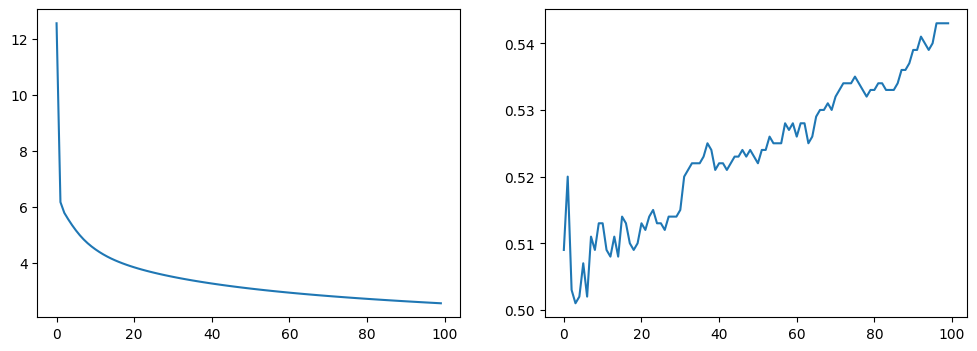

In [56]:
W, b = artificial_neuron(X_train_reshape, y_train, learning_rate = 0.01, n_iterations=1000)

attention, peut-être qu'ici notre model est en train d'entrer en overtheating, il perd peut-être la capacité de faire de bonnes prédictions
il faut donc tracer une courbe de test

In [60]:
def artificial_neuron(X_train, y_train, X_test, y_test, learning_rate=0.1, n_iterations=100) :
    W, b = initialisation(X_train)

    train_loss = []
    train_acc = []

    test_loss = []
    test_acc = []

    # boucle d'apprentissage
    for i in tqdm(range(n_iterations)) :

        # activations
        A = model(X_train, W, b)

        if i%10 == 0 : # améliore la rapidité du code

            # train calcul 
            train_loss.append(log_loss(A, y_train))

            # calcul de l'accuracy
            y_pred = predict(X_train, W, b)
            train_acc.append(accuracy_score(y_train, y_pred))

            A_test = model(X_test, W, b)
            test_loss.append(log_loss(A_test, y_test))
            y_pred = predict(X_test, W, b)
            test_acc.append(accuracy_score(y_test, y_pred))

        dW, db = gradients(A, X_train, y_train)
        W, b = update(W, b, dW, db, learning_rate)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(train_loss, label='train loss')
    plt.plot(test_loss, label='test loss')
    plt.legend()
    plt.subplot(1, 2, 2)
    plt.plot(train_acc, label='train accuracy')
    plt.plot(test_acc, label='test accuracy')
    plt.legend()
    plt.show()

    return (W, b)

  1%|          | 9/1000 [00:00<00:24, 40.77it/s]

[[1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [2.46279076e-07]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.08387562e-01]
 [8.76694366e-01]
 [6.78325785e-01]
 [9.99998581e-01]
 [9.91928790e-01]
 [9.99999982e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999987e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99998760e-01]
 [9.99999977e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.85135281e-01]
 [1.00000000e+00]
 [9.99999944e-01]
 [9.99976783e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999994e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99892460e-01]
 [9.99999986e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999673e-01]
 [1.00000000e+00]
 [9.99999986e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99988946e-01]
 [1.000000

  1%|▏         | 14/1000 [00:00<00:34, 28.64it/s]

[[9.99918194e-01]
 [9.99989343e-01]
 [2.85003334e-02]
 [3.37385787e-15]
 [2.72416057e-01]
 [9.98262414e-01]
 [1.00000000e+00]
 [5.76164982e-07]
 [2.52366889e-09]
 [4.64319894e-09]
 [5.64190148e-03]
 [3.21975706e-11]
 [1.31771340e-02]
 [9.99999990e-01]
 [9.93815632e-01]
 [9.99909312e-01]
 [9.99091028e-01]
 [9.99529402e-01]
 [2.49473958e-02]
 [1.03812749e-02]
 [9.99968587e-01]
 [1.00000000e+00]
 [3.29169658e-06]
 [6.83608831e-05]
 [9.99999794e-01]
 [8.65807174e-01]
 [9.99991890e-01]
 [1.00000000e+00]
 [2.60750660e-01]
 [6.53527919e-06]
 [9.77554933e-01]
 [2.47195055e-03]
 [8.11278551e-06]
 [9.99998400e-01]
 [5.02910949e-03]
 [2.15121942e-02]
 [9.99720472e-01]
 [9.99988018e-01]
 [6.67571581e-04]
 [9.99971111e-01]
 [1.63782644e-02]
 [9.82977642e-01]
 [7.69967030e-08]
 [1.21352531e-01]
 [9.99556591e-01]
 [9.99999886e-01]
 [9.99999388e-01]
 [9.99967750e-01]
 [9.99995303e-01]
 [1.73507842e-01]
 [1.00000000e+00]
 [1.72222747e-05]
 [1.00000000e+00]
 [9.99991238e-01]
 [2.33301513e-05]
 [9.999820

  3%|▎         | 31/1000 [00:01<00:29, 33.27it/s]

[[9.98814255e-01]
 [9.99938486e-01]
 [4.53773871e-03]
 [1.54596152e-15]
 [2.88489768e-02]
 [9.91939446e-01]
 [1.00000000e+00]
 [2.04647883e-07]
 [1.00393441e-09]
 [1.33305838e-09]
 [1.28968117e-03]
 [7.66250076e-12]
 [1.83278700e-03]
 [9.99999910e-01]
 [9.75979990e-01]
 [9.99721113e-01]
 [9.96545111e-01]
 [9.97205766e-01]
 [4.94908284e-03]
 [2.64409929e-03]
 [9.99434651e-01]
 [1.00000000e+00]
 [4.85078054e-07]
 [1.30788333e-05]
 [9.99997661e-01]
 [2.56374230e-01]
 [9.99907325e-01]
 [9.99999994e-01]
 [9.05525934e-02]
 [1.98851310e-06]
 [8.79695025e-01]
 [6.30021972e-04]
 [1.32363348e-06]
 [9.99989536e-01]
 [1.12006557e-03]
 [4.78917317e-03]
 [9.96921521e-01]
 [9.99684401e-01]
 [5.82904097e-05]
 [9.99835673e-01]
 [2.25738314e-03]
 [9.00514566e-01]
 [1.35554712e-08]
 [3.42530952e-02]
 [9.97726236e-01]
 [9.99997925e-01]
 [9.99996982e-01]
 [9.99689339e-01]
 [9.99960440e-01]
 [4.49055869e-02]
 [1.00000000e+00]
 [2.26086472e-06]
 [1.00000000e+00]
 [9.99867162e-01]
 [6.11165552e-06]
 [9.998683

  5%|▌         | 51/1000 [00:01<00:20, 46.61it/s]

[[9.97637458e-01]
 [9.99924389e-01]
 [8.46940205e-03]
 [4.99629276e-15]
 [3.26947179e-02]
 [9.88230176e-01]
 [1.00000000e+00]
 [2.97205848e-07]
 [4.06583559e-09]
 [2.13634274e-09]
 [1.07961553e-03]
 [3.35982203e-11]
 [9.85103705e-04]
 [9.99999925e-01]
 [9.76331376e-01]
 [9.99668309e-01]
 [9.97180547e-01]
 [9.98264118e-01]
 [9.80656069e-03]
 [5.05051430e-03]
 [9.97751671e-01]
 [1.00000000e+00]
 [5.44891123e-07]
 [2.87341990e-05]
 [9.99989923e-01]
 [2.24222476e-01]
 [9.99876108e-01]
 [9.99999969e-01]
 [1.88848774e-01]
 [2.11570993e-06]
 [8.61830910e-01]
 [1.22176787e-03]
 [1.01765595e-06]
 [9.99975118e-01]
 [3.07456036e-03]
 [6.72789012e-03]
 [9.96808993e-01]
 [9.99237615e-01]
 [4.81236917e-05]
 [9.99918774e-01]
 [3.21672605e-03]
 [8.46349434e-01]
 [2.06102015e-08]
 [4.50678845e-02]
 [9.95775868e-01]
 [9.99995342e-01]
 [9.99997219e-01]
 [9.99270291e-01]
 [9.99939166e-01]
 [2.76992998e-02]
 [1.00000000e+00]
 [2.97622077e-06]
 [1.00000000e+00]
 [9.99784383e-01]
 [1.12993680e-05]
 [9.998879

  7%|▋         | 66/1000 [00:01<00:20, 44.78it/s]

[[9.95716407e-01]
 [9.99911085e-01]
 [1.50955910e-02]
 [1.55856660e-14]
 [3.96592710e-02]
 [9.83673849e-01]
 [1.00000000e+00]
 [4.08319304e-07]
 [1.50243322e-08]
 [3.32462854e-09]
 [9.21768399e-04]
 [1.39935875e-10]
 [5.77092340e-04]
 [9.99999937e-01]
 [9.76891953e-01]
 [9.99607743e-01]
 [9.97656006e-01]
 [9.98905378e-01]
 [1.81666159e-02]
 [9.36917368e-03]
 [9.92501326e-01]
 [1.00000000e+00]
 [6.38450396e-07]
 [6.29279657e-05]
 [9.99962711e-01]
 [2.08442195e-01]
 [9.99843798e-01]
 [9.99999856e-01]
 [3.32515214e-01]
 [2.35741938e-06]
 [8.48669290e-01]
 [2.33023738e-03]
 [8.30311903e-07]
 [9.99945740e-01]
 [7.93708960e-03]
 [9.18313796e-03]
 [9.96757552e-01]
 [9.98357530e-01]
 [4.17241188e-05]
 [9.99957498e-01]
 [4.62321741e-03]
 [7.88005987e-01]
 [3.37678401e-08]
 [5.92227460e-02]
 [9.92844493e-01]
 [9.99990299e-01]
 [9.99997402e-01]
 [9.98454366e-01]
 [9.99911539e-01]
 [1.82639393e-02]
 [9.99999999e-01]
 [3.92187346e-06]
 [9.99999999e-01]
 [9.99671881e-01]
 [2.01345449e-05]
 [9.999035

  8%|▊         | 76/1000 [00:02<00:21, 42.00it/s]

[[9.94284262e-01]
 [9.99903424e-01]
 [1.93592071e-02]
 [2.67436205e-14]
 [4.35624642e-02]
 [9.80864982e-01]
 [1.00000000e+00]
 [4.63662607e-07]
 [2.73833292e-08]
 [4.04207462e-09]
 [8.46418328e-04]
 [2.73463325e-10]
 [4.48104085e-04]
 [9.99999940e-01]
 [9.76923508e-01]
 [9.99569975e-01]
 [9.97815485e-01]
 [9.99106692e-01]
 [2.36157936e-02]
 [1.23707846e-02]
 [9.86893433e-01]
 [1.00000000e+00]
 [6.86713958e-07]
 [9.09266302e-05]
 [9.99931008e-01]
 [2.00846435e-01]
 [9.99824112e-01]
 [9.99999703e-01]
 [4.09076763e-01]
 [2.49576753e-06]
 [8.41742779e-01]
 [3.13583169e-03]
 [7.54272383e-07]
 [9.99921249e-01]
 [1.21705883e-02]
 [1.04306610e-02]
 [9.96673004e-01]
 [9.97618392e-01]
 [3.85679485e-05]
 [9.99967857e-01]
 [5.43198713e-03]
 [7.57128390e-01]
 [4.34921696e-08]
 [6.68445816e-02]
 [9.90866351e-01]
 [9.99986026e-01]
 [9.99997431e-01]
 [9.97795798e-01]
 [9.99893330e-01]
 [1.50248216e-02]
 [9.99999999e-01]
 [4.39830304e-06]
 [9.99999999e-01]
 [9.99594441e-01]
 [2.60586273e-05]
 [9.999079

  8%|▊         | 85/1000 [00:02<00:25, 36.04it/s]

[[9.92436055e-01]
 [9.99895160e-01]
 [2.42627739e-02]
 [4.50919857e-14]
 [4.78885857e-02]
 [9.77680178e-01]
 [1.00000000e+00]
 [5.17154230e-07]
 [4.82839260e-08]
 [4.84198229e-09]
 [7.75827673e-04]
 [5.20573409e-10]
 [3.51955538e-04]
 [9.99999942e-01]
 [9.76836894e-01]
 [9.99526970e-01]
 [9.97939527e-01]
 [9.99259732e-01]
 [2.98794183e-02]
 [1.60286487e-02]
 [9.77833422e-01]
 [1.00000000e+00]
 [7.36925878e-07]
 [1.29636857e-04]
 [9.99875824e-01]
 [1.93936709e-01]
 [9.99802091e-01]
 [9.99999409e-01]
 [4.82560580e-01]
 [2.65017857e-06]
 [8.34806984e-01]
 [4.15475549e-03]
 [6.89703460e-07]
 [9.99887251e-01]
 [1.81326180e-02]
 [1.16638425e-02]
 [9.96557244e-01]
 [9.96586011e-01]
 [3.55719070e-05]
 [9.99975036e-01]
 [6.31686494e-03]
 [7.26337277e-01]
 [5.63495003e-08]
 [7.48462349e-02]
 [9.88501870e-01]
 [9.99979961e-01]
 [9.99997427e-01]
 [9.96906559e-01]
 [9.99871665e-01]
 [1.24873066e-02]
 [9.99999997e-01]
 [4.87111678e-06]
 [9.99999998e-01]
 [9.99499670e-01]
 [3.31338775e-05]
 [9.999108

 10%|▉         | 96/1000 [00:02<00:22, 40.03it/s]

[[9.90092636e-01]
 [9.99886363e-01]
 [2.98300707e-02]
 [7.48245975e-14]
 [5.27835270e-02]
 [9.74112431e-01]
 [1.00000000e+00]
 [5.68621845e-07]
 [8.26527185e-08]
 [5.73115945e-09]
 [7.10781266e-04]
 [9.68853727e-10]
 [2.79893808e-04]
 [9.99999943e-01]
 [9.76675651e-01]
 [9.99478768e-01]
 [9.98037761e-01]
 [9.99378907e-01]
 [3.69463116e-02]
 [2.04280182e-02]
 [9.63798828e-01]
 [1.00000000e+00]
 [7.90286694e-07]
 [1.82785324e-04]
 [9.99782564e-01]
 [1.88010278e-01]
 [9.99777927e-01]
 [9.99998860e-01]
 [5.50157332e-01]
 [2.82477518e-06]
 [8.28054431e-01]
 [5.43205648e-03]
 [6.35895049e-07]
 [9.99840915e-01]
 [2.63218782e-02]
 [1.28804011e-02]
 [9.96417269e-01]
 [9.95173893e-01]
 [3.28230615e-05]
 [9.99980163e-01]
 [7.29208118e-03]
 [6.96419664e-01]
 [7.34919352e-08]
 [8.33084226e-02]
 [9.85731152e-01]
 [9.99971462e-01]
 [9.99997398e-01]
 [9.95730795e-01]
 [9.99846218e-01]
 [1.04899360e-02]
 [9.99999995e-01]
 [5.34234168e-06]
 [9.99999997e-01]
 [9.99385427e-01]
 [4.15026477e-05]
 [9.999125

 11%|█         | 110/1000 [00:02<00:18, 47.18it/s]

[[9.87151790e-01]
 [9.99876888e-01]
 [3.60155710e-02]
 [1.22177841e-13]
 [5.82711316e-02]
 [9.70122747e-01]
 [1.00000000e+00]
 [6.17562584e-07]
 [1.37597105e-07]
 [6.71251827e-09]
 [6.50447189e-04]
 [1.76563779e-09]
 [2.25159977e-04]
 [9.99999943e-01]
 [9.76445679e-01]
 [9.99424823e-01]
 [9.98114510e-01]
 [9.99472675e-01]
 [4.47291099e-02]
 [2.56197390e-02]
 [9.42905556e-01]
 [1.00000000e+00]
 [8.46488101e-07]
 [2.54875043e-04]
 [9.99628802e-01]
 [1.82836611e-01]
 [9.99751351e-01]
 [9.99997867e-01]
 [6.10101485e-01]
 [3.02062508e-06]
 [8.21409618e-01]
 [7.01143769e-03]
 [5.90908743e-07]
 [9.99778590e-01]
 [3.72461784e-02]
 [1.40611956e-02]
 [9.96250107e-01]
 [9.93266526e-01]
 [3.03017896e-05]
 [9.99983893e-01]
 [8.35924766e-03]
 [6.67682697e-01]
 [9.63407374e-08]
 [9.22033546e-02]
 [9.82525487e-01]
 [9.99959620e-01]
 [9.99997343e-01]
 [9.94196170e-01]
 [9.99816361e-01]
 [8.89771513e-03]
 [9.99999990e-01]
 [5.80325788e-06]
 [9.99999996e-01]
 [9.99247944e-01]
 [5.12422798e-05]
 [9.999132

 13%|█▎        | 131/1000 [00:03<00:17, 50.63it/s]

[[9.79042923e-01]
 [9.99855256e-01]
 [4.98712852e-02]
 [3.10177336e-13]
 [7.11747367e-02]
 [9.60723427e-01]
 [1.00000000e+00]
 [7.05831448e-07]
 [3.52700683e-07]
 [8.96804686e-09]
 [5.41454649e-04]
 [5.53809762e-09]
 [1.50513039e-04]
 [9.99999942e-01]
 [9.75794999e-01]
 [9.99296962e-01]
 [9.98216210e-01]
 [9.99606722e-01]
 [6.18768670e-02]
 [3.84400725e-02]
 [8.72755841e-01]
 [1.00000000e+00]
 [9.66762936e-07]
 [4.79524899e-04]
 [9.98991848e-01]
 [1.74179778e-01]
 [9.99689982e-01]
 [9.99993108e-01]
 [7.05542546e-01]
 [3.48485347e-06]
 [8.08287774e-01]
 [1.12583518e-02]
 [5.21980872e-07]
 [9.99587439e-01]
 [6.91606946e-02]
 [1.62437159e-02]
 [9.95819596e-01]
 [9.87377308e-01]
 [2.58928085e-05]
 [9.99988724e-01]
 [1.07697345e-02]
 [6.14912903e-01]
 [1.67537018e-07]
 [1.11135582e-01]
 [9.74730810e-01]
 [9.99920704e-01]
 [9.99997155e-01]
 [9.89695026e-01]
 [9.99740569e-01]
 [6.57470543e-03]
 [9.99999965e-01]
 [6.66061906e-06]
 [9.99999993e-01]
 [9.98885002e-01]
 [7.49269786e-05]
 [9.999114

 15%|█▍        | 147/1000 [00:03<00:16, 52.85it/s]

[[9.67496088e-01]
 [9.99829489e-01]
 [6.51394832e-02]
 [7.39409435e-13]
 [8.76258574e-02]
 [9.49389029e-01]
 [9.99999999e-01]
 [7.80685654e-07]
 [8.23287168e-07]
 [1.16886844e-08]
 [4.47463606e-04]
 [1.63052493e-08]
 [1.05423632e-04]
 [9.99999939e-01]
 [9.75008123e-01]
 [9.99139490e-01]
 [9.98270933e-01]
 [9.99695377e-01]
 [8.02379299e-02]
 [5.44355430e-02]
 [7.59737040e-01]
 [1.00000000e+00]
 [1.10379960e-06]
 [8.68259846e-04]
 [9.97511774e-01]
 [1.68497628e-01]
 [9.99618872e-01]
 [9.99979977e-01]
 [7.73012225e-01]
 [4.08387952e-06]
 [7.96214878e-01]
 [1.73257993e-02]
 [4.77652625e-07]
 [9.99273197e-01]
 [1.16835152e-01]
 [1.81773310e-02]
 [9.95264049e-01]
 [9.77698985e-01]
 [2.24368987e-05]
 [9.99991563e-01]
 [1.36189220e-02]
 [5.71473891e-01]
 [2.96696021e-07]
 [1.31830865e-01]
 [9.65251547e-01]
 [9.99849822e-01]
 [9.99996868e-01]
 [9.82673011e-01]
 [9.99640522e-01]
 [5.04575129e-03]
 [9.99999898e-01]
 [7.43543533e-06]
 [9.99999987e-01]
 [9.98380980e-01]
 [1.04176154e-04]
 [9.999057

 15%|█▌        | 153/1000 [00:03<00:17, 49.43it/s]

[[6.18023330e-02]
 [9.99999941e-01]
 [5.03997626e-09]
 [9.91616189e-01]
 [7.07670299e-01]
 [9.92183805e-01]
 [9.99999469e-01]
 [1.54897844e-04]
 [1.53606150e-10]
 [9.52254312e-01]
 [8.71778243e-06]
 [9.99970431e-01]
 [2.65597288e-02]
 [9.99143611e-01]
 [9.19782968e-01]
 [8.33556853e-01]
 [3.85804365e-11]
 [9.92512002e-01]
 [2.62706844e-02]
 [9.99968991e-01]
 [1.17529753e-01]
 [9.99756637e-01]
 [6.98340978e-02]
 [9.99809687e-01]
 [9.99294752e-01]
 [9.68844046e-01]
 [9.94640840e-01]
 [9.99727310e-01]
 [9.99999791e-01]
 [9.98724128e-01]
 [2.70794093e-01]
 [9.99999962e-01]
 [9.83403903e-01]
 [9.99981297e-01]
 [5.31865358e-07]
 [7.76478671e-07]
 [9.99999529e-01]
 [2.73555207e-02]
 [9.98511220e-01]
 [4.08398308e-02]
 [1.00000000e+00]
 [9.83340791e-15]
 [9.33833444e-01]
 [7.41540921e-01]
 [2.42995414e-07]
 [9.99935762e-01]
 [9.98119689e-01]
 [3.16226463e-08]
 [3.01824033e-06]
 [9.54046751e-01]
 [6.45782989e-11]
 [7.90080520e-01]
 [9.99997619e-01]
 [9.93362579e-01]
 [7.98775948e-01]
 [1.130539

 17%|█▋        | 173/1000 [00:04<00:17, 46.25it/s]

[[9.43705930e-01]
 [9.99781236e-01]
 [8.89577355e-02]
 [2.42972741e-12]
 [1.22184387e-01]
 [9.29009260e-01]
 [9.99999999e-01]
 [8.65786656e-07]
 [2.50743356e-06]
 [1.68254818e-08]
 [3.32705056e-04]
 [7.43045135e-08]
 [6.77564600e-05]
 [9.99999929e-01]
 [9.73773121e-01]
 [9.98839402e-01]
 [9.98298343e-01]
 [9.99779961e-01]
 [1.07371341e-01]
 [8.31779087e-02]
 [5.47743770e-01]
 [1.00000000e+00]
 [1.35973547e-06]
 [1.98126084e-03]
 [9.91990228e-01]
 [1.66773956e-01]
 [9.99499790e-01]
 [9.99918687e-01]
 [8.37618153e-01]
 [5.36836108e-06]
 [7.82065544e-01]
 [3.08797857e-02]
 [4.50127345e-07]
 [9.98487683e-01]
 [2.17318634e-01]
 [2.06383110e-02]
 [9.94199729e-01]
 [9.53961085e-01]
 [1.89585084e-05]
 [9.99993980e-01]
 [1.89365111e-02]
 [5.28922811e-01]
 [7.23511813e-07]
 [1.66926924e-01]
 [9.49250707e-01]
 [9.99641827e-01]
 [9.99996241e-01]
 [9.66034235e-01]
 [9.99443341e-01]
 [3.65969117e-03]
 [9.99999597e-01]
 [8.48745016e-06]
 [9.99999971e-01]
 [9.97319048e-01]
 [1.56423656e-04]
 [9.998896

 18%|█▊        | 183/1000 [00:05<00:46, 17.48it/s]

[[9.34199935e-01]
 [9.99761938e-01]
 [9.67000850e-02]
 [3.50949817e-12]
 [1.36870396e-01]
 [9.21372675e-01]
 [9.99999999e-01]
 [8.85876176e-07]
 [3.49412384e-06]
 [1.88144824e-08]
 [3.00794875e-04]
 [1.19738138e-07]
 [5.97953712e-05]
 [9.99999925e-01]
 [9.73341263e-01]
 [9.98719621e-01]
 [9.98295009e-01]
 [9.99799708e-01]
 [1.15628735e-01]
 [9.35687132e-02]
 [4.80502988e-01]
 [1.00000000e+00]
 [1.46022791e-06]
 [2.56051632e-03]
 [9.88719417e-01]
 [1.67772830e-01]
 [9.99457287e-01]
 [9.99876532e-01]
 [8.52277345e-01]
 [5.92921406e-06]
 [7.78476212e-01]
 [3.67771239e-02]
 [4.49344186e-07]
 [9.98127038e-01]
 [2.56379632e-01]
 [2.13286122e-02]
 [9.93774053e-01]
 [9.43291474e-01]
 [1.81376590e-05]
 [9.99994495e-01]
 [2.10089050e-02]
 [5.20653830e-01]
 [9.79193790e-07]
 [1.79642616e-01]
 [9.43809274e-01]
 [9.99532490e-01]
 [9.99995969e-01]
 [9.58629758e-01]
 [9.99364725e-01]
 [3.35074835e-03]
 [9.99999398e-01]
 [8.80655678e-06]
 [9.99999964e-01]
 [9.96873436e-01]
 [1.75143296e-04]
 [9.998819

 19%|█▉        | 191/1000 [00:05<00:42, 19.15it/s]

[[9.23971918e-01]
 [9.99740714e-01]
 [1.04213115e-01]
 [5.00164205e-12]
 [1.53243879e-01]
 [9.13335021e-01]
 [9.99999998e-01]
 [9.01701149e-07]
 [4.78003003e-06]
 [2.09177727e-08]
 [2.71819502e-04]
 [1.90050734e-07]
 [5.32796527e-05]
 [9.99999920e-01]
 [9.72889867e-01]
 [9.98588749e-01]
 [9.98285521e-01]
 [9.99816438e-01]
 [1.23270798e-01]
 [1.04174178e-01]
 [4.19406542e-01]
 [1.00000000e+00]
 [1.56806868e-06]
 [3.27601209e-03]
 [9.84451518e-01]
 [1.69377446e-01]
 [9.99413250e-01]
 [9.99816678e-01]
 [8.64419151e-01]
 [6.56799851e-06]
 [7.75400529e-01]
 [4.34127822e-02]
 [4.52034047e-07]
 [9.97712709e-01]
 [2.96794105e-01]
 [2.19491705e-02]
 [9.93307241e-01]
 [9.31192225e-01]
 [1.74323098e-05]
 [9.99994913e-01]
 [2.32309114e-02]
 [5.14995689e-01]
 [1.32591421e-06]
 [1.92777701e-01]
 [9.38431285e-01]
 [9.99396152e-01]
 [9.99995661e-01]
 [9.50246493e-01]
 [9.99279248e-01]
 [3.09316049e-03]
 [9.99999123e-01]
 [9.10727200e-06]
 [9.99999955e-01]
 [9.96376616e-01]
 [1.94079125e-04]
 [9.998729

 20%|██        | 202/1000 [00:06<00:50, 15.90it/s]

[[9.13056123e-01]
 [9.99717351e-01]
 [1.11467530e-01]
 [7.03881960e-12]
 [1.71311331e-01]
 [9.04909656e-01]
 [9.99999998e-01]
 [9.13493610e-07]
 [6.42537486e-06]
 [2.31125838e-08]
 [2.45627354e-04]
 [2.97003909e-07]
 [4.78860216e-05]
 [9.99999915e-01]
 [9.72414594e-01]
 [9.98446155e-01]
 [9.98269919e-01]
 [9.99830682e-01]
 [1.30226239e-01]
 [1.14901688e-01]
 [3.65444174e-01]
 [1.00000000e+00]
 [1.68282463e-06]
 [4.14763788e-03]
 [9.78996539e-01]
 [1.71487977e-01]
 [9.99367536e-01]
 [9.99733455e-01]
 [8.74484161e-01]
 [7.29163110e-06]
 [7.72801201e-01]
 [5.07988412e-02]
 [4.57895402e-07]
 [9.97243566e-01]
 [3.37650131e-01]
 [2.25011425e-02]
 [9.92795999e-01]
 [9.17679059e-01]
 [1.68176091e-05]
 [9.99995251e-01]
 [2.56012530e-02]
 [5.11693146e-01]
 [1.79397137e-06]
 [2.06282840e-01]
 [9.33165385e-01]
 [9.99227674e-01]
 [9.99995314e-01]
 [9.40887686e-01]
 [9.99186544e-01]
 [2.87651809e-03]
 [9.99998753e-01]
 [9.38926697e-06]
 [9.99999944e-01]
 [9.95825183e-01]
 [2.12991602e-04]
 [9.998624

 22%|██▏       | 218/1000 [00:07<00:42, 18.30it/s]

[[9.01494071e-01]
 [9.99691642e-01]
 [1.18469582e-01]
 [9.78986983e-12]
 [1.91060409e-01]
 [8.96116036e-01]
 [9.99999997e-01]
 [9.21690326e-07]
 [8.49557024e-06]
 [2.53753883e-08]
 [2.22055708e-04]
 [4.56976288e-07]
 [4.33756506e-05]
 [9.99999909e-01]
 [9.71913934e-01]
 [9.98291361e-01]
 [9.98248385e-01]
 [9.99842892e-01]
 [1.36473166e-01]
 [1.25682735e-01]
 [3.18750939e-01]
 [1.00000000e+00]
 [1.80412327e-06]
 [5.19495989e-03]
 [9.72159185e-01]
 [1.74036046e-01]
 [9.99320070e-01]
 [9.99619998e-01]
 [8.82852820e-01]
 [8.10762341e-06]
 [7.70651338e-01]
 [5.89409983e-02]
 [4.66738860e-07]
 [9.96719831e-01]
 [3.78136548e-01]
 [2.29896607e-02]
 [9.92237907e-01]
 [9.02812293e-01]
 [1.62763439e-05]
 [9.99995526e-01]
 [2.81216216e-02]
 [5.10506072e-01]
 [2.42268078e-06]
 [2.20130859e-01]
 [9.28053894e-01]
 [9.99021376e-01]
 [9.99994924e-01]
 [9.30585758e-01]
 [9.99086292e-01]
 [2.69283425e-03]
 [9.99998265e-01]
 [9.65403049e-06]
 [9.99999931e-01]
 [9.95216483e-01]
 [2.31678854e-04]
 [9.998504

 23%|██▎       | 226/1000 [00:07<00:35, 21.97it/s]

[[8.89340735e-01]
 [9.99663385e-01]
 [1.25250967e-01]
 [1.34685636e-11]
 [2.12464703e-01]
 [8.86980909e-01]
 [9.99999997e-01]
 [9.26858178e-07]
 [1.10611929e-05]
 [2.76847656e-08]
 [2.00927021e-04]
 [6.92452929e-07]
 [3.95712978e-05]
 [9.99999902e-01]
 [9.71388668e-01]
 [9.98124045e-01]
 [9.98221213e-01]
 [9.99853444e-01]
 [1.42030930e-01]
 [1.36472491e-01]
 [2.78917996e-01]
 [1.00000000e+00]
 [1.93173235e-06]
 [6.43684470e-03]
 [9.63747931e-01]
 [1.76983032e-01]
 [9.99270875e-01]
 [9.99468163e-01]
 [8.89846721e-01]
 [9.02432827e-06]
 [7.68932125e-01]
 [6.78418606e-02]
 [4.78472265e-07]
 [9.96143198e-01]
 [4.17593990e-01]
 [2.34227886e-02]
 [9.91631453e-01]
 [8.86700923e-01]
 [1.57976778e-05]
 [9.99995751e-01]
 [3.07976726e-02]
 [5.11216191e-01]
 [3.26281438e-06]
 [2.34314235e-01]
 [9.23136006e-01]
 [9.98771152e-01]
 [9.99994488e-01]
 [9.19403685e-01]
 [9.98978253e-01]
 [2.53597978e-03]
 [9.99997633e-01]
 [9.90453158e-06]
 [9.99999916e-01]
 [9.94549062e-01]
 [2.49979902e-04]
 [9.998368

 24%|██▎       | 236/1000 [00:07<00:35, 21.25it/s]

[[8.76661833e-01]
 [9.99632385e-01]
 [1.31853567e-01]
 [1.83437531e-11]
 [2.35473116e-01]
 [8.77535447e-01]
 [9.99999996e-01]
 [9.29597844e-07]
 [1.41975739e-05]
 [3.00220130e-08]
 [1.82048081e-04]
 [1.03386530e-06]
 [3.63388223e-05]
 [9.99999894e-01]
 [9.70840205e-01]
 [9.97943981e-01]
 [9.98188709e-01]
 [9.99862642e-01]
 [1.46943611e-01]
 [1.47242524e-01]
 [2.45244632e-01]
 [1.00000000e+00]
 [2.06549079e-06]
 [7.89079842e-03]
 [9.53584193e-01]
 [1.80304844e-01]
 [9.99220036e-01]
 [9.99268470e-01]
 [8.95728612e-01]
 [1.00507625e-05]
 [7.67623442e-01]
 [7.75004330e-02]
 [4.93068142e-07]
 [9.95516692e-01]
 [4.55520020e-01]
 [2.38094301e-02]
 [9.90975539e-01]
 [8.69494370e-01]
 [1.53745365e-05]
 [9.99995934e-01]
 [3.36377293e-02]
 [5.13619387e-01]
 [4.37940548e-06]
 [2.48832317e-01]
 [9.18446034e-01]
 [9.98470536e-01]
 [9.99994003e-01]
 [9.07431045e-01]
 [9.98862254e-01]
 [2.40115333e-03]
 [9.99996829e-01]
 [1.01442540e-05]
 [9.99999898e-01]
 [9.93822670e-01]
 [2.67764630e-04]
 [9.998215

 24%|██▍       | 240/1000 [00:08<00:31, 24.32it/s]

[[8.63526894e-01]
 [9.99598437e-01]
 [1.38318400e-01]
 [2.47510358e-11]
 [2.59995401e-01]
 [8.67811864e-01]
 [9.99999995e-01]
 [9.30476006e-07]
 [1.79838198e-05]
 [3.23702613e-08]
 [1.65217138e-04]
 [1.52177443e-06]
 [3.35743991e-05]
 [9.99999886e-01]
 [9.70269285e-01]
 [9.97750985e-01]
 [9.98151102e-01]
 [9.99870727e-01]
 [1.51265280e-01]
 [1.57972979e-01]
 [2.16918981e-01]
 [1.00000000e+00]
 [2.20519556e-06]
 [9.57196558e-03]
 [9.41510933e-01]
 [1.83978473e-01]
 [9.99167657e-01]
 [9.99010033e-01]
 [9.00706933e-01]
 [1.11962141e-05]
 [7.66698096e-01]
 [8.79092974e-02]
 [5.10539083e-07]
 [9.94844410e-01]
 [4.91552649e-01]
 [2.41577284e-02]
 [9.90268985e-01]
 [8.51367946e-01]
 [1.50014789e-05]
 [9.99996084e-01]
 [3.66508894e-02]
 [5.17519418e-01]
 [5.85487233e-06]
 [2.63679771e-01]
 [9.14010153e-01]
 [9.98112709e-01]
 [9.99993468e-01]
 [8.94777968e-01]
 [9.98738129e-01]
 [2.28450232e-03]
 [9.99995822e-01]
 [1.03764167e-05]
 [9.99999878e-01]
 [9.93038041e-01]
 [2.84922506e-04]
 [9.998044

 25%|██▌       | 254/1000 [00:09<00:48, 15.44it/s]

[[8.50004527e-01]
 [9.99561330e-01]
 [1.44682235e-01]
 [3.31063709e-11]
 [2.85895549e-01]
 [8.57842238e-01]
 [9.99999994e-01]
 [9.30000223e-07]
 [2.25014936e-05]
 [3.47134976e-08]
 [1.50234766e-04]
 [2.20938453e-06]
 [3.11965686e-05]
 [9.99999877e-01]
 [9.69675680e-01]
 [9.97544902e-01]
 [9.98108529e-01]
 [9.99877887e-01]
 [1.55052252e-01]
 [1.68648593e-01]
 [1.93135904e-01]
 [1.00000000e+00]
 [2.35054017e-06]
 [1.14920430e-02]
 [9.27401491e-01]
 [1.87977832e-01]
 [9.99113837e-01]
 [9.98680515e-01]
 [9.04944812e-01]
 [1.24699126e-05]
 [7.66123143e-01]
 [9.90522530e-02]
 [5.30931828e-07]
 [9.94131300e-01]
 [5.25451868e-01]
 [2.44745722e-02]
 [9.89510390e-01]
 [8.32510739e-01]
 [1.46737607e-05]
 [9.99996208e-01]
 [3.98460587e-02]
 [5.22729171e-01]
 [7.79252273e-06]
 [2.78842323e-01]
 [9.09844920e-01]
 [9.97690526e-01]
 [9.99992877e-01]
 [8.81570346e-01]
 [9.98605694e-01]
 [2.18290008e-03]
 [9.99994581e-01]
 [1.06037432e-05]
 [9.99999855e-01]
 [9.92196766e-01]
 [3.01358432e-04]
 [9.997854

 27%|██▋       | 268/1000 [00:09<00:26, 27.64it/s]

[[8.36161761e-01]
 [9.99520846e-01]
 [1.50979038e-01]
 [4.39221246e-11]
 [3.12995278e-01]
 [8.47659311e-01]
 [9.99999993e-01]
 [9.28619904e-07]
 [2.78332602e-05]
 [3.70362010e-08]
 [1.36912246e-04]
 [3.16537741e-06]
 [2.91411229e-05]
 [9.99999866e-01]
 [9.69058615e-01]
 [9.97325619e-01]
 [9.98061047e-01]
 [9.99884271e-01]
 [1.58360826e-01]
 [1.79258069e-01]
 [1.73162572e-01]
 [1.00000000e+00]
 [2.50112004e-06]
 [1.36583828e-02]
 [9.11169216e-01]
 [1.92276290e-01]
 [9.99058672e-01]
 [9.98266142e-01]
 [9.08570245e-01]
 [1.38808726e-05]
 [7.65864758e-01]
 [1.10903681e-01]
 [5.54333577e-07]
 [9.93383043e-01]
 [5.57083268e-01]
 [2.47658258e-02]
 [9.88698316e-01]
 [8.13118948e-01]
 [1.43872225e-05]
 [9.99996308e-01]
 [4.32320888e-02]
 [5.29075743e-01]
 [1.03205454e-05]
 [2.94298355e-01]
 [9.05958189e-01]
 [9.97196595e-01]
 [9.99992229e-01]
 [8.67946721e-01]
 [9.98464749e-01]
 [2.09381391e-03]
 [9.99993069e-01]
 [1.08286009e-05]
 [9.99999829e-01]
 [9.91301357e-01]
 [3.16994642e-04]
 [9.997644

 27%|██▋       | 273/1000 [00:09<00:28, 25.57it/s]

[[8.22065519e-01]
 [9.99476773e-01]
 [1.57242192e-01]
 [5.78258309e-11]
 [3.41083400e-01]
 [8.37297624e-01]
 [9.99999992e-01]
 [9.26733641e-07]
 [3.40616276e-05]
 [3.93235083e-08]
 [1.25075289e-04]
 [4.47704879e-06]
 [2.73573105e-05]
 [9.99999855e-01]
 [9.68417314e-01]
 [9.97093105e-01]
 [9.98008673e-01]
 [9.99890003e-01]
 [1.61246964e-01]
 [1.89794391e-01]
 [1.56365101e-01]
 [1.00000000e+00]
 [2.65646998e-06]
 [1.60733942e-02]
 [8.92777233e-01]
 [1.96850418e-01]
 [9.99002271e-01]
 [9.97751775e-01]
 [9.11684869e-01]
 [1.54378649e-05]
 [7.65892221e-01]
 [1.23429246e-01]
 [5.80879966e-07]
 [9.92606006e-01]
 [5.86400931e-01]
 [2.50366958e-02]
 [9.87831550e-01]
 [7.93392315e-01]
 [1.41384134e-05]
 [9.99996390e-01]
 [4.68183784e-02]
 [5.36404072e-01]
 [1.35965559e-05]
 [3.10022322e-01]
 [9.02351262e-01]
 [9.96623403e-01]
 [9.99991519e-01]
 [8.54055333e-01]
 [9.98315100e-01]
 [2.01520570e-03]
 [9.99991249e-01]
 [1.10531975e-05]
 [9.99999800e-01]
 [9.90355386e-01]
 [3.31773468e-04]
 [9.997412

 28%|██▊       | 285/1000 [00:10<00:26, 26.70it/s]

[[8.07783623e-01]
 [9.99428902e-01]
 [1.63505325e-01]
 [7.55817143e-11]
 [3.69926104e-01]
 [8.26793717e-01]
 [9.99999991e-01]
 [9.24693225e-07]
 [4.12677233e-05]
 [4.15615251e-08]
 [1.14564305e-04]
 [6.25369777e-06]
 [2.58047065e-05]
 [9.99999843e-01]
 [9.67751338e-01]
 [9.96847423e-01]
 [9.97951398e-01]
 [9.99895180e-01]
 [1.63765624e-01]
 [2.00254333e-01]
 [1.42210883e-01]
 [1.00000000e+00]
 [2.81609711e-06]
 [1.87341982e-02]
 [8.72246563e-01]
 [2.01681617e-01]
 [9.98944762e-01]
 [9.97121058e-01]
 [9.14370439e-01]
 [1.71494186e-05]
 [7.66179164e-01]
 [1.36586984e-01]
 [6.10758477e-07]
 [9.91807165e-01]
 [6.13428198e-01]
 [2.52919173e-02]
 [9.86909257e-01]
 [7.73530286e-01]
 [1.39246169e-05]
 [9.99996456e-01]
 [5.06152834e-02]
 [5.44576914e-01]
 [1.78126852e-05]
 [3.25987211e-01]
 [8.99021028e-01]
 [9.95963480e-01]
 [9.99990745e-01]
 [8.40049921e-01]
 [9.98156580e-01]
 [1.94543939e-03]
 [9.99989085e-01]
 [1.12796621e-05]
 [9.99999768e-01]
 [9.89363572e-01]
 [3.45657350e-04]
 [9.997158

 30%|██▉       | 299/1000 [00:10<00:20, 33.58it/s]

[[7.93383852e-01]
 [9.99377028e-01]
 [1.69801412e-01]
 [9.81147943e-11]
 [3.99275430e-01]
 [8.16185049e-01]
 [9.99999989e-01]
 [9.22803060e-07]
 [4.95299334e-05]
 [4.37374784e-08]
 [1.05233202e-04]
 [8.63016948e-06]
 [2.44506102e-05]
 [9.99999830e-01]
 [9.67060613e-01]
 [9.96588737e-01]
 [9.97889190e-01]
 [9.99899887e-01]
 [1.65969177e-01]
 [2.10636705e-01]
 [1.30258741e-01]
 [1.00000000e+00]
 [2.97948996e-06]
 [2.16324180e-02]
 [8.49660608e-01]
 [2.06754972e-01]
 [9.98886287e-01]
 [9.96356611e-01]
 [9.16693259e-01]
 [1.90237770e-05]
 [7.66702413e-01]
 [1.50328034e-01]
 [6.44205875e-07]
 [9.90993965e-01]
 [6.38237686e-01]
 [2.55357119e-02]
 [9.85930953e-01]
 [7.53726071e-01]
 [1.37437106e-05]
 [9.99996507e-01]
 [5.46340047e-02]
 [5.53471711e-01]
 [2.32010994e-05]
 [3.42165154e-01]
 [8.95961401e-01]
 [9.95209543e-01]
 [9.99989902e-01]
 [8.26083940e-01]
 [9.97989056e-01]
 [1.88319315e-03]
 [9.99986537e-01]
 [1.15099854e-05]
 [9.99999732e-01]
 [9.88331700e-01]
 [3.58625240e-04]
 [9.996881

 30%|███       | 304/1000 [00:10<00:24, 28.52it/s]

[[7.78931043e-01]
 [9.99320941e-01]
 [1.76160688e-01]
 [1.26537169e-10]
 [4.28875558e-01]
 [8.05507946e-01]
 [9.99999988e-01]
 [9.21316996e-07]
 [5.89222113e-05]
 [4.58396059e-08]
 [9.69480533e-05]
 [1.17703818e-05]
 [2.32679839e-05]
 [9.99999816e-01]
 [9.66345241e-01]
 [9.96317289e-01]
 [9.97821989e-01]
 [9.99904189e-01]
 [1.67905223e-01]
 [2.20939716e-01]
 [1.20144943e-01]
 [1.00000000e+00]
 [3.14610215e-06]
 [2.47540064e-02]
 [8.25164530e-01]
 [2.12056203e-01]
 [9.98826982e-01]
 [9.95440242e-01]
 [9.18707132e-01]
 [2.10687696e-05]
 [7.67439621e-01]
 [1.64596742e-01]
 [6.81500993e-07]
 [9.90174107e-01]
 [6.60932934e-01]
 [2.57716015e-02]
 [9.84896306e-01]
 [7.34158802e-01]
 [1.35939222e-05]
 [9.99996547e-01]
 [5.88859125e-02]
 [5.62976106e-01]
 [3.00397514e-05]
 [3.58526476e-01]
 [8.93163996e-01]
 [9.94354578e-01]
 [9.99988989e-01]
 [8.12303757e-01]
 [9.97812416e-01]
 [1.82738131e-03]
 [9.99983568e-01]
 [1.17458705e-05]
 [9.99999693e-01]
 [9.87266358e-01]
 [3.70666421e-04]
 [9.996579

 31%|███       | 311/1000 [00:10<00:23, 29.11it/s]

[[7.64483154e-01]
 [9.99260413e-01]
 [1.82608057e-01]
 [1.62175874e-10]
 [4.58468046e-01]
 [7.94795212e-01]
 [9.99999986e-01]
 [9.20434965e-07]
 [6.95119342e-05]
 [4.78568599e-08]
 [8.95861194e-05]
 [1.58706011e-05]
 [2.22339277e-05]
 [9.99999800e-01]
 [9.65605193e-01]
 [9.96033364e-01]
 [9.97749688e-01]
 [9.99908139e-01]
 [1.69614392e-01]
 [2.31158112e-01]
 [1.11569397e-01]
 [1.00000000e+00]
 [3.31532087e-06]
 [2.80790956e-02]
 [7.98959229e-01]
 [2.17568052e-01]
 [9.98766956e-01]
 [9.94353147e-01]
 [9.20455397e-01]
 [2.32916156e-05]
 [7.68366886e-01]
 [1.79330264e-01]
 [7.22955146e-07]
 [9.89355267e-01]
 [6.81633563e-01]
 [2.60021853e-02]
 [9.83804807e-01]
 [7.14985276e-01]
 [1.34735735e-05]
 [9.99996576e-01]
 [6.33814628e-02]
 [5.72983820e-01]
 [3.86581161e-05]
 [3.75037899e-01]
 [8.90618302e-01]
 [9.93391856e-01]
 [9.99988000e-01]
 [7.98841867e-01]
 [9.97626538e-01]
 [1.77709144e-03]
 [9.99980139e-01]
 [1.19885603e-05]
 [9.99999649e-01]
 [9.86174529e-01]
 [3.81773443e-04]
 [9.996252

 32%|███▎      | 325/1000 [00:11<00:20, 32.54it/s]

[[7.50087620e-01]
 [9.99195182e-01]
 [1.89160658e-01]
 [2.06601619e-10]
 [4.87797562e-01]
 [7.84074053e-01]
 [9.99999984e-01]
 [9.20301298e-07]
 [8.13573359e-05]
 [4.97786085e-08]
 [8.30353051e-05]
 [2.11622007e-05]
 [2.13286359e-05]
 [9.99999784e-01]
 [9.64840014e-01]
 [9.95737243e-01]
 [9.97672119e-01]
 [9.99911779e-01]
 [1.71128710e-01]
 [2.41280764e-01]
 [1.04283818e-01]
 [1.00000000e+00]
 [3.48643624e-06]
 [3.15819587e-02]
 [7.71290859e-01]
 [2.23267360e-01]
 [9.98706265e-01]
 [9.93076075e-01]
 [9.21972489e-01]
 [2.56987117e-05]
 [7.69457194e-01]
 [1.94458146e-01]
 [7.68902676e-07]
 [9.88544811e-01]
 [7.00464765e-01]
 [2.62289765e-02]
 [9.82655411e-01]
 [6.96333200e-01]
 [1.33808884e-05]
 [9.99996595e-01]
 [6.81289670e-02]
 [5.83392105e-01]
 [4.94427054e-05]
 [3.91660776e-01]
 [8.88311737e-01]
 [9.92314847e-01]
 [9.99986933e-01]
 [7.85811243e-01]
 [9.97431259e-01]
 [1.73153889e-03]
 [9.99976213e-01]
 [1.22387006e-05]
 [9.99999602e-01]
 [9.85063116e-01]
 [3.91935864e-04]
 [9.995897

 33%|███▎      | 334/1000 [00:11<00:24, 26.81it/s]

[[7.35779260e-01]
 [9.99124941e-01]
 [1.95826182e-01]
 [2.61657796e-10]
 [5.16619206e-01]
 [7.73364871e-01]
 [9.99999982e-01]
 [9.21006105e-07]
 [9.45047541e-05]
 [5.15945224e-08]
 [7.71939082e-05]
 [2.79136821e-05]
 [2.05347439e-05]
 [9.99999766e-01]
 [9.64048642e-01]
 [9.95429164e-01]
 [9.97589041e-01]
 [9.99915141e-01]
 [1.72470937e-01]
 [2.51289303e-01]
 [9.80823368e-02]
 [1.00000000e+00]
 [3.65862765e-06]
 [3.52312500e-02]
 [7.42437762e-01]
 [2.29123753e-01]
 [9.98644899e-01]
 [9.91589449e-01]
 [9.23285346e-01]
 [2.82954857e-05]
 [7.70680125e-01]
 [2.09902449e-01]
 [8.19693957e-07]
 [9.87749541e-01]
 [7.17551043e-01]
 [2.64523666e-02]
 [9.81446215e-01]
 [6.78297601e-01]
 [1.33139106e-05]
 [9.99996605e-01]
 [7.31335209e-02]
 [5.94101289e-01]
 [6.28423097e-05]
 [4.08350124e-01]
 [8.86229909e-01]
 [9.91117092e-01]
 [9.99985783e-01]
 [7.73301746e-01]
 [9.97226346e-01]
 [1.69003847e-03]
 [9.99971752e-01]
 [1.24962801e-05]
 [9.99999551e-01]
 [9.83938503e-01]
 [4.01136237e-04]
 [9.995513

 34%|███▍      | 344/1000 [00:12<00:28, 22.80it/s]

[[7.21580401e-01]
 [9.99049320e-01]
 [2.02602436e-01]
 [3.29489593e-10]
 [5.44707437e-01]
 [7.62681247e-01]
 [9.99999980e-01]
 [9.22590619e-07]
 [1.08986129e-04]
 [5.32947592e-08]
 [7.19705355e-05]
 [3.64318647e-05]
 [1.98369614e-05]
 [9.99999746e-01]
 [9.63229389e-01]
 [9.95109279e-01]
 [9.97500149e-01]
 [9.99918247e-01]
 [1.73655133e-01]
 [2.61158208e-01]
 [9.27942517e-02]
 [1.00000000e+00]
 [3.83097787e-06]
 [3.89906938e-02]
 [7.12696964e-01]
 [2.35100375e-01]
 [9.98582777e-01]
 [9.89873474e-01]
 [9.24414849e-01]
 [3.10863911e-05]
 [7.72002847e-01]
 [2.25578971e-01]
 [8.75692764e-07]
 [9.86975524e-01]
 [7.33013412e-01]
 [2.66717528e-02]
 [9.80174277e-01]
 [6.60941236e-01]
 [1.32705387e-05]
 [9.99996607e-01]
 [7.83963832e-02]
 [6.05016260e-01]
 [7.93731522e-05]
 [4.25055017e-01]
 [8.84357243e-01]
 [9.89792046e-01]
 [9.99984544e-01]
 [7.61379125e-01]
 [9.97011485e-01]
 [1.65199011e-03]
 [9.99966720e-01]
 [1.27606722e-05]
 [9.99999495e-01]
 [9.82806247e-01]
 [4.09349294e-04]
 [9.995097

 36%|███▌      | 358/1000 [00:12<00:21, 30.49it/s]

[[7.07503210e-01]
 [9.98967884e-01]
 [2.09478434e-01]
 [4.12573735e-10]
 [5.71865449e-01]
 [7.52031095e-01]
 [9.99999977e-01]
 [9.25056480e-07]
 [1.24817277e-04]
 [5.48704277e-08]
 [6.72840541e-05]
 [4.70623282e-05]
 [1.92218865e-05]
 [9.99999725e-01]
 [9.62380098e-01]
 [9.94777652e-01]
 [9.97405081e-01]
 [9.99921117e-01]
 [1.74688397e-01]
 [2.70856427e-01]
 [8.82784401e-02]
 [1.00000000e+00]
 [4.00251652e-06]
 [4.28202948e-02]
 [6.82371907e-01]
 [2.41156482e-01]
 [9.98519758e-01]
 [9.87908256e-01]
 [9.25377332e-01]
 [3.40750773e-05]
 [7.73392109e-01]
 [2.41399746e-01]
 [9.37278873e-07]
 [9.86228035e-01]
 [7.46968946e-01]
 [2.68858209e-02]
 [9.78835609e-01]
 [6.44298799e-01]
 [1.32486559e-05]
 [9.99996601e-01]
 [8.39149858e-02]
 [6.16049132e-01]
 [9.96243490e-05]
 [4.41720475e-01]
 [8.82677919e-01]
 [9.88332985e-01]
 [9.99983210e-01]
 [7.50086649e-01]
 [9.96786287e-01]
 [1.61687407e-03]
 [9.99961078e-01]
 [1.30307775e-05]
 [9.99999435e-01]
 [9.81670985e-01]
 [4.16544513e-04]
 [9.994648

 36%|███▌      | 362/1000 [00:12<00:23, 27.38it/s]

[[6.93553421e-01]
 [9.98880132e-01]
 [2.16436870e-01]
 [5.13750054e-10]
 [5.97933093e-01]
 [7.41418651e-01]
 [9.99999975e-01]
 [9.28377891e-07]
 [1.41997348e-04]
 [5.63141884e-08]
 [6.30634422e-05]
 [6.01893285e-05]
 [1.86779030e-05]
 [9.99999702e-01]
 [9.61498430e-01]
 [9.94434258e-01]
 [9.97303446e-01]
 [9.99923765e-01]
 [1.75573401e-01]
 [2.80350237e-01]
 [8.44188427e-02]
 [1.00000000e+00]
 [4.17228309e-06]
 [4.66779852e-02]
 [6.51762130e-01]
 [2.47251151e-01]
 [9.98455661e-01]
 [9.85674000e-01]
 [9.26186085e-01]
 [3.72647070e-05]
 [7.74816633e-01]
 [2.57276586e-01]
 [1.00485539e-06]
 [9.85511593e-01]
 [7.59531399e-01]
 [2.70929261e-02]
 [9.77425363e-01]
 [6.28383651e-01]
 [1.32463008e-05]
 [9.99996586e-01]
 [8.96835747e-02]
 [6.27122063e-01]
 [1.24264135e-04]
 [4.58290476e-01]
 [8.81176891e-01]
 [9.86733010e-01]
 [9.99981775e-01]
 [7.39448767e-01]
 [9.96550324e-01]
 [1.58424982e-03]
 [9.99954789e-01]
 [1.33052385e-05]
 [9.99999370e-01]
 [9.80536533e-01]
 [4.22691343e-04]
 [9.994162

 38%|███▊      | 378/1000 [00:13<00:17, 36.07it/s]

[[6.79734318e-01]
 [9.98785502e-01]
 [2.23457442e-01]
 [6.36256451e-10]
 [6.22791547e-01]
 [7.30846726e-01]
 [9.99999972e-01]
 [9.32514605e-07]
 [1.60509614e-04]
 [5.76207956e-08]
 [5.92474205e-05]
 [7.62354395e-05]
 [1.81950839e-05]
 [9.99999677e-01]
 [9.60582174e-01]
 [9.94079023e-01]
 [9.97194845e-01]
 [9.99926206e-01]
 [1.76311130e-01]
 [2.89606636e-01]
 [8.11205822e-02]
 [1.00000000e+00]
 [4.33939312e-06]
 [5.05214710e-02]
 [6.21154778e-01]
 [2.53347036e-01]
 [9.98390290e-01]
 [9.83151283e-01]
 [9.26852684e-01]
 [4.06583389e-05]
 [7.76249267e-01]
 [2.73124992e-01]
 [1.07885906e-06]
 [9.84830071e-01]
 [7.70811869e-01]
 [2.72914865e-02]
 [9.75938139e-01]
 [6.13195257e-01]
 [1.32618234e-05]
 [9.99996564e-01]
 [9.56942886e-02]
 [6.38169250e-01]
 [1.54047167e-04]
 [4.74711329e-01]
 [8.79840714e-01]
 [9.84985161e-01]
 [9.99980231e-01]
 [7.29475800e-01]
 [9.96303162e-01]
 [1.55375417e-03]
 [9.99947816e-01]
 [1.35826768e-05]
 [9.99999300e-01]
 [9.79406131e-01]
 [4.27765606e-04]
 [9.993635

 38%|███▊      | 383/1000 [00:13<00:18, 34.25it/s]

[[6.66049887e-01]
 [9.98683378e-01]
 [2.30520250e-01]
 [7.83768776e-10]
 [6.46363856e-01]
 [7.20318660e-01]
 [9.99999969e-01]
 [9.37423621e-07]
 [1.80323380e-04]
 [5.87874186e-08]
 [5.57838035e-05]
 [9.56610860e-05]
 [1.77650578e-05]
 [9.99999651e-01]
 [9.59629517e-01]
 [9.93711857e-01]
 [9.97078899e-01]
 [9.99928453e-01]
 [1.76903254e-01]
 [2.98596513e-01]
 [7.83064552e-02]
 [1.00000000e+00]
 [4.50309102e-06]
 [5.43099835e-02]
 [5.90817448e-01]
 [2.59413252e-01]
 [9.98323463e-01]
 [9.80321430e-01]
 [9.27387999e-01]
 [4.42592755e-05]
 [7.77668386e-01]
 [2.88867687e-01]
 [1.15977110e-06]
 [9.84186813e-01]
 [7.80918891e-01]
 [2.74803042e-02]
 [9.74368355e-01]
 [5.98725669e-01]
 [1.32939830e-05]
 [9.99996534e-01]
 [1.01938377e-01]
 [6.49137532e-01]
 [1.89822919e-04]
 [4.90934602e-01]
 [8.78657967e-01]
 [9.83082628e-01]
 [9.99978568e-01]
 [7.20168609e-01]
 [9.96044410e-01]
 [1.52509555e-03]
 [9.99940123e-01]
 [1.38619005e-05]
 [9.99999226e-01]
 [9.78282747e-01]
 [4.31755381e-04]
 [9.993065

 41%|████      | 409/1000 [00:13<00:13, 44.52it/s]

[[6.39113756e-01]
 [9.98453970e-01]
 [2.44710935e-01]
 [1.17098664e-09]
 [6.89529410e-01]
 [6.99417074e-01]
 [9.99999963e-01]
 [9.49422633e-07]
 [2.23679065e-04]
 [6.07014498e-08]
 [4.97449168e-05]
 [1.46678535e-04]
 [1.70365712e-05]
 [9.99999591e-01]
 [9.57610654e-01]
 [9.92941554e-01]
 [9.96823617e-01]
 [9.99932422e-01]
 [1.77669584e-01]
 [3.15692631e-01]
 [7.38912602e-02]
 [1.00000000e+00]
 [4.81802498e-06]
 [6.15746900e-02]
 [5.31889849e-01]
 [2.71372940e-01]
 [9.98184854e-01]
 [9.73671820e-01]
 [9.28108217e-01]
 [5.20987743e-05]
 [7.80409365e-01]
 [3.19777037e-01]
 [1.34452280e-06]
 [9.83026364e-01]
 [7.98029957e-01]
 [2.78269137e-02]
 [9.70959739e-01]
 [5.71899221e-01]
 [1.34053765e-05]
 [9.99996452e-01]
 [1.15093395e-01]
 [6.70682292e-01]
 [2.83280298e-04]
 [5.22631448e-01]
 [8.76716831e-01]
 [9.78788496e-01]
 [9.99974856e-01]
 [7.03529447e-01]
 [9.95490935e-01]
 [1.47242152e-03]
 [9.99922440e-01]
 [1.44226599e-05]
 [9.99999060e-01]
 [9.76068959e-01]
 [4.36517218e-04]
 [9.991775

 42%|████▏     | 415/1000 [00:14<00:16, 35.08it/s]

[[6.25882937e-01]
 [9.98325256e-01]
 [2.51821475e-01]
 [1.42068099e-09]
 [7.09137201e-01]
 [6.89060771e-01]
 [9.99999960e-01]
 [9.56476107e-07]
 [2.47114853e-04]
 [6.14544796e-08]
 [4.71018841e-05]
 [1.79374724e-04]
 [1.67274101e-05]
 [9.99999557e-01]
 [9.56543812e-01]
 [9.92538501e-01]
 [9.96683712e-01]
 [9.99934174e-01]
 [1.77860898e-01]
 [3.23775700e-01]
 [7.21970743e-02]
 [1.00000000e+00]
 [4.96854239e-06]
 [6.49874787e-02]
 [5.03687725e-01]
 [2.77243731e-01]
 [9.98112874e-01]
 [9.69822115e-01]
 [9.28315463e-01]
 [5.63465999e-05]
 [7.81716231e-01]
 [3.34842244e-01]
 [1.44962161e-06]
 [9.82513864e-01]
 [8.05231066e-01]
 [2.79854060e-02]
 [9.69111356e-01]
 [5.59520204e-01]
 [1.34841038e-05]
 [9.99996401e-01]
 [1.21990492e-01]
 [6.81204226e-01]
 [3.43219503e-04]
 [5.38046260e-01]
 [8.75944099e-01]
 [9.76386181e-01]
 [9.99972788e-01]
 [6.96180397e-01]
 [9.95195837e-01]
 [1.44808448e-03]
 [9.99912385e-01]
 [1.47036738e-05]
 [9.99998969e-01]
 [9.74984946e-01]
 [4.37351838e-04]
 [9.991047

 43%|████▎     | 428/1000 [00:14<00:13, 41.95it/s]

[[6.12826778e-01]
 [9.98186198e-01]
 [2.58940277e-01]
 [1.71548561e-09]
 [7.27474003e-01]
 [6.78782093e-01]
 [9.99999956e-01]
 [9.64231236e-07]
 [2.71645400e-04]
 [6.20779900e-08]
 [4.46735335e-05]
 [2.17657029e-04]
 [1.64492356e-05]
 [9.99999521e-01]
 [9.55439189e-01]
 [9.92123716e-01]
 [9.96535321e-01]
 [9.99935789e-01]
 [1.77940381e-01]
 [3.31545486e-01]
 [7.07963210e-02]
 [1.00000000e+00]
 [5.11417043e-06]
 [6.82191721e-02]
 [4.76526523e-01]
 [2.83037061e-01]
 [9.98039039e-01]
 [9.65606024e-01]
 [9.28436039e-01]
 [6.08201018e-05]
 [7.82977621e-01]
 [3.49598444e-01]
 [1.56415489e-06]
 [9.82048989e-01]
 [8.11650709e-01]
 [2.81354126e-02]
 [9.67161526e-01]
 [5.47816133e-01]
 [1.35782913e-05]
 [9.99996342e-01]
 [1.29093812e-01]
 [6.91533756e-01]
 [4.13685376e-04]
 [5.53144870e-01]
 [8.75295030e-01]
 [9.73808092e-01]
 [9.99970567e-01]
 [6.89465008e-01]
 [9.94888397e-01]
 [1.42491736e-03]
 [9.99901479e-01]
 [1.49853871e-05]
 [9.99998873e-01]
 [9.73920774e-01]
 [4.37224354e-04]
 [9.990257

 44%|████▍     | 439/1000 [00:14<00:13, 40.78it/s]

[[5.99957788e-01]
 [9.98036003e-01]
 [2.66072402e-01]
 [2.06209372e-09]
 [7.44591512e-01]
 [6.68593357e-01]
 [9.99999952e-01]
 [9.72703246e-07]
 [2.97211487e-04]
 [6.25782717e-08]
 [4.24378672e-05]
 [2.62162754e-04]
 [1.61985377e-05]
 [9.99999482e-01]
 [9.54297693e-01]
 [9.91697465e-01]
 [9.96378252e-01]
 [9.99937283e-01]
 [1.77922605e-01]
 [3.39007213e-01]
 [6.96597133e-02]
 [1.00000000e+00]
 [5.25484168e-06]
 [7.12493983e-02]
 [4.50511080e-01]
 [2.88754742e-01]
 [9.97963334e-01]
 [9.61014171e-01]
 [9.28481384e-01]
 [6.55248579e-05]
 [7.84194748e-01]
 [3.64020858e-01]
 [1.68892530e-06]
 [9.81633050e-01]
 [8.17371399e-01]
 [2.82784730e-02]
 [9.65106953e-01]
 [5.36775417e-01]
 [1.36882273e-05]
 [9.99996277e-01]
 [1.36399940e-01]
 [7.01657052e-01]
 [4.96141873e-04]
 [5.67914293e-01]
 [8.74763717e-01]
 [9.71051311e-01]
 [9.99968184e-01]
 [6.83372059e-01]
 [9.94568628e-01]
 [1.40282127e-03]
 [9.99889694e-01]
 [1.52683829e-05]
 [9.99998770e-01]
 [9.72880036e-01]
 [4.36202241e-04]
 [9.989402

 44%|████▍     | 444/1000 [00:14<00:15, 36.68it/s]

[[5.87287319e-01]
 [9.97873844e-01]
 [2.73226798e-01]
 [2.46801711e-09]
 [7.60549269e-01]
 [6.58507027e-01]
 [9.99999948e-01]
 [9.81917438e-07]
 [3.23755062e-04]
 [6.29623466e-08]
 [4.03760489e-05]
 [3.13560150e-04]
 [1.59722821e-05]
 [9.99999440e-01]
 [9.53120528e-01]
 [9.91260092e-01]
 [9.96212342e-01]
 [9.99938668e-01]
 [1.77823195e-01]
 [3.46170685e-01]
 [6.87623260e-02]
 [1.00000000e+00]
 [5.39055492e-06]
 [7.40620782e-02]
 [4.25712119e-01]
 [2.94401037e-01]
 [9.97885765e-01]
 [9.56039669e-01]
 [9.28462701e-01]
 [7.04665256e-05]
 [7.85370411e-01]
 [3.78092883e-01]
 [1.82480818e-06]
 [9.81266879e-01]
 [8.22468297e-01]
 [2.84163499e-02]
 [9.62944899e-01]
 [5.26384981e-01]
 [1.38142854e-05]
 [9.99996205e-01]
 [1.43906547e-01]
 [7.11562743e-01]
 [5.92202084e-04]
 [5.82345890e-01]
 [8.74344055e-01]
 [9.68113989e-01]
 [9.99965631e-01]
 [6.77889072e-01]
 [9.94236598e-01]
 [1.38170804e-03]
 [9.99877000e-01]
 [1.55534503e-05]
 [9.99998661e-01]
 [9.71866326e-01]
 [4.34361329e-04]
 [9.988475

 46%|████▌     | 456/1000 [00:15<00:13, 39.14it/s]

[[2.40967225e-01]
 [9.99995254e-01]
 [1.52252302e-09]
 [9.83241217e-01]
 [3.81235786e-01]
 [9.99183961e-01]
 [9.95404048e-01]
 [2.78791812e-03]
 [3.81263091e-08]
 [9.93122182e-01]
 [2.55895988e-03]
 [9.98890240e-01]
 [2.53747193e-02]
 [9.95674258e-01]
 [8.15578705e-01]
 [5.10878772e-01]
 [6.24203858e-11]
 [8.80648943e-01]
 [1.38014626e-01]
 [9.99997710e-01]
 [7.10487752e-01]
 [9.74512899e-01]
 [3.55511468e-01]
 [9.99102672e-01]
 [9.73170362e-01]
 [9.66330946e-01]
 [1.52432954e-01]
 [9.99981906e-01]
 [9.99999814e-01]
 [9.87651841e-01]
 [3.06570684e-01]
 [9.99982222e-01]
 [5.12671459e-01]
 [9.99934626e-01]
 [5.39222365e-06]
 [3.59622186e-06]
 [9.99991351e-01]
 [1.82569029e-02]
 [9.93634105e-01]
 [1.48862606e-01]
 [1.00000000e+00]
 [4.67001250e-11]
 [2.87965645e-01]
 [7.12136267e-01]
 [2.41608212e-07]
 [9.81871099e-01]
 [9.03422093e-01]
 [3.92222143e-09]
 [4.90762472e-04]
 [9.89930877e-01]
 [6.96188440e-10]
 [9.54608078e-01]
 [9.99945190e-01]
 [9.96645550e-01]
 [8.45185674e-01]
 [6.088036

 47%|████▋     | 466/1000 [00:15<00:16, 33.27it/s]

[[5.62577765e-01]
 [9.97510144e-01]
 [2.87649938e-01]
 [3.49248527e-09]
 [7.89241773e-01]
 [6.38688266e-01]
 [9.99999940e-01]
 [1.00270806e-06]
 [3.79555958e-04]
 [6.34120699e-08]
 [3.67106717e-05]
 [4.39844782e-04]
 [1.55828148e-05]
 [9.99999346e-01]
 [9.50664897e-01]
 [9.90353670e-01]
 [9.95853441e-01]
 [9.99941161e-01]
 [1.77442698e-01]
 [3.59656893e-01]
 [6.76022386e-02]
 [1.00000000e+00]
 [5.64729900e-06]
 [7.89901256e-02]
 [3.79896451e-01]
 [3.05501611e-01]
 [9.97725115e-01]
 [9.44927475e-01]
 [9.28275737e-01]
 [8.10827182e-05]
 [7.87611854e-01]
 [4.05151722e-01]
 [2.13378911e-06]
 [9.80684607e-01]
 [8.31054724e-01]
 [2.86839478e-02]
 [9.58289736e-01]
 [5.07492188e-01]
 [1.41164392e-05]
 [9.99996046e-01]
 [1.59515325e-01]
 [7.30683078e-01]
 [8.32375624e-04]
 [6.10175839e-01]
 [8.73813436e-01]
 [9.61695396e-01]
 [9.99959978e-01]
 [6.68694663e-01]
 [9.93536198e-01]
 [1.34210850e-03]
 [9.99848771e-01]
 [1.61335391e-05]
 [9.99998426e-01]
 [9.69933693e-01]
 [4.28546622e-04]
 [9.986391

 47%|████▋     | 474/1000 [00:15<00:19, 27.29it/s]

[[5.50551026e-01]
 [9.97306756e-01]
 [2.94944675e-01]
 [4.13097335e-09]
 [8.02106563e-01]
 [6.28976174e-01]
 [9.99999936e-01]
 [1.01436222e-06]
 [4.08713225e-04]
 [6.34932985e-08]
 [3.50801088e-05]
 [5.16203322e-04]
 [1.54152113e-05]
 [9.99999295e-01]
 [9.49389488e-01]
 [9.89885563e-01]
 [9.95660196e-01]
 [9.99942291e-01]
 [1.77191797e-01]
 [3.66010516e-01]
 [6.73046463e-02]
 [1.00000000e+00]
 [5.76847625e-06]
 [8.10919865e-02]
 [3.58884052e-01]
 [3.10967025e-01]
 [9.97642086e-01]
 [9.38787996e-01]
 [9.28127098e-01]
 [8.67677150e-05]
 [7.88684952e-01]
 [4.18133833e-01]
 [2.30902279e-06]
 [9.80467617e-01]
 [8.34658804e-01]
 [2.88172342e-02]
 [9.55793255e-01]
 [4.98952679e-01]
 [1.42933902e-05]
 [9.99995958e-01]
 [1.67615303e-01]
 [7.39881022e-01]
 [9.80524862e-04]
 [6.23568969e-01]
 [8.73688428e-01]
 [9.58215280e-01]
 [9.99956860e-01]
 [6.64949140e-01]
 [9.93168088e-01]
 [1.32347159e-03]
 [9.99833173e-01]
 [1.64305345e-05]
 [9.99998299e-01]
 [9.69021007e-01]
 [4.24735384e-04]
 [9.985223

 49%|████▊     | 487/1000 [00:16<00:14, 34.71it/s]

[[5.38747590e-01]
 [9.97087699e-01]
 [3.02311638e-01]
 [4.86887331e-09]
 [8.14068660e-01]
 [6.19406615e-01]
 [9.99999931e-01]
 [1.02690997e-06]
 [4.38648862e-04]
 [6.34892024e-08]
 [3.35687171e-05]
 [6.02391214e-04]
 [1.52631881e-05]
 [9.99999240e-01]
 [9.48084397e-01]
 [9.89408183e-01]
 [9.95457594e-01]
 [9.99943355e-01]
 [1.76918792e-01]
 [3.72125806e-01]
 [6.71756665e-02]
 [1.00000000e+00]
 [5.88496819e-06]
 [8.29486200e-02]
 [3.39105944e-01]
 [3.16382317e-01]
 [9.97557290e-01]
 [9.32261971e-01]
 [9.27953512e-01]
 [9.27104227e-05]
 [7.89730579e-01]
 [4.30753955e-01]
 [2.49964796e-06]
 [9.80298660e-01]
 [8.37869100e-01]
 [2.89523289e-02]
 [9.53182403e-01]
 [4.90989387e-01]
 [1.44881573e-05]
 [9.99995866e-01]
 [1.75910791e-01]
 [7.48827728e-01]
 [1.15036194e-03]
 [6.36612549e-01]
 [8.73647141e-01]
 [9.54556730e-01]
 [9.99953537e-01]
 [6.61745221e-01]
 [9.92788215e-01]
 [1.30551535e-03]
 [9.99816543e-01]
 [1.67334571e-05]
 [9.99998165e-01]
 [9.68147684e-01]
 [4.20425666e-04]
 [9.983964

 50%|████▉     | 497/1000 [00:16<00:14, 35.89it/s]

[[5.27168545e-01]
 [9.96851929e-01]
 [3.09761864e-01]
 [5.71924680e-09]
 [8.25189104e-01]
 [6.09985777e-01]
 [9.99999926e-01]
 [1.04039175e-06]
 [4.69323963e-04]
 [6.34074782e-08]
 [3.21662756e-05]
 [6.99196743e-04]
 [1.51251404e-05]
 [9.99999182e-01]
 [9.46751107e-01]
 [9.88922021e-01]
 [9.95245513e-01]
 [9.99944361e-01]
 [1.76635717e-01]
 [3.78018311e-01]
 [6.72027720e-02]
 [1.00000000e+00]
 [5.99686019e-06]
 [8.45606063e-02]
 [3.20522570e-01]
 [3.21751235e-01]
 [9.97470745e-01]
 [9.25353571e-01]
 [9.27762812e-01]
 [9.89152144e-05]
 [7.90751250e-01]
 [4.43017435e-01]
 [2.70694800e-06]
 [9.80176151e-01]
 [8.40727618e-01]
 [2.90906123e-02]
 [9.50456113e-01]
 [4.83578817e-01]
 [1.47011636e-05]
 [9.99995769e-01]
 [1.84400197e-01]
 [7.57516995e-01]
 [1.34434663e-03]
 [6.49306115e-01]
 [8.73682074e-01]
 [9.50722180e-01]
 [9.99950000e-01]
 [6.59060835e-01]
 [9.92396706e-01]
 [1.28817342e-03]
 [9.99798845e-01]
 [1.70432141e-05]
 [9.99998025e-01]
 [9.67315958e-01]
 [4.15689859e-04]
 [9.982608

 51%|█████     | 507/1000 [00:16<00:13, 35.31it/s]

[[5.15813462e-01]
 [9.96598346e-01]
 [3.17304559e-01]
 [6.69660498e-09]
 [8.35526186e-01]
 [6.00718238e-01]
 [9.99999921e-01]
 [1.05484654e-06]
 [5.00704221e-04]
 [6.32556186e-08]
 [3.08635352e-05]
 [8.07424415e-04]
 [1.49996576e-05]
 [9.99999120e-01]
 [9.45391015e-01]
 [9.88427549e-01]
 [9.95023829e-01]
 [9.99945317e-01]
 [1.76353110e-01]
 [3.83702724e-01]
 [6.73749642e-02]
 [1.00000000e+00]
 [6.10423627e-06]
 [8.59308721e-02]
 [3.03084991e-01]
 [3.27076571e-01]
 [9.97382465e-01]
 [9.18068638e-01]
 [9.27561983e-01]
 [1.05386079e-04]
 [7.91748873e-01]
 [4.54931337e-01]
 [2.93230227e-06]
 [9.80098145e-01]
 [8.43271276e-01]
 [2.92332595e-02]
 [9.47613472e-01]
 [4.76696227e-01]
 [1.49328368e-05]
 [9.99995667e-01]
 [1.93081369e-01]
 [7.65943660e-01]
 [1.56512489e-03]
 [6.61649575e-01]
 [8.73785781e-01]
 [9.46714609e-01]
 [9.99946239e-01]
 [6.56872260e-01]
 [9.91993674e-01]
 [1.27138368e-03]
 [9.99780040e-01]
 [1.73606423e-05]
 [9.99997878e-01]
 [9.66527661e-01]
 [4.10594611e-04]
 [9.981151

 51%|█████     | 512/1000 [00:17<00:19, 24.78it/s]

[[5.04680730e-01]
 [9.96325792e-01]
 [3.24946837e-01]
 [7.81703869e-09]
 [8.45135191e-01]
 [5.91607090e-01]
 [9.99999917e-01]
 [1.07031138e-06]
 [5.32759801e-04]
 [6.30408414e-08]
 [2.96521008e-05]
 [9.27891970e-04]
 [1.48855052e-05]
 [9.99999054e-01]
 [9.44005422e-01]
 [9.87925215e-01]
 [9.94792411e-01]
 [9.99946227e-01]
 [1.76080022e-01]
 [3.89192672e-01]
 [6.76826020e-02]
 [1.00000000e+00]
 [6.20717852e-06]
 [8.70643731e-02]
 [2.86738111e-01]
 [3.32360187e-01]
 [9.97292456e-01]
 [9.10414493e-01]
 [9.27357179e-01]
 [1.12126621e-04]
 [7.92724776e-01]
 [4.66503912e-01]
 [3.17719255e-06]
 [9.80062400e-01]
 [8.45532470e-01]
 [2.93812399e-02]
 [9.44653684e-01]
 [4.70316094e-01]
 [1.51836160e-05]
 [9.99995562e-01]
 [2.01951457e-01]
 [7.74103725e-01]
 [1.81553321e-03]
 [6.73643143e-01]
 [8.73950986e-01]
 [9.42537446e-01]
 [9.99942245e-01]
 [6.55154467e-01]
 [9.91579220e-01]
 [1.25508858e-03]
 [9.99760086e-01]
 [1.76865017e-05]
 [9.99997724e-01]
 [9.65784226e-01]
 [4.05200398e-04]
 [9.979585

 52%|█████▏    | 523/1000 [00:17<00:17, 26.75it/s]

[[4.93767851e-01]
 [9.96033049e-01]
 [3.32693630e-01]
 [9.09835669e-09]
 [8.54068279e-01]
 [5.82654117e-01]
 [9.99999911e-01]
 [1.08682109e-06]
 [5.65465116e-04]
 [6.27700282e-08]
 [2.85243401e-05]
 [1.06142706e-03]
 [1.47816078e-05]
 [9.99998984e-01]
 [9.42595518e-01]
 [9.87415431e-01]
 [9.94551121e-01]
 [9.99947096e-01]
 [1.75824083e-01]
 [3.94500624e-01]
 [6.81172558e-02]
 [1.00000000e+00]
 [6.30576725e-06]
 [8.79677851e-02]
 [2.71423302e-01]
 [3.37603111e-01]
 [9.97200717e-01]
 [9.02399769e-01]
 [9.27153754e-01]
 [1.19140068e-04]
 [7.93679770e-01]
 [4.77744188e-01]
 [3.44321012e-06]
 [9.80066450e-01]
 [8.47539611e-01]
 [2.95353295e-02]
 [9.41576050e-01]
 [4.64412560e-01]
 [1.54539582e-05]
 [9.99995453e-01]
 [2.11006819e-01]
 [7.81994448e-01]
 [2.09860212e-03]
 [6.85287337e-01]
 [8.74170687e-01]
 [9.38194480e-01]
 [9.99938009e-01]
 [6.53881509e-01]
 [9.91153429e-01]
 [1.23923545e-03]
 [9.99738940e-01]
 [1.80214760e-05]
 [9.99997564e-01]
 [9.65086703e-01]
 [3.99561445e-04]
 [9.977905

 54%|█████▎    | 535/1000 [00:17<00:14, 32.54it/s]

[[4.83071707e-01]
 [9.95718836e-01]
 [3.40547720e-01]
 [1.05602324e-08]
 [8.62374455e-01]
 [5.73859988e-01]
 [9.99999906e-01]
 [1.10440831e-06]
 [5.98798551e-04]
 [6.24496727e-08]
 [2.74733097e-05]
 [1.20886348e-03]
 [1.46870321e-05]
 [9.99998910e-01]
 [9.41162380e-01]
 [9.86898572e-01]
 [9.94299814e-01]
 [9.99947930e-01]
 [1.75591618e-01]
 [3.99637901e-01]
 [6.86715803e-02]
 [1.00000000e+00]
 [6.40008149e-06]
 [8.86492063e-02]
 [2.57080469e-01]
 [3.42805642e-01]
 [9.97107239e-01]
 [8.94034257e-01]
 [9.26956315e-01]
 [1.26429272e-04]
 [7.94614226e-01]
 [4.88661647e-01]
 [3.73206336e-06]
 [9.80107665e-01]
 [8.49317618e-01]
 [2.96961272e-02]
 [9.38379952e-01]
 [4.58959822e-01]
 [1.57443430e-05]
 [9.99995340e-01]
 [2.20242955e-01]
 [7.89614398e-01]
 [2.41755871e-03]
 [6.96583030e-01]
 [8.74438218e-01]
 [9.33689778e-01]
 [9.99933522e-01]
 [6.53026916e-01]
 [9.90716371e-01]
 [1.22377662e-03]
 [9.99716553e-01]
 [1.83661776e-05]
 [9.99997396e-01]
 [9.64435781e-01]
 [3.93725913e-04]
 [9.976104

 56%|█████▌    | 561/1000 [00:18<00:10, 43.80it/s]

[[4.62315219e-01]
 [9.95020547e-01]
 [3.56579003e-01]
 [1.41146167e-08]
 [8.77286544e-01]
 [5.56746602e-01]
 [9.99999895e-01]
 [1.14293603e-06]
 [6.67281206e-04]
 [6.16841389e-08]
 [2.55767529e-05]
 [1.54877952e-03]
 [1.45227278e-05]
 [9.99998751e-01]
 [9.38230121e-01]
 [9.85844951e-01]
 [9.93766526e-01]
 [9.99949503e-01]
 [1.75216719e-01]
 [4.09440390e-01]
 [7.01146123e-02]
 [1.00000000e+00]
 [6.57619882e-06]
 [8.93839110e-02]
 [2.31072012e-01]
 [3.53087747e-01]
 [9.96914999e-01]
 [8.76295093e-01]
 [9.26594428e-01]
 [1.41844485e-04]
 [7.96421354e-01]
 [5.09566890e-01]
 [4.38574504e-06]
 [9.80290630e-01]
 [8.52271076e-01]
 [3.00394909e-02]
 [9.31630276e-01]
 [4.49305763e-01]
 [1.63872996e-05]
 [9.99995105e-01]
 [2.39235050e-01]
 [8.04042799e-01]
 [3.17703167e-03]
 [7.18134534e-01]
 [8.75092075e-01]
 [9.24212451e-01]
 [9.99923753e-01]
 [6.52466600e-01]
 [9.89808686e-01]
 [1.19387584e-03]
 [9.99667850e-01]
 [1.90869050e-05]
 [9.99997038e-01]
 [9.63274868e-01]
 [3.81629693e-04]
 [9.972113

 57%|█████▋    | 572/1000 [00:18<00:10, 39.93it/s]

[[4.42380612e-01]
 [9.94219340e-01]
 [3.73026102e-01]
 [1.86810156e-08]
 [8.90202523e-01]
 [5.40257522e-01]
 [9.99999884e-01]
 [1.18612071e-06]
 [7.38101415e-04]
 [6.07871809e-08]
 [2.39185117e-05]
 [1.95425106e-03]
 [1.43873802e-05]
 [9.99998574e-01]
 [9.35214974e-01]
 [9.84766636e-01]
 [9.93191234e-01]
 [9.99950969e-01]
 [1.74985188e-01]
 [4.18670998e-01]
 [7.19705826e-02]
 [1.00000000e+00]
 [6.73615131e-06]
 [8.93515372e-02]
 [2.08252328e-01]
 [3.63198467e-01]
 [9.96715552e-01]
 [8.57294268e-01]
 [9.26295667e-01]
 [1.58387414e-04]
 [7.98143557e-01]
 [5.29296593e-01]
 [5.15456716e-06]
 [9.80589202e-01]
 [8.54538112e-01]
 [3.04134230e-02]
 [9.24401295e-01]
 [4.41159794e-01]
 [1.71169165e-05]
 [9.99994857e-01]
 [2.58873662e-01]
 [8.17402916e-01]
 [4.12370205e-03]
 [7.38314023e-01]
 [8.75867269e-01]
 [9.14141351e-01]
 [9.99912856e-01]
 [6.53264892e-01]
 [9.88856528e-01]
 [1.16510048e-03]
 [9.99613533e-01]
 [1.98524935e-05]
 [9.99996648e-01]
 [9.62300947e-01]
 [3.69191483e-04]
 [9.967554

 59%|█████▊    | 587/1000 [00:18<00:09, 45.18it/s]

[[3.46161978e-01]
 [9.99993157e-01]
 [1.89215774e-09]
 [9.78859244e-01]
 [4.38615078e-01]
 [9.99399289e-01]
 [9.81905390e-01]
 [8.30275859e-03]
 [1.32718827e-07]
 [9.92982489e-01]
 [9.67865827e-03]
 [9.96387799e-01]
 [2.26729359e-02]
 [9.94381336e-01]
 [6.52712776e-01]
 [4.03905354e-01]
 [8.29172006e-11]
 [8.32007127e-01]
 [1.95398093e-01]
 [9.99998502e-01]
 [7.91697946e-01]
 [9.60413615e-01]
 [3.87326888e-01]
 [9.99228684e-01]
 [9.47715847e-01]
 [9.80844051e-01]
 [4.39435801e-02]
 [9.99993283e-01]
 [9.99999867e-01]
 [9.80284663e-01]
 [3.17272143e-01]
 [9.99943858e-01]
 [5.36474771e-01]
 [9.99938099e-01]
 [1.32418766e-05]
 [6.74219396e-06]
 [9.99987921e-01]
 [2.34900775e-02]
 [9.93843008e-01]
 [2.77978770e-01]
 [1.00000000e+00]
 [3.40833668e-10]
 [1.89534722e-01]
 [7.31952298e-01]
 [1.83959386e-07]
 [9.65131945e-01]
 [8.33066518e-01]
 [6.43156362e-09]
 [4.79220107e-04]
 [9.95036116e-01]
 [1.38249314e-09]
 [9.78292104e-01]
 [9.99923176e-01]
 [9.97290773e-01]
 [7.72075818e-01]
 [5.363725

 59%|█████▉    | 592/1000 [00:19<00:10, 38.36it/s]

[[4.23236346e-01]
 [9.93302516e-01]
 [3.89852362e-01]
 [2.45010202e-08]
 [9.01408359e-01]
 [5.24377094e-01]
 [9.99999872e-01]
 [1.23417233e-06]
 [8.11193954e-04]
 [5.97941362e-08]
 [2.24623986e-05]
 [2.43163299e-03]
 [1.42771251e-05]
 [9.99998378e-01]
 [9.32121598e-01]
 [9.83665431e-01]
 [9.92572527e-01]
 [9.99952344e-01]
 [1.74915021e-01]
 [4.27388775e-01]
 [7.42095349e-02]
 [1.00000000e+00]
 [6.88055411e-06]
 [8.86421916e-02]
 [1.88200618e-01]
 [3.73124519e-01]
 [9.96508641e-01]
 [8.37141641e-01]
 [9.26076104e-01]
 [1.76066456e-04]
 [7.99776080e-01]
 [5.47924395e-01]
 [6.05730509e-06]
 [9.80981904e-01]
 [8.56231852e-01]
 [3.08185657e-02]
 [9.16691166e-01]
 [4.34343826e-01]
 [1.79381586e-05]
 [9.99994597e-01]
 [2.79090617e-01]
 [8.29726362e-01]
 [5.29034360e-03]
 [7.57146992e-01]
 [8.76724973e-01]
 [9.03513673e-01]
 [9.99900749e-01]
 [6.55224856e-01]
 [9.87860168e-01]
 [1.13723173e-03]
 [9.99553109e-01]
 [2.06662205e-05]
 [9.99996225e-01]
 [9.61509735e-01]
 [3.56623323e-04]
 [9.962362

 60%|██████    | 601/1000 [00:19<00:12, 32.19it/s]

[[4.13950979e-01]
 [9.92796470e-01]
 [3.98391950e-01]
 [2.79693178e-08]
 [9.06448095e-01]
 [5.16659501e-01]
 [9.99999866e-01]
 [1.26008733e-06]
 [8.48580428e-04]
 [5.92706073e-08]
 [2.18006258e-05]
 [2.69914545e-03]
 [1.42304812e-05]
 [9.99998273e-01]
 [9.30546632e-01]
 [9.83106710e-01]
 [9.92246434e-01]
 [9.99953001e-01]
 [1.74943797e-01]
 [4.31571449e-01]
 [7.54657485e-02]
 [1.00000000e+00]
 [6.94711422e-06]
 [8.80623550e-02]
 [1.79094342e-01]
 [3.78013266e-01]
 [9.96402294e-01]
 [8.26670767e-01]
 [9.25999290e-01]
 [1.85332557e-04]
 [8.00557025e-01]
 [5.56846674e-01]
 [6.56551093e-06]
 [9.81207248e-01]
 [8.56892325e-01]
 [3.10327858e-02]
 [9.12655613e-01]
 [4.31384079e-01]
 [1.83848438e-05]
 [9.99994463e-01]
 [2.89391119e-01]
 [8.35513106e-01]
 [5.96715705e-03]
 [7.66069141e-01]
 [8.77174267e-01]
 [8.98002895e-01]
 [9.99894214e-01]
 [6.56583521e-01]
 [9.87345488e-01]
 [1.12358444e-03]
 [9.99520440e-01]
 [2.10920900e-05]
 [9.99996000e-01]
 [9.61180529e-01]
 [3.50342041e-04]
 [9.959509

 61%|██████    | 611/1000 [00:19<00:16, 23.24it/s]

[[4.04851887e-01]
 [9.92256246e-01]
 [4.07006126e-01]
 [3.18633318e-08]
 [9.11149381e-01]
 [5.09087259e-01]
 [9.99999860e-01]
 [1.28729635e-06]
 [8.86523510e-04]
 [5.87330371e-08]
 [2.11786715e-05]
 [2.98677301e-03]
 [1.41891001e-05]
 [9.99998163e-01]
 [9.28953220e-01]
 [9.82542791e-01]
 [9.91908931e-01]
 [9.99953640e-01]
 [1.75016210e-01]
 [4.35644441e-01]
 [7.68103919e-02]
 [1.00000000e+00]
 [7.01001308e-06]
 [8.73475440e-02]
 [1.70544133e-01]
 [3.82849583e-01]
 [9.96293967e-01]
 [8.15958033e-01]
 [9.25945555e-01]
 [1.94882256e-04]
 [8.01313543e-01]
 [5.65518645e-01]
 [7.11551816e-06]
 [9.81448801e-01]
 [8.57441334e-01]
 [3.12546693e-02]
 [9.08499987e-01]
 [4.28698676e-01]
 [1.88565537e-05]
 [9.99994327e-01]
 [2.99804951e-01]
 [8.41058574e-01]
 [6.71247364e-03]
 [7.74668575e-01]
 [8.77632262e-01]
 [8.92367124e-01]
 [9.99887343e-01]
 [6.58166677e-01]
 [9.86819853e-01]
 [1.11010620e-03]
 [9.99486041e-01]
 [2.15311325e-05]
 [9.99995766e-01]
 [9.60894196e-01]
 [3.44084703e-04]
 [9.956472

 62%|██████▏   | 622/1000 [00:20<00:14, 25.34it/s]

[[3.95935573e-01]
 [9.91679938e-01]
 [4.15687043e-01]
 [3.62276483e-08]
 [9.15537320e-01]
 [5.01658119e-01]
 [9.99999853e-01]
 [1.31582600e-06]
 [9.25021825e-04]
 [5.81839225e-08]
 [2.05936395e-05]
 [3.29511856e-03]
 [1.41527388e-05]
 [9.99998048e-01]
 [9.27341587e-01]
 [9.81973824e-01]
 [9.91559832e-01]
 [9.99954261e-01]
 [1.75132740e-01]
 [4.39613207e-01]
 [7.82419186e-02]
 [1.00000000e+00]
 [7.06932416e-06]
 [8.65088375e-02]
 [1.62510991e-01]
 [3.87631219e-01]
 [9.96183618e-01]
 [8.05020025e-01]
 [9.25915400e-01]
 [2.04714226e-04]
 [8.02045011e-01]
 [5.73947921e-01]
 [7.71051915e-06]
 [9.81704393e-01]
 [8.57887232e-01]
 [3.14841109e-02]
 [9.04224683e-01]
 [4.26270781e-01]
 [1.93540716e-05]
 [9.99994188e-01]
 [3.10320334e-01]
 [8.46369920e-01]
 [7.53108458e-03]
 [7.82951108e-01]
 [8.78095637e-01]
 [8.86611071e-01]
 [9.99880127e-01]
 [6.59954901e-01]
 [9.86283302e-01]
 [1.09678335e-03]
 [9.99449836e-01]
 [2.19837322e-05]
 [9.99995523e-01]
 [9.60649564e-01]
 [3.37865104e-04]
 [9.953243

 64%|██████▎   | 636/1000 [00:20<00:10, 33.35it/s]

[[3.87198692e-01]
 [9.91065573e-01]
 [4.24426545e-01]
 [4.11106933e-08]
 [9.19635079e-01]
 [4.94369905e-01]
 [9.99999847e-01]
 [1.34570366e-06]
 [9.64074722e-04]
 [5.76254241e-08]
 [2.00429027e-05]
 [3.62471442e-03]
 [1.41211892e-05]
 [9.99997927e-01]
 [9.25711903e-01]
 [9.81399948e-01]
 [9.91198950e-01]
 [9.99954865e-01]
 [1.75293684e-01]
 [4.43482940e-01]
 [7.97591300e-02]
 [1.00000000e+00]
 [7.12511991e-06]
 [8.55570195e-02]
 [1.54958755e-01]
 [3.92355913e-01]
 [9.96071206e-01]
 [7.93873829e-01]
 [9.25909103e-01]
 [2.14826509e-04]
 [8.02750856e-01]
 [5.82141748e-01]
 [8.35393031e-06]
 [9.81971997e-01]
 [8.58237531e-01]
 [3.17209905e-02]
 [8.99830273e-01]
 [4.24084740e-01]
 [1.98782204e-05]
 [9.99994046e-01]
 [3.20924980e-01]
 [8.51454657e-01]
 [8.42788305e-03]
 [7.90923049e-01]
 [8.78561347e-01]
 [8.80739425e-01]
 [9.99872554e-01]
 [6.61929989e-01]
 [9.85735880e-01]
 [1.08360433e-03]
 [9.99411750e-01]
 [2.24502843e-05]
 [9.99995269e-01]
 [9.60445383e-01]
 [3.31695162e-04]
 [9.949812

 64%|██████▍   | 641/1000 [00:20<00:12, 28.49it/s]

[[3.78638061e-01]
 [9.90411114e-01]
 [4.33216244e-01]
 [4.65649766e-08]
 [9.23464023e-01]
 [4.87220519e-01]
 [9.99999840e-01]
 [1.37695761e-06]
 [1.00368208e-03]
 [5.70594060e-08]
 [1.95240752e-05]
 [3.97601207e-03]
 [1.40942743e-05]
 [9.99997801e-01]
 [9.24064290e-01]
 [9.80821299e-01]
 [9.90826104e-01]
 [9.99955454e-01]
 [1.75499194e-01]
 [4.47258587e-01]
 [8.13611375e-02]
 [1.00000000e+00]
 [7.17747188e-06]
 [8.45025357e-02]
 [1.47853951e-01]
 [3.97021420e-01]
 [9.95956688e-01]
 [7.82536967e-01]
 [9.25926756e-01]
 [2.25216491e-04]
 [8.03430558e-01]
 [5.90107032e-01]
 [9.04940649e-06]
 [9.82249726e-01]
 [8.58499013e-01]
 [3.19651771e-02]
 [8.95317520e-01]
 [4.22126025e-01]
 [2.04298640e-05]
 [9.99993902e-01]
 [3.31606185e-01]
 [8.56320539e-01]
 [9.40783913e-03]
 [7.98591148e-01]
 [8.79026595e-01]
 [8.74756836e-01]
 [9.99864614e-01]
 [6.64074903e-01]
 [9.85177637e-01]
 [1.07055940e-03]
 [9.99371707e-01]
 [2.29311978e-05]
 [9.99995006e-01]
 [9.60280345e-01]
 [3.25585166e-04]
 [9.946171

 65%|██████▌   | 654/1000 [00:21<00:12, 27.24it/s]

[[3.70250655e-01]
 [9.89714455e-01]
 [4.42047576e-01]
 [5.26473398e-08]
 [9.27043858e-01]
 [4.80207942e-01]
 [9.99999833e-01]
 [1.40961703e-06]
 [1.04384415e-03]
 [5.64874759e-08]
 [1.90349867e-05]
 [4.34937220e-03]
 [1.40718451e-05]
 [9.99997669e-01]
 [9.22398836e-01]
 [9.80238002e-01]
 [9.90441114e-01]
 [9.99956027e-01]
 [1.75749307e-01]
 [4.50944852e-01]
 [8.30473279e-02]
 [1.00000000e+00]
 [7.22645093e-06]
 [8.33554656e-02]
 [1.41165619e-01]
 [4.01625541e-01]
 [9.95840023e-01]
 [7.71027317e-01]
 [9.25968279e-01]
 [2.35880890e-04]
 [8.04083647e-01]
 [5.97850362e-01]
 [9.80085605e-06]
 [9.82535829e-01]
 [8.58677823e-01]
 [3.22165307e-02]
 [8.90687382e-01]
 [4.20381170e-01]
 [2.10099098e-05]
 [9.99993756e-01]
 [3.42350922e-01]
 [8.60975469e-01]
 [1.04759727e-02]
 [8.05962538e-01]
 [8.79488819e-01]
 [8.68667897e-01]
 [9.99856295e-01]
 [6.66373693e-01]
 [9.84608635e-01]
 [1.05764041e-03]
 [9.99329625e-01]
 [2.34268975e-05]
 [9.99994732e-01]
 [9.60153092e-01]
 [3.19543973e-04]
 [9.942308

 66%|██████▌   | 661/1000 [00:21<00:11, 28.44it/s]

[[3.62033602e-01]
 [9.88973435e-01]
 [4.50911825e-01]
 [5.94192102e-08]
 [9.30392761e-01]
 [4.73330217e-01]
 [9.99999827e-01]
 [1.44371198e-06]
 [1.08456142e-03]
 [5.59110242e-08]
 [1.85736587e-05]
 [4.74505565e-03]
 [1.40537775e-05]
 [9.99997532e-01]
 [9.20715598e-01]
 [9.79650181e-01]
 [9.90043806e-01]
 [9.99956586e-01]
 [1.76043959e-01]
 [4.54546187e-01]
 [8.48173325e-02]
 [1.00000000e+00]
 [7.27212757e-06]
 [8.21255071e-02]
 [1.34865148e-01]
 [4.06166153e-01]
 [9.95721168e-01]
 [7.59363024e-01]
 [9.26033448e-01]
 [2.46815753e-04]
 [8.04709710e-01]
 [6.05378042e-01]
 [1.06124564e-05]
 [9.82828690e-01]
 [8.58779552e-01]
 [3.24749026e-02]
 [8.85941020e-01]
 [4.18837699e-01]
 [2.16193110e-05]
 [9.99993607e-01]
 [3.53145936e-01]
 [8.65427402e-01]
 [1.16373246e-02]
 [8.13044673e-01]
 [8.79945674e-01]
 [8.62477122e-01]
 [9.99847587e-01]
 [6.68811410e-01]
 [9.84028939e-01]
 [1.04484058e-03]
 [9.99285423e-01]
 [2.39378235e-05]
 [9.99994447e-01]
 [9.60062228e-01]
 [3.13579176e-04]
 [9.938216

 68%|██████▊   | 678/1000 [00:21<00:07, 40.51it/s]

[[4.25703686e-01]
 [9.99992386e-01]
 [2.19105616e-09]
 [9.77215696e-01]
 [5.01986796e-01]
 [9.99473551e-01]
 [9.65162632e-01]
 [1.64778818e-02]
 [2.62718025e-07]
 [9.92231953e-01]
 [1.97128621e-02]
 [9.92750622e-01]
 [2.11378935e-02]
 [9.93772993e-01]
 [5.32772363e-01]
 [3.46618349e-01]
 [1.05265228e-10]
 [8.14620582e-01]
 [2.42801421e-01]
 [9.99998798e-01]
 [8.22517951e-01]
 [9.56505928e-01]
 [3.86360643e-01]
 [9.99350204e-01]
 [9.26688545e-01]
 [9.85921199e-01]
 [2.04334313e-02]
 [9.99996413e-01]
 [9.99999888e-01]
 [9.75798813e-01]
 [3.26718986e-01]
 [9.99899321e-01]
 [5.89211948e-01]
 [9.99942482e-01]
 [2.18936109e-05]
 [1.05938135e-05]
 [9.99986432e-01]
 [2.86663041e-02]
 [9.93980003e-01]
 [3.73968604e-01]
 [1.00000000e+00]
 [1.07664943e-09]
 [1.56908647e-01]
 [7.44657111e-01]
 [1.54785750e-07]
 [9.57216189e-01]
 [7.97059273e-01]
 [1.04341715e-08]
 [3.82285591e-04]
 [9.96872223e-01]
 [2.06350686e-09]
 [9.86124846e-01]
 [9.99910732e-01]
 [9.97623985e-01]
 [6.96146109e-01]
 [5.383662

 69%|██████▉   | 690/1000 [00:22<00:06, 44.42it/s]

[[3.46099759e-01]
 [9.87349369e-01]
 [4.68703489e-01]
 [7.53016413e-08]
 [9.36463529e-01]
 [4.59971694e-01]
 [9.99999813e-01]
 [1.51633202e-06]
 [1.16766450e-03]
 [5.47492555e-08]
 [1.77272006e-05]
 [5.60388999e-03]
 [1.40303440e-05]
 [9.99997239e-01]
 [9.17295901e-01]
 [9.78461400e-01]
 [9.89211575e-01]
 [9.99957663e-01]
 [1.76766184e-01]
 [4.61510504e-01]
 [8.86083637e-02]
 [1.00000000e+00]
 [7.35385646e-06]
 [7.94537788e-02]
 [1.23324066e-01]
 [4.15048867e-01]
 [9.95476714e-01]
 [7.35643826e-01]
 [9.26233164e-01]
 [2.69477801e-04]
 [8.05879341e-01]
 [6.19810445e-01]
 [1.24342623e-05]
 [9.83428851e-01]
 [8.58771776e-01]
 [3.30120533e-02]
 [8.76105260e-01]
 [4.16309435e-01]
 [2.29302404e-05]
 [9.99993303e-01]
 [3.74833244e-01]
 [8.73753951e-01]
 [1.42597760e-02]
 [8.26372229e-01]
 [8.80834896e-01]
 [8.49807578e-01]
 [9.99828966e-01]
 [6.74048228e-01]
 [9.82837776e-01]
 [1.01957723e-03]
 [9.99190328e-01]
 [2.50071814e-05]
 [9.99993843e-01]
 [9.59983951e-01]
 [3.01903697e-04]
 [9.929300

 70%|██████▉   | 695/1000 [00:22<00:08, 35.05it/s]

[[3.38377871e-01]
 [9.86461727e-01]
 [4.77612720e-01]
 [8.45602892e-08]
 [9.39215144e-01]
 [4.53487111e-01]
 [9.99999806e-01]
 [1.55491986e-06]
 [1.21005212e-03]
 [5.41659607e-08]
 [1.73388873e-05]
 [6.06699931e-03]
 [1.40248369e-05]
 [9.99997083e-01]
 [9.15559478e-01]
 [9.77860626e-01]
 [9.88776338e-01]
 [9.99958182e-01]
 [1.77193171e-01]
 [4.64880942e-01]
 [9.06296304e-02]
 [1.00000000e+00]
 [7.39005220e-06]
 [7.80294740e-02]
 [1.18036469e-01]
 [4.19387311e-01]
 [9.95351029e-01]
 [7.23625608e-01]
 [9.26366638e-01]
 [2.81193942e-04]
 [8.06422317e-01]
 [6.26726659e-01]
 [1.34543154e-05]
 [9.83733526e-01]
 [8.58671280e-01]
 [3.32904739e-02]
 [8.71019169e-01]
 [4.15303873e-01]
 [2.36339342e-05]
 [9.99993148e-01]
 [3.85698775e-01]
 [8.77644136e-01]
 [1.57307996e-02]
 [8.32633625e-01]
 [8.81263542e-01]
 [8.43337194e-01]
 [9.99819031e-01]
 [6.76821521e-01]
 [9.82226477e-01]
 [1.00710564e-03]
 [9.99139265e-01]
 [2.55665516e-05]
 [9.99993523e-01]
 [9.59993622e-01]
 [2.96203105e-04]
 [9.924458

 71%|███████   | 709/1000 [00:22<00:07, 40.58it/s]

[[3.30816105e-01]
 [9.85520541e-01]
 [4.86518470e-01]
 [9.48051327e-08]
 [9.41795529e-01]
 [4.47129758e-01]
 [9.99999798e-01]
 [1.59506806e-06]
 [1.25299866e-03]
 [5.35822495e-08]
 [1.69719348e-05]
 [6.55234191e-03]
 [1.40234062e-05]
 [9.99996920e-01]
 [9.13805356e-01]
 [9.77255692e-01]
 [9.88328161e-01]
 [9.99958689e-01]
 [1.77663514e-01]
 [4.68181303e-01]
 [9.27351449e-02]
 [1.00000000e+00]
 [7.42323376e-06]
 [7.65572237e-02]
 [1.13042458e-01]
 [4.23654980e-01]
 [9.95222978e-01]
 [7.11525883e-01]
 [9.26521628e-01]
 [2.93158574e-04]
 [8.06937077e-01]
 [6.33450281e-01]
 [1.45542485e-05]
 [9.84039693e-01]
 [8.58511823e-01]
 [3.35751898e-02]
 [8.65823451e-01]
 [4.14457984e-01]
 [2.43713226e-05]
 [9.99992990e-01]
 [3.96561244e-01]
 [8.81362368e-01]
 [1.73148363e-02]
 [8.38637606e-01]
 [8.81679360e-01]
 [8.36781681e-01]
 [9.99808668e-01]
 [6.79681929e-01]
 [9.81604822e-01]
 [9.94736819e-04]
 [9.99085742e-01]
 [2.61430164e-05]
 [9.99993191e-01]
 [9.60033863e-01]
 [2.90599293e-04]
 [9.919345

 71%|███████▏  | 714/1000 [00:22<00:08, 32.47it/s]

[[3.23412128e-01]
 [9.84523410e-01]
 [4.95411187e-01]
 [1.06124373e-07]
 [9.44216870e-01]
 [4.40897667e-01]
 [9.99999791e-01]
 [1.63680744e-06]
 [1.29650561e-03]
 [5.29989364e-08]
 [1.66250384e-05]
 [7.05959517e-03]
 [1.40260249e-05]
 [9.99996751e-01]
 [9.12033553e-01]
 [9.76646640e-01]
 [9.87866907e-01]
 [9.99959183e-01]
 [1.78176650e-01]
 [4.71414430e-01]
 [9.49253750e-02]
 [1.00000000e+00]
 [7.45347779e-06]
 [7.50448292e-02]
 [1.08322751e-01]
 [4.27850494e-01]
 [9.95092516e-01]
 [6.99362492e-01]
 [9.26697342e-01]
 [3.05364960e-04]
 [8.07423431e-01]
 [6.39986714e-01]
 [1.57398334e-05]
 [9.84346300e-01]
 [8.58297138e-01]
 [3.38659724e-02]
 [8.60520205e-01]
 [4.13762966e-01]
 [2.51436428e-05]
 [9.99992830e-01]
 [4.07407698e-01]
 [8.84915970e-01]
 [1.90166100e-02]
 [8.44392371e-01]
 [8.82080925e-01]
 [8.30144715e-01]
 [9.99797867e-01]
 [6.82618016e-01]
 [9.80972905e-01]
 [9.82468783e-04]
 [9.99029673e-01]
 [2.67370496e-05]
 [9.99992846e-01]
 [9.60103180e-01]
 [2.85095372e-04]
 [9.913952

 72%|███████▎  | 725/1000 [00:23<00:09, 30.29it/s]

[[3.16163657e-01]
 [9.83467904e-01]
 [5.04281123e-01]
 [1.18612335e-07]
 [9.46490441e-01]
 [4.34788805e-01]
 [9.99999783e-01]
 [1.68016780e-06]
 [1.34057486e-03]
 [5.24167990e-08]
 [1.62969850e-05]
 [7.58831779e-03]
 [1.40326809e-05]
 [9.99996575e-01]
 [9.10244094e-01]
 [9.76033485e-01]
 [9.87392453e-01]
 [9.99959666e-01]
 [1.78731889e-01]
 [4.74582772e-01]
 [9.72008915e-02]
 [1.00000000e+00]
 [7.48086402e-06]
 [7.34997318e-02]
 [1.03859513e-01]
 [4.31972693e-01]
 [9.94959594e-01]
 [6.87152868e-01]
 [9.26892896e-01]
 [3.17806037e-04]
 [8.07881233e-01]
 [6.46341286e-01]
 [1.70172121e-05]
 [9.84652387e-01]
 [8.58030721e-01]
 [3.41625675e-02]
 [8.55111689e-01]
 [4.13210515e-01]
 [2.59522027e-05]
 [9.99992667e-01]
 [4.18225508e-01]
 [8.88312028e-01]
 [2.08407123e-02]
 [8.49906127e-01]
 [8.82466968e-01]
 [8.23429707e-01]
 [9.99786618e-01]
 [6.85618794e-01]
 [9.80330821e-01]
 [9.70300197e-04]
 [9.98970970e-01]
 [2.73491177e-05]
 [9.99992488e-01]
 [9.60200072e-01]
 [2.79693827e-04]
 [9.908268

 74%|███████▍  | 740/1000 [00:23<00:08, 30.69it/s]

[[3.09068447e-01]
 [9.82351574e-01]
 [5.13118342e-01]
 [1.32369712e-07]
 [9.48626668e-01]
 [4.28801066e-01]
 [9.99999776e-01]
 [1.72517758e-06]
 [1.38520886e-03]
 [5.18365946e-08]
 [1.59866431e-05]
 [8.13795473e-03]
 [1.40433758e-05]
 [9.99996393e-01]
 [9.08437025e-01]
 [9.75416209e-01]
 [9.86904683e-01]
 [9.99960136e-01]
 [1.79328404e-01]
 [4.77688378e-01]
 [9.95623490e-02]
 [1.00000000e+00]
 [7.50547586e-06]
 [7.19290177e-02]
 [9.96362376e-02]
 [4.36020668e-01]
 [9.94824164e-01]
 [6.74913930e-01]
 [9.27107327e-01]
 [3.30474531e-04]
 [8.08310380e-01]
 [6.52519274e-01]
 [1.83929141e-05]
 [9.84957079e-01]
 [8.57715874e-01]
 [3.44646923e-02]
 [8.49600305e-01]
 [4.12792756e-01]
 [2.67983865e-05]
 [9.99992502e-01]
 [4.29002448e-01]
 [8.91557372e-01]
 [2.27915875e-02]
 [8.55187049e-01]
 [8.82836383e-01]
 [8.16639780e-01]
 [9.99774912e-01]
 [6.88673670e-01]
 [9.79678666e-01]
 [9.58230341e-04]
 [9.98909544e-01]
 [2.79796746e-05]
 [9.99992116e-01]
 [9.60323033e-01]
 [2.74396595e-04]
 [9.902282

 74%|███████▍  | 744/1000 [00:24<00:15, 16.82it/s]

[[3.02124267e-01]
 [9.81171957e-01]
 [5.21912752e-01]
 [1.47503826e-07]
 [9.50635208e-01]
 [4.22932268e-01]
 [9.99999768e-01]
 [1.77186340e-06]
 [1.43041072e-03]
 [5.12590726e-08]
 [1.56929542e-05]
 [8.70784441e-03]
 [1.40581238e-05]
 [9.99996202e-01]
 [9.06612406e-01]
 [9.74794760e-01]
 [9.86403496e-01]
 [9.99960596e-01]
 [1.79965233e-01]
 [4.80732895e-01]
 [1.02010469e-01]
 [9.99999999e-01]
 [7.52740082e-06]
 [7.03394185e-02]
 [9.56376376e-02]
 [4.39993777e-01]
 [9.94686174e-01]
 [6.62661996e-01]
 [9.27339596e-01]
 [3.43363061e-04]
 [8.08710815e-01]
 [6.58525930e-01]
 [1.98738739e-05]
 [9.85259581e-01]
 [8.57355733e-01]
 [3.47720343e-02]
 [8.43988592e-01]
 [4.12502186e-01]
 [2.76836611e-05]
 [9.99992335e-01]
 [4.39726763e-01]
 [8.94658574e-01]
 [2.48735234e-02]
 [8.60243255e-01]
 [8.83188208e-01]
 [8.09777752e-01]
 [9.99762741e-01]
 [6.91772410e-01]
 [9.79016534e-01]
 [9.46259047e-04]
 [9.98845307e-01]
 [2.86291565e-05]
 [9.99991729e-01]
 [9.60470558e-01]
 [2.69205130e-04]
 [9.895984

 75%|███████▌  | 750/1000 [00:24<00:14, 17.52it/s]

[[2.95328893e-01]
 [9.79926591e-01]
 [5.30654147e-01]
 [1.64128867e-07]
 [9.52525005e-01]
 [4.17180151e-01]
 [9.99999760e-01]
 [1.82024970e-06]
 [1.47618437e-03]
 [5.06849833e-08]
 [1.54149263e-05]
 [9.29722788e-03]
 [1.40769500e-05]
 [9.99996005e-01]
 [9.04770328e-01]
 [9.74169044e-01]
 [9.85888798e-01]
 [9.99961045e-01]
 [1.80641272e-01]
 [4.83717582e-01]
 [1.04546025e-01]
 [9.99999999e-01]
 [7.54673078e-06]
 [6.87373099e-02]
 [9.18495484e-02]
 [4.43891662e-01]
 [9.94545572e-01]
 [6.50412706e-01]
 [9.27588603e-01]
 [3.56464261e-04]
 [8.09082532e-01]
 [6.64366498e-01]
 [2.14674485e-05]
 [9.85559175e-01]
 [8.56953296e-01]
 [3.50842503e-02]
 [8.38279209e-01]
 [4.12331634e-01]
 [2.86095812e-05]
 [9.99992166e-01]
 [4.50387232e-01]
 [8.97621937e-01]
 [2.70906456e-02]
 [8.65082778e-01]
 [8.83521626e-01]
 [8.02846122e-01]
 [9.99750095e-01]
 [6.94905125e-01]
 [9.78344512e-01]
 [9.34386648e-04]
 [9.98778172e-01]
 [2.92979779e-05]
 [9.99991328e-01]
 [9.60641147e-01]
 [2.64120468e-04]
 [9.889364

 76%|███████▌  | 757/1000 [00:25<00:17, 13.92it/s]

[[4.96592364e-01]
 [9.99992026e-01]
 [2.44929562e-09]
 [9.76682705e-01]
 [5.66938913e-01]
 [9.99512939e-01]
 [9.44476256e-01]
 [2.88865459e-02]
 [4.41886572e-07]
 [9.91267428e-01]
 [3.33263290e-02]
 [9.87476565e-01]
 [1.99746137e-02]
 [9.93390910e-01]
 [4.39838598e-01]
 [3.04752458e-01]
 [1.32507405e-10]
 [8.08833167e-01]
 [2.90249399e-01]
 [9.99998974e-01]
 [8.41044471e-01]
 [9.56535166e-01]
 [3.75432520e-01]
 [9.99447314e-01]
 [9.06060890e-01]
 [9.88476154e-01]
 [1.09728700e-02]
 [9.99997863e-01]
 [9.99999900e-01]
 [9.72469640e-01]
 [3.36038850e-01]
 [9.99846560e-01]
 [6.42473459e-01]
 [9.99946327e-01]
 [3.17510151e-05]
 [1.59870556e-05]
 [9.99985615e-01]
 [3.42111272e-02]
 [9.94018665e-01]
 [4.48401913e-01]
 [1.00000000e+00]
 [2.70185464e-09]
 [1.39149421e-01]
 [7.54373031e-01]
 [1.35403969e-07]
 [9.53329572e-01]
 [7.74998213e-01]
 [1.68285880e-08]
 [2.95025574e-04]
 [9.97864123e-01]
 [2.83465030e-09]
 [9.90204930e-01]
 [9.99900690e-01]
 [9.97863474e-01]
 [6.14461761e-01]
 [5.642058

 76%|███████▋  | 765/1000 [00:26<00:16, 14.32it/s]

[[2.88680094e-01]
 [9.78613021e-01]
 [5.39332274e-01]
 [1.82366144e-07]
 [9.54304351e-01]
 [4.11542392e-01]
 [9.99999752e-01]
 [1.87035841e-06]
 [1.52253473e-03]
 [5.01150818e-08]
 [1.51516283e-05]
 [9.90525948e-03]
 [1.40998900e-05]
 [9.99995800e-01]
 [9.02910910e-01]
 [9.73538932e-01]
 [9.85360510e-01]
 [9.99961482e-01]
 [1.81355284e-01]
 [4.86643329e-01]
 [1.07169824e-01]
 [9.99999999e-01]
 [7.56356208e-06]
 [6.71287068e-02]
 [8.82588351e-02]
 [4.47714258e-01]
 [9.94402303e-01]
 [6.38180963e-01]
 [9.27853194e-01]
 [3.69770876e-04]
 [8.09425575e-01]
 [6.70046223e-01]
 [2.31814346e-05]
 [9.85855211e-01]
 [8.56511450e-01]
 [3.54009665e-02]
 [8.32474935e-01]
 [4.12274220e-01]
 [2.95777963e-05]
 [9.99991994e-01]
 [4.60973219e-01]
 [9.00453501e-01]
 [2.94469166e-02]
 [8.69713546e-01]
 [8.83835955e-01]
 [7.95847075e-01]
 [9.99736965e-01]
 [6.98062261e-01]
 [9.77662686e-01]
 [9.22613921e-04]
 [9.98708049e-01]
 [2.99865281e-05]
 [9.99990912e-01]
 [9.60833309e-01]
 [2.59143294e-04]
 [9.882409

 77%|███████▋  | 770/1000 [00:26<00:12, 18.75it/s]

[[2.82175624e-01]
 [9.77228815e-01]
 [5.47936910e-01]
 [2.02344331e-07]
 [9.55980931e-01]
 [4.06016607e-01]
 [9.99999744e-01]
 [1.92220872e-06]
 [1.56946777e-03]
 [4.95501297e-08]
 [1.49021855e-05]
 [1.05310186e-02]
 [1.41269883e-05]
 [9.99995587e-01]
 [9.01034302e-01]
 [9.72904250e-01]
 [9.84818564e-01]
 [9.99961910e-01]
 [1.82105908e-01]
 [4.89510692e-01]
 [1.09882693e-01]
 [9.99999999e-01]
 [7.57799542e-06]
 [6.55192564e-02]
 [8.48533086e-02]
 [4.51461804e-01]
 [9.94256311e-01]
 [6.25980890e-01]
 [9.28132175e-01]
 [3.83275862e-04]
 [8.09740042e-01]
 [6.75570356e-01]
 [2.50240870e-05]
 [9.86147110e-01]
 [8.56032994e-01]
 [3.57217800e-02]
 [8.26578654e-01]
 [4.12323330e-01]
 [3.05900560e-05]
 [9.99991820e-01]
 [4.71474720e-01]
 [9.03159044e-01]
 [3.19461369e-02]
 [8.74143365e-01]
 [8.84130636e-01]
 [7.88782485e-01]
 [9.99723342e-01]
 [7.01234612e-01]
 [9.76971133e-01]
 [9.10942030e-04]
 [9.98634854e-01]
 [3.06951683e-05]
 [9.99990480e-01]
 [9.61045573e-01]
 [2.54273990e-04]
 [9.875108

 77%|███████▋  | 773/1000 [00:26<00:22, 10.07it/s]

[[5.13842622e-01]
 [9.99991970e-01]
 [2.51091088e-09]
 [9.76660259e-01]
 [5.83785546e-01]
 [9.99519765e-01]
 [9.38419501e-01]
 [3.30006458e-02]
 [4.97760971e-07]
 [9.90987252e-01]
 [3.74825128e-02]
 [9.85782726e-01]
 [1.97060284e-02]
 [9.93312739e-01]
 [4.19401134e-01]
 [2.95372595e-01]
 [1.40582050e-10]
 [8.08506477e-01]
 [3.02740074e-01]
 [9.99999009e-01]
 [8.44749868e-01]
 [9.56932496e-01]
 [3.71511664e-01]
 [9.99468696e-01]
 [9.00651429e-01]
 [9.88920943e-01]
 [9.47547315e-03]
 [9.99998111e-01]
 [9.99999902e-01]
 [9.71731630e-01]
 [3.38432854e-01]
 [9.99831542e-01]
 [6.55715558e-01]
 [9.99947229e-01]
 [3.44762093e-05]
 [1.77376776e-05]
 [9.99985470e-01]
 [3.57193015e-02]
 [9.94015525e-01]
 [4.64429084e-01]
 [1.00000000e+00]
 [3.35739145e-09]
 [1.35738477e-01]
 [7.56573240e-01]
 [1.31343755e-07]
 [9.52756456e-01]
 [7.70699147e-01]
 [1.90491524e-08]
 [2.75380005e-04]
 [9.98048533e-01]
 [3.05367538e-09]
 [9.90954914e-01]
 [9.99898288e-01]
 [9.97916057e-01]
 [5.92517862e-01]
 [5.733218

 78%|███████▊  | 782/1000 [00:28<00:32,  6.66it/s]

[[2.75813216e-01]
 [9.75771576e-01]
 [5.56457951e-01]
 [2.24199715e-07]
 [9.57561872e-01]
 [4.00600375e-01]
 [9.99999736e-01]
 [1.97581685e-06]
 [1.61699066e-03]
 [4.89908927e-08]
 [1.46657763e-05]
 [1.11735220e-02]
 [1.41582974e-05]
 [9.99995366e-01]
 [8.99140696e-01]
 [9.72264784e-01]
 [9.84262905e-01]
 [9.99962326e-01]
 [1.82891671e-01]
 [4.92319928e-01]
 [1.12685466e-01]
 [9.99999999e-01]
 [7.59013556e-06]
 [6.39142295e-02]
 [8.16216480e-02]
 [4.55134829e-01]
 [9.94107538e-01]
 [6.13825802e-01]
 [9.28424322e-01]
 [3.96972459e-04]
 [8.10026086e-01]
 [6.80944150e-01]
 [2.70041358e-05]
 [9.86434354e-01]
 [8.55520652e-01]
 [3.60462614e-02]
 [8.20593361e-01]
 [4.12472596e-01]
 [3.16482159e-05]
 [9.99991644e-01]
 [4.81882390e-01]
 [9.05744091e-01]
 [3.45919496e-02]
 [8.78379904e-01]
 [8.84405225e-01]
 [7.81653939e-01]
 [9.99709217e-01]
 [7.04413339e-01]
 [9.76269924e-01]
 [8.99372465e-04]
 [9.98558498e-01]
 [3.14242302e-05]
 [9.99990031e-01]
 [9.61276488e-01]
 [2.49512694e-04]
 [9.867450

 80%|███████▉  | 797/1000 [00:28<00:14, 14.23it/s]

[[2.69590573e-01]
 [9.74238954e-01]
 [5.64885511e-01]
 [2.48076439e-07]
 [9.59053783e-01]
 [3.95291250e-01]
 [9.99999728e-01]
 [2.03119599e-06]
 [1.66511178e-03]
 [4.84381364e-08]
 [1.44416296e-05]
 [1.18317360e-02]
 [1.41938767e-05]
 [9.99995137e-01]
 [8.97230319e-01]
 [9.71620283e-01]
 [9.83693491e-01]
 [9.99962733e-01]
 [1.83711009e-01]
 [4.95071043e-01]
 [1.15578968e-01]
 [9.99999999e-01]
 [7.60009074e-06]
 [6.23185122e-02]
 [7.85533298e-02]
 [4.58734153e-01]
 [9.93955925e-01]
 [6.01728195e-01]
 [9.28728394e-01]
 [4.10854251e-04]
 [8.10283915e-01]
 [6.86172854e-01]
 [2.91308051e-05]
 [9.86716487e-01]
 [8.54977092e-01]
 [3.63739569e-02]
 [8.14522152e-01]
 [4.12715882e-01]
 [3.27542428e-05]
 [9.99991465e-01]
 [4.92187567e-01]
 [9.08213922e-01]
 [3.73878454e-02]
 [8.82430681e-01]
 [8.84659378e-01]
 [7.74462753e-01]
 [9.99694582e-01]
 [7.07589996e-01]
 [9.75559122e-01]
 [8.87906977e-04]
 [9.98478898e-01]
 [3.21740150e-05]
 [9.99989565e-01]
 [9.61524636e-01]
 [2.44859337e-04]
 [9.859423

 80%|████████  | 803/1000 [00:29<00:12, 15.67it/s]

[[2.63505369e-01]
 [9.72628660e-01]
 [5.73210019e-01]
 [2.74126756e-07]
 [9.60462794e-01]
 [3.90086778e-01]
 [9.99999719e-01]
 [2.08835625e-06]
 [1.71384074e-03]
 [4.78926199e-08]
 [1.42290224e-05]
 [1.25045883e-02]
 [1.42337919e-05]
 [9.99994899e-01]
 [8.95303444e-01]
 [9.70970456e-01]
 [9.83110296e-01]
 [9.99963129e-01]
 [1.84562279e-01]
 [4.97763839e-01]
 [1.18563999e-01]
 [9.99999999e-01]
 [7.60797199e-06]
 [6.07365981e-02]
 [7.56385624e-02]
 [4.62260861e-01]
 [9.93801413e-01]
 [5.89699749e-01]
 [9.29043144e-01]
 [4.24915198e-04]
 [8.10513789e-01]
 [6.91261695e-01]
 [3.14138307e-05]
 [9.86993109e-01]
 [8.54404932e-01]
 [3.67043926e-02]
 [8.08368223e-01]
 [4.13047275e-01]
 [3.39102193e-05]
 [9.99991283e-01]
 [5.02382283e-01]
 [9.10573577e-01]
 [4.03371676e-02]
 [8.86303054e-01]
 [8.84892842e-01]
 [7.67210013e-01]
 [9.99679426e-01]
 [7.10756560e-01]
 [9.74838782e-01]
 [8.76547516e-04]
 [9.98395970e-01]
 [3.29447939e-05]
 [9.99989082e-01]
 [9.61788632e-01]
 [2.40313689e-04]
 [9.851015

 82%|████████▏ | 816/1000 [00:29<00:07, 25.69it/s]

[[2.57555246e-01]
 [9.70938487e-01]
 [5.81422316e-01]
 [3.02511272e-07]
 [9.61794584e-01]
 [3.84984518e-01]
 [9.99999711e-01]
 [2.14730468e-06]
 [1.76318839e-03]
 [4.73550891e-08]
 [1.40272781e-05]
 [1.31909791e-02]
 [1.42781136e-05]
 [9.99994653e-01]
 [8.93360380e-01]
 [9.70314979e-01]
 [9.82513306e-01]
 [9.99963515e-01]
 [1.85443786e-01]
 [5.00397965e-01]
 [1.21641322e-01]
 [9.99999999e-01]
 [7.61389233e-06]
 [5.91725828e-02]
 [7.28682269e-02]
 [4.65716282e-01]
 [9.93643941e-01]
 [5.77751337e-01]
 [9.29367335e-01]
 [4.39149651e-04]
 [8.10716017e-01]
 [6.96215865e-01]
 [3.38634791e-05]
 [9.87263873e-01]
 [8.53806749e-01]
 [3.70370778e-02]
 [8.02134873e-01]
 [4.13461083e-01]
 [3.51183483e-05]
 [9.99991099e-01]
 [5.12459263e-01]
 [9.12827870e-01]
 [4.34431159e-02]
 [8.90004212e-01]
 [8.85105436e-01]
 [7.59896601e-01]
 [9.99663741e-01]
 [7.13905461e-01]
 [9.74108950e-01]
 [8.65296156e-04]
 [9.98309633e-01]
 [3.37368083e-05]
 [9.99988580e-01]
 [9.62067132e-01]
 [2.35875386e-04]
 [9.842212

 83%|████████▎ | 828/1000 [00:29<00:05, 32.20it/s]

[[2.51737809e-01]
 [9.69166316e-01]
 [5.89513747e-01]
 [3.33399201e-07]
 [9.63054420e-01]
 [3.79982058e-01]
 [9.99999702e-01]
 [2.20804536e-06]
 [1.81316671e-03]
 [4.68262680e-08]
 [1.38357647e-05]
 [1.38897905e-02]
 [1.43269168e-05]
 [9.99994398e-01]
 [8.91401483e-01]
 [9.69653497e-01]
 [9.81902521e-01]
 [9.99963892e-01]
 [1.86353800e-01]
 [5.02972965e-01]
 [1.24811648e-01]
 [9.99999999e-01]
 [7.61796584e-06]
 [5.76301608e-02]
 [7.02338219e-02]
 [4.69101961e-01]
 [9.93483448e-01]
 [5.65893043e-01]
 [9.29699742e-01]
 [4.53552344e-04]
 [8.10890953e-01]
 [7.01040495e-01]
 [3.64905658e-05]
 [9.87528486e-01]
 [8.53185082e-01]
 [3.73715093e-02]
 [7.95825502e-01]
 [4.13951827e-01]
 [3.63809566e-05]
 [9.99990912e-01]
 [5.22411916e-01]
 [9.14981397e-01]
 [4.67087495e-02]
 [8.93541162e-01]
 [8.85297039e-01]
 [7.52523243e-01]
 [9.99647518e-01]
 [7.17029607e-01]
 [9.73369661e-01]
 [8.54155039e-04]
 [9.98219805e-01]
 [3.45502715e-05]
 [9.99988058e-01]
 [9.62358839e-01]
 [2.31543957e-04]
 [9.833003

 83%|████████▎ | 833/1000 [00:30<00:06, 26.05it/s]

[[2.46050631e-01]
 [9.67310142e-01]
 [5.97476241e-01]
 [3.66968613e-07]
 [9.64247176e-01]
 [3.75077026e-01]
 [9.99999693e-01]
 [2.27057955e-06]
 [1.86378876e-03]
 [4.63068512e-08]
 [1.36538936e-05]
 [1.45998955e-02]
 [1.43802800e-05]
 [9.99994133e-01]
 [8.89427147e-01]
 [9.68985626e-01]
 [9.81277956e-01]
 [9.99964259e-01]
 [1.87290575e-01]
 [5.05488323e-01]
 [1.28075624e-01]
 [9.99999999e-01]
 [7.62030665e-06]
 [5.61126266e-02]
 [6.77274148e-02]
 [4.72419625e-01]
 [9.93319872e-01]
 [5.54134193e-01]
 [9.30039168e-01]
 [4.68118371e-04]
 [8.11038990e-01]
 [7.05740641e-01]
 [3.93064746e-05]
 [9.87786699e-01]
 [8.52542434e-01]
 [3.77071756e-02]
 [7.89443608e-01]
 [4.14514243e-01]
 [3.77004982e-05]
 [9.99990722e-01]
 [5.32234322e-01]
 [9.17038546e-01]
 [5.01369859e-02]
 [8.96920730e-01]
 [8.85467578e-01]
 [7.45090543e-01]
 [9.99630747e-01]
 [7.20122411e-01]
 [9.72620944e-01]
 [8.43126308e-04]
 [9.98126409e-01]
 [3.53853706e-05]
 [9.99987517e-01]
 [9.62662506e-01]
 [2.27318845e-04]
 [9.823374

 85%|████████▍ | 849/1000 [00:30<00:04, 35.72it/s]

[[2.40491249e-01]
 [9.65368083e-01]
 [6.05302375e-01]
 [4.03406687e-07]
 [9.65377370e-01]
 [3.70267105e-01]
 [9.99999684e-01]
 [2.33490584e-06]
 [1.91506852e-03]
 [4.57974966e-08]
 [1.34811175e-05]
 [1.53201646e-02]
 [1.44382846e-05]
 [9.99993859e-01]
 [8.87437805e-01]
 [9.68310959e-01]
 [9.80639643e-01]
 [9.99964617e-01]
 [1.88252370e-01]
 [5.07943507e-01]
 [1.31433814e-01]
 [9.99999999e-01]
 [7.62102806e-06]
 [5.46228791e-02]
 [6.53415961e-02]
 [4.75671152e-01]
 [9.93153153e-01]
 [5.42483387e-01]
 [9.30384449e-01]
 [4.82843140e-04]
 [8.11160553e-01]
 [7.10321253e-01]
 [4.23231762e-05]
 [9.88038310e-01]
 [8.51881268e-01]
 [3.80435604e-02]
 [7.82992785e-01]
 [4.15143275e-01]
 [3.90795573e-05]
 [9.99990530e-01]
 [5.41921207e-01]
 [9.19003503e-01]
 [5.37305980e-02]
 [9.00149546e-01]
 [8.85617016e-01]
 [7.37599024e-01]
 [9.99613418e-01]
 [7.23177806e-01]
 [9.71862815e-01]
 [8.32212055e-04]
 [9.98029369e-01]
 [3.62422684e-05]
 [9.99986955e-01]
 [9.62976937e-01]
 [2.23199423e-04]
 [9.813313

 85%|████████▌ | 854/1000 [00:30<00:04, 30.89it/s]

[[2.35057172e-01]
 [9.63338397e-01]
 [6.12985431e-01]
 [4.42909964e-07]
 [9.66449181e-01]
 [3.65550044e-01]
 [9.99999675e-01]
 [2.40102033e-06]
 [1.96702076e-03]
 [4.52988188e-08]
 [1.33169290e-05]
 [1.60494719e-02]
 [1.45010141e-05]
 [9.99993575e-01]
 [8.85433926e-01]
 [9.67629070e-01]
 [9.79987624e-01]
 [9.99964966e-01]
 [1.89237464e-01]
 [5.10338006e-01]
 [1.34886693e-01]
 [9.99999999e-01]
 [7.62024160e-06]
 [5.31634312e-02]
 [6.30694393e-02]
 [4.78858532e-01]
 [9.92983227e-01]
 [5.30948528e-01]
 [9.30734462e-01]
 [4.97722321e-04]
 [8.11256098e-01]
 [7.14787164e-01]
 [4.55532477e-05]
 [9.88283157e-01]
 [8.51204009e-01]
 [3.83801467e-02]
 [7.76476723e-01]
 [4.15834082e-01]
 [4.05208509e-05]
 [9.99990334e-01]
 [5.51467916e-01]
 [9.20880264e-01]
 [5.74922074e-02]
 [9.03234044e-01]
 [8.85745335e-01]
 [7.30049173e-01]
 [9.99595524e-01]
 [7.26190257e-01]
 [9.71095281e-01]
 [8.21414274e-04]
 [9.97928610e-01]
 [3.71211060e-05]
 [9.99986371e-01]
 [9.63300992e-01]
 [2.19184997e-04]
 [9.802804

 86%|████████▌ | 862/1000 [00:31<00:06, 21.41it/s]

[[2.29745883e-01]
 [9.61219501e-01]
 [6.20519430e-01]
 [4.85684598e-07]
 [9.67466475e-01]
 [3.60923664e-01]
 [9.99999666e-01]
 [2.46891685e-06]
 [2.01966085e-03]
 [4.48113831e-08]
 [1.31608591e-05]
 [1.67866987e-02]
 [1.45685538e-05]
 [9.99993281e-01]
 [8.83416015e-01]
 [9.66939516e-01]
 [9.79321958e-01]
 [9.99965305e-01]
 [1.90244166e-01]
 [5.12671359e-01]
 [1.38434633e-01]
 [9.99999999e-01]
 [7.61805622e-06]
 [5.17364218e-02]
 [6.09044642e-02]
 [4.81983838e-01]
 [9.92810032e-01]
 [5.19536862e-01]
 [9.31088127e-01]
 [5.12751783e-04]
 [8.11326095e-01]
 [7.19143064e-01]
 [4.90098915e-05]
 [9.88521117e-01]
 [8.50513036e-01]
 [3.87164200e-02]
 [7.69899202e-01]
 [4.16582029e-01]
 [4.20272314e-05]
 [9.99990136e-01]
 [5.60870384e-01]
 [9.22672641e-01]
 [6.14242751e-02]
 [9.06180456e-01]
 [8.85852532e-01]
 [7.22441473e-01]
 [9.99577054e-01]
 [7.29154764e-01]
 [9.70318339e-01]
 [8.10734821e-04]
 [9.97824062e-01]
 [3.80220052e-05]
 [9.99985764e-01]
 [9.63633590e-01]
 [2.15274821e-04]
 [9.791836

 87%|████████▋ | 872/1000 [00:31<00:06, 19.79it/s]

[[2.24554841e-01]
 [9.59009985e-01]
 [6.27899157e-01]
 [5.31946606e-07]
 [9.68432828e-01]
 [3.56385863e-01]
 [9.99999657e-01]
 [2.53858712e-06]
 [2.07300463e-03]
 [4.43357022e-08]
 [1.30124747e-05]
 [1.75307374e-02]
 [1.46409903e-05]
 [9.99992976e-01]
 [8.81384606e-01]
 [9.66241842e-01]
 [9.78642717e-01]
 [9.99965636e-01]
 [1.91270833e-01]
 [5.14943183e-01]
 [1.42077889e-01]
 [9.99999999e-01]
 [7.61457760e-06]
 [5.03436327e-02]
 [5.88406034e-02]
 [4.85049191e-01]
 [9.92633509e-01]
 [5.08255013e-01]
 [9.31444417e-01]
 [5.27927529e-04]
 [8.11371034e-01]
 [7.23393489e-01]
 [5.27069546e-05]
 [9.88752100e-01]
 [8.49810679e-01]
 [3.90518718e-02]
 [7.63264085e-01]
 [4.17382689e-01]
 [4.36016889e-05]
 [9.99989934e-01]
 [5.70125102e-01]
 [9.24384274e-01]
 [6.55290883e-02]
 [9.08994810e-01]
 [8.85938607e-01]
 [7.14776442e-01]
 [9.99557999e-01]
 [7.32066860e-01]
 [9.69531978e-01]
 [8.00175387e-04]
 [9.97715654e-01]
 [3.89450706e-05]
 [9.99985134e-01]
 [9.63973705e-01]
 [2.11468093e-04]
 [9.780393

 88%|████████▊ | 881/1000 [00:32<00:06, 19.03it/s]

[[2.19481492e-01]
 [9.56708624e-01]
 [6.35120166e-01]
 [5.81922122e-07]
 [9.69351548e-01]
 [3.51934620e-01]
 [9.99999647e-01]
 [2.61002097e-06]
 [2.12706816e-03]
 [4.38722325e-08]
 [1.28713774e-05]
 [1.82804932e-02]
 [1.47184110e-05]
 [9.99992661e-01]
 [8.79340261e-01]
 [9.65535583e-01]
 [9.77949987e-01]
 [9.99965959e-01]
 [1.92315875e-01]
 [5.17153189e-01]
 [1.45816592e-01]
 [9.99999999e-01]
 [7.60990758e-06]
 [4.89865081e-02]
 [5.68721729e-02]
 [4.88056733e-01]
 [9.92453593e-01]
 [4.97109020e-01]
 [9.31802354e-01]
 [5.43245627e-04]
 [8.11391406e-01]
 [7.27542807e-01]
 [5.66589481e-05]
 [9.88976052e-01]
 [8.49099212e-01]
 [3.93860016e-02]
 [7.56575316e-01]
 [4.18231838e-01]
 [4.52473540e-05]
 [9.99989730e-01]
 [5.79229084e-01]
 [9.26018632e-01]
 [6.98087459e-02]
 [9.11682925e-01]
 [8.86003556e-01]
 [7.07054664e-01]
 [9.99538350e-01]
 [7.34922600e-01]
 [9.68736174e-01]
 [7.89737474e-04]
 [9.97603319e-01]
 [3.98903928e-05]
 [9.99984479e-01]
 [9.64320370e-01]
 [2.07763961e-04]
 [9.768462

 89%|████████▉ | 893/1000 [00:33<00:07, 15.18it/s]

[[2.14523272e-01]
 [9.54314399e-01]
 [6.42178779e-01]
 [6.35847641e-07]
 [9.70225689e-01]
 [3.47567996e-01]
 [9.99999637e-01]
 [2.68320654e-06]
 [2.18186760e-03]
 [4.34213730e-08]
 [1.27372009e-05]
 [1.90348851e-02]
 [1.48009044e-05]
 [9.99992335e-01]
 [8.77283567e-01]
 [9.64820267e-01]
 [9.77243868e-01]
 [9.99966273e-01]
 [1.93377762e-01]
 [5.19301200e-01]
 [1.49650741e-01]
 [9.99999999e-01]
 [7.60414368e-06]
 [4.76661759e-02]
 [5.49938447e-02]
 [4.91008603e-01]
 [9.92270224e-01]
 [4.86104371e-01]
 [9.32161015e-01]
 [5.58702140e-04]
 [8.11387708e-01]
 [7.31595206e-01]
 [6.08810663e-05]
 [9.89192944e-01]
 [8.48380853e-01]
 [3.97183200e-02]
 [7.49836907e-01]
 [4.19125457e-01]
 [4.69675002e-05]
 [9.99989522e-01]
 [5.88179831e-01]
 [9.27579024e-01]
 [7.42651407e-02]
 [9.14250413e-01]
 [8.86047367e-01]
 [6.99276821e-01]
 [9.99518097e-01]
 [7.37718549e-01]
 [9.67930896e-01]
 [7.79422387e-04]
 [9.97486995e-01]
 [4.08580501e-05]
 [9.99983799e-01]
 [9.64672675e-01]
 [2.04161521e-04]
 [9.756028

 90%|█████████ | 905/1000 [00:33<00:03, 24.65it/s]

[[2.09677614e-01]
 [9.51826503e-01]
 [6.49072064e-01]
 [6.93970267e-07]
 [9.71058079e-01]
 [3.43284133e-01]
 [9.99999627e-01]
 [2.75813040e-06]
 [2.23741900e-03]
 [4.29834645e-08]
 [1.26096092e-05]
 [1.97928474e-02]
 [1.48885593e-05]
 [9.99991998e-01]
 [8.75215132e-01]
 [9.64095419e-01]
 [9.76524472e-01]
 [9.99966580e-01]
 [1.94455028e-01]
 [5.21387155e-01]
 [1.53580193e-01]
 [9.99999999e-01]
 [7.59737884e-06]
 [4.63834719e-02]
 [5.32006223e-02]
 [4.93906911e-01]
 [9.92083340e-01]
 [4.75246036e-01]
 [9.32519533e-01]
 [5.74293067e-04]
 [8.11360432e-01]
 [7.35554689e-01]
 [6.53892058e-05]
 [9.89402774e-01]
 [8.47657754e-01]
 [4.00483504e-02]
 [7.43052934e-01]
 [4.20059722e-01]
 [4.87655469e-05]
 [9.99989311e-01]
 [5.96975304e-01]
 [9.29068609e-01]
 [7.88999405e-02]
 [9.16702679e-01]
 [8.86070016e-01]
 [6.91443717e-01]
 [9.99497233e-01]
 [7.40451759e-01]
 [9.67116105e-01]
 [7.69231226e-04]
 [9.97366617e-01]
 [4.18481111e-05]
 [9.99983091e-01]
 [9.65029769e-01]
 [2.00659812e-04]
 [9.743078

 92%|█████████▏| 917/1000 [00:33<00:03, 25.67it/s]

[[2.04941959e-01]
 [9.49244359e-01]
 [6.55797815e-01]
 [7.56547952e-07]
 [9.71851330e-01]
 [3.39081251e-01]
 [9.99999617e-01]
 [2.83477774e-06]
 [2.29373814e-03]
 [4.25587908e-08]
 [1.24882944e-05]
 [2.05533292e-02]
 [1.49814648e-05]
 [9.99991648e-01]
 [8.73135581e-01]
 [9.63360562e-01]
 [9.75791923e-01]
 [9.99966878e-01]
 [1.95546274e-01]
 [5.23411114e-01]
 [1.57604662e-01]
 [9.99999999e-01]
 [7.58970121e-06]
 [4.51389644e-02]
 [5.14878187e-02]
 [4.96753728e-01]
 [9.91892878e-01]
 [4.64538501e-01]
 [9.32877096e-01]
 [5.90014281e-04]
 [8.11310063e-01]
 [7.39425072e-01]
 [7.01999853e-05]
 [9.89605565e-01]
 [8.46931999e-01]
 [4.03756310e-02]
 [7.36227523e-01]
 [4.21031004e-01]
 [5.06450630e-05]
 [9.99989097e-01]
 [6.05613884e-01]
 [9.30490396e-01]
 [8.37145684e-02]
 [9.19044920e-01]
 [8.86071463e-01]
 [6.83556302e-01]
 [9.99475747e-01]
 [7.43119748e-01]
 [9.66291751e-01]
 [7.59164891e-04]
 [9.97242129e-01]
 [4.28606366e-05]
 [9.99982356e-01]
 [9.65390853e-01]
 [1.97257823e-04]
 [9.729596

 92%|█████████▏| 920/1000 [00:33<00:03, 25.50it/s]

[[2.00313761e-01]
 [9.46567629e-01]
 [6.62354509e-01]
 [8.23849733e-07]
 [9.72607858e-01]
 [3.34957651e-01]
 [9.99999607e-01]
 [2.91313247e-06]
 [2.35084037e-03]
 [4.21475797e-08]
 [1.23729745e-05]
 [2.13152946e-02]
 [1.50797108e-05]
 [9.99991287e-01]
 [8.71045559e-01]
 [9.62615219e-01]
 [9.75046361e-01]
 [9.99967169e-01]
 [1.96650171e-01]
 [5.25373261e-01]
 [1.61723708e-01]
 [9.99999999e-01]
 [7.58119407e-06]
 [4.39329792e-02]
 [4.98510358e-02]
 [4.99551064e-01]
 [9.91698777e-01]
 [4.53985796e-01]
 [9.33232946e-01]
 [6.05861481e-04]
 [8.11237073e-01]
 [7.43209980e-01]
 [7.53307643e-05]
 [9.89801360e-01]
 [8.46205600e-01]
 [4.06997158e-02]
 [7.29364843e-01]
 [4.22035868e-01]
 [5.26097699e-05]
 [9.99988879e-01]
 [6.14094346e-01]
 [9.31847255e-01]
 [8.87101818e-02]
 [9.21282128e-01]
 [8.86051651e-01]
 [6.75615692e-01]
 [9.99453631e-01]
 [7.45720470e-01]
 [9.65457780e-01]
 [7.49224086e-04]
 [9.97113473e-01]
 [4.38956819e-05]
 [9.99981592e-01]
 [9.65755183e-01]
 [1.93954484e-04]
 [9.715569

 93%|█████████▎| 932/1000 [00:35<00:09,  7.37it/s]

[[1.95790493e-01]
 [9.43796225e-01]
 [6.68741276e-01]
 [8.96155969e-07]
 [9.73329900e-01]
 [3.30911702e-01]
 [9.99999596e-01]
 [2.99317736e-06]
 [2.40874049e-03]
 [4.17500059e-08]
 [1.22633916e-05]
 [2.20777228e-02]
 [1.51833873e-05]
 [9.99990913e-01]
 [8.68945720e-01]
 [9.61858913e-01]
 [9.74287933e-01]
 [9.99967453e-01]
 [1.97765455e-01]
 [5.27273896e-01]
 [1.65936739e-01]
 [9.99999999e-01]
 [7.57193584e-06]
 [4.27656251e-02]
 [4.82861454e-02]
 [5.02300861e-01]
 [9.91500975e-01]
 [4.43591525e-01]
 [9.33586379e-01]
 [6.21830148e-04]
 [8.11141920e-01]
 [7.46912848e-01]
 [8.07996628e-05]
 [9.89990218e-01]
 [8.45480494e-01]
 [4.10201766e-02]
 [7.22469092e-01]
 [4.23071063e-01]
 [5.46635461e-05]
 [9.99988658e-01]
 [6.22415832e-01]
 [9.33141922e-01]
 [9.38876522e-02]
 [9.23419093e-01]
 [8.86010508e-01]
 [6.67623184e-01]
 [9.99430877e-01]
 [7.48252289e-01]
 [9.64614128e-01]
 [7.39409332e-04]
 [9.96980597e-01]
 [4.49532982e-05]
 [9.99980798e-01]
 [9.66122067e-01]
 [1.90748670e-04]
 [9.700983

 95%|█████████▍| 947/1000 [00:36<00:02, 20.00it/s]

[[1.91369659e-01]
 [9.40930315e-01]
 [6.74957844e-01]
 [9.73758561e-07]
 [9.74019523e-01]
 [3.26941846e-01]
 [9.99999585e-01]
 [3.07489413e-06]
 [2.46745260e-03]
 [4.13661940e-08]
 [1.21593095e-05]
 [2.28396078e-02]
 [1.52925846e-05]
 [9.99990527e-01]
 [8.66836732e-01]
 [9.61091171e-01]
 [9.73516802e-01]
 [9.99967729e-01]
 [1.98890930e-01]
 [5.29113433e-01]
 [1.70243006e-01]
 [9.99999999e-01]
 [7.56200023e-06]
 [4.16368180e-02]
 [4.67892726e-02]
 [5.05004985e-01]
 [9.91299408e-01]
 [4.33358888e-01]
 [9.33936747e-01]
 [6.37915506e-04]
 [8.11025042e-01]
 [7.50536929e-01]
 [8.66255808e-05]
 [9.90172217e-01]
 [8.44758539e-01]
 [4.13366034e-02]
 [7.15544490e-01]
 [4.24133520e-01]
 [5.68104310e-05]
 [9.99988434e-01]
 [6.30577818e-01]
 [9.34377006e-01]
 [9.92475450e-02]
 [9.25460408e-01]
 [8.85947946e-01]
 [6.59580274e-01]
 [9.99407476e-01]
 [7.50713951e-01]
 [9.63760728e-01]
 [7.29720982e-04]
 [9.96843449e-01]
 [4.60335349e-05]
 [9.99979972e-01]
 [9.66490864e-01]
 [1.87639199e-04]
 [9.685822

 95%|█████████▌| 951/1000 [00:36<00:03, 13.34it/s]

[[1.87048796e-01]
 [9.37970332e-01]
 [6.81004500e-01]
 [1.05696118e-06]
 [9.74678645e-01]
 [3.23046586e-01]
 [9.99999574e-01]
 [3.15826352e-06]
 [2.52699000e-03]
 [4.09962213e-08]
 [1.20605117e-05]
 [2.35999584e-02]
 [1.54073936e-05]
 [9.99990127e-01]
 [8.64719271e-01]
 [9.60311524e-01]
 [9.72733141e-01]
 [9.99967999e-01]
 [2.00025462e-01]
 [5.30892389e-01]
 [1.74641603e-01]
 [9.99999999e-01]
 [7.55145637e-06]
 [4.05463052e-02]
 [4.53567789e-02]
 [5.07665221e-01]
 [9.91094015e-01]
 [4.23290709e-01]
 [9.34283449e-01]
 [6.54112503e-04]
 [8.10886860e-01]
 [7.54085293e-01]
 [9.28282174e-05]
 [9.90347446e-01]
 [8.44041516e-01]
 [4.16486054e-02]
 [7.08595261e-01]
 [4.25220349e-01]
 [5.90546303e-05]
 [9.99988205e-01]
 [6.38580093e-01]
 [9.35554991e-01]
 [1.04790101e-01]
 [9.27410470e-01]
 [8.85863863e-01]
 [6.51488663e-01]
 [9.99383420e-01]
 [7.53104546e-01]
 [9.62897509e-01]
 [7.20159238e-04]
 [9.96701983e-01]
 [4.71364405e-05]
 [9.99979114e-01]
 [9.66860979e-01]
 [1.84624832e-04]
 [9.670075

 96%|█████████▌| 959/1000 [00:37<00:02, 19.54it/s]

[[1.82825483e-01]
 [9.34916978e-01]
 [6.86882036e-01]
 [1.14607946e-06]
 [9.75309042e-01]
 [3.19224488e-01]
 [9.99999563e-01]
 [3.24326537e-06]
 [2.58736508e-03]
 [4.06401226e-08]
 [1.19668001e-05]
 [2.43577986e-02]
 [1.55279054e-05]
 [9.99989714e-01]
 [8.62594021e-01]
 [9.59519507e-01]
 [9.71937135e-01]
 [9.99968262e-01]
 [2.01167980e-01]
 [5.32611376e-01]
 [1.79131466e-01]
 [9.99999999e-01]
 [7.54036905e-06]
 [3.94936874e-02]
 [4.39852480e-02]
 [5.10283273e-01]
 [9.90884733e-01]
 [4.13389457e-01]
 [9.34625938e-01]
 [6.70415782e-04]
 [8.10727773e-01]
 [7.57560835e-01]
 [9.94280909e-05]
 [9.90516009e-01]
 [8.43331124e-01]
 [4.19558122e-02]
 [7.01625629e-01]
 [4.26328830e-01]
 [6.14005209e-05]
 [9.99987973e-01]
 [6.46422733e-01]
 [9.36678249e-01]
 [1.10515218e-01]
 [9.29273489e-01]
 [8.85758142e-01]
 [6.43350269e-01]
 [9.99358701e-01]
 [7.55423486e-01]
 [9.62024395e-01]
 [7.10724165e-04]
 [9.96556154e-01]
 [4.82620648e-05]
 [9.99978221e-01]
 [9.67231862e-01]
 [1.81704279e-04]
 [9.653725

 98%|█████████▊| 979/1000 [00:37<00:00, 28.38it/s]

[[1.78697345e-01]
 [9.31771229e-01]
 [6.92591705e-01]
 [1.24144125e-06]
 [9.75912362e-01]
 [3.15474169e-01]
 [9.99999551e-01]
 [3.32987868e-06]
 [2.64858926e-03]
 [4.02978930e-08]
 [1.18779925e-05]
 [2.51121680e-02]
 [1.56542118e-05]
 [9.99989287e-01]
 [8.60461673e-01]
 [9.58714659e-01]
 [9.71128981e-01]
 [9.99968519e-01]
 [2.02317469e-01]
 [5.34271094e-01]
 [1.83711378e-01]
 [9.99999999e-01]
 [7.52879896e-06]
 [3.84784402e-02]
 [4.26714717e-02]
 [5.12860758e-01]
 [9.90671497e-01]
 [4.03657263e-01]
 [9.34963713e-01]
 [6.86819680e-04]
 [8.10548155e-01]
 [7.60966287e-01]
 [1.06446558e-04]
 [9.90678016e-01]
 [8.42628981e-01]
 [4.22578740e-02]
 [6.94639799e-01]
 [4.27456415e-01]
 [6.38526566e-05]
 [9.99987738e-01]
 [6.54106081e-01]
 [9.37749036e-01]
 [1.16422436e-01]
 [9.31053489e-01]
 [8.85630658e-01]
 [6.35167230e-01]
 [9.99333312e-01]
 [7.57670470e-01]
 [9.61141310e-01]
 [7.01415710e-04]
 [9.96405922e-01]
 [4.94104599e-05]
 [9.99977293e-01]
 [9.67603009e-01]
 [1.78876194e-04]
 [9.636761

 98%|█████████▊| 983/1000 [00:38<00:01, 14.32it/s]

[[1.74662058e-01]
 [9.28534333e-01]
 [6.98135166e-01]
 [1.34338675e-06]
 [9.76490137e-01]
 [3.11794300e-01]
 [9.99999540e-01]
 [3.41808161e-06]
 [2.71067293e-03]
 [3.99694928e-08]
 [1.17939214e-05]
 [2.58621225e-02]
 [1.57864049e-05]
 [9.99988845e-01]
 [8.58322924e-01]
 [9.57896524e-01]
 [9.70308886e-01]
 [9.99968769e-01]
 [2.03472970e-01]
 [5.35872313e-01]
 [1.88379965e-01]
 [9.99999999e-01]
 [7.51680301e-06]
 [3.74999330e-02]
 [4.14124366e-02]
 [5.15399213e-01]
 [9.90454244e-01]
 [3.94095945e-01]
 [9.35296321e-01]
 [7.03318218e-04]
 [8.10348360e-01]
 [7.64304218e-01]
 [1.13905836e-04]
 [9.90833589e-01]
 [8.41936624e-01]
 [4.25544620e-02]
 [6.87641951e-01]
 [4.28600714e-01]
 [6.64157742e-05]
 [9.99987498e-01]
 [6.61630723e-01]
 [9.38769506e-01]
 [1.22510923e-01]
 [9.32754319e-01]
 [8.85481277e-01]
 [6.26941913e-01]
 [9.99307244e-01]
 [7.59845455e-01]
 [9.60248175e-01]
 [6.92233720e-04]
 [9.96251249e-01]
 [5.05816816e-05]
 [9.99976327e-01]
 [9.67973954e-01]
 [1.76139186e-04]
 [9.619168

 99%|█████████▉| 992/1000 [00:39<00:00, 14.76it/s]

[[1.70717353e-01]
 [9.25207810e-01]
 [7.03514446e-01]
 [1.45226878e-06]
 [9.77043787e-01]
 [3.08183595e-01]
 [9.99999528e-01]
 [3.50785161e-06]
 [2.77362537e-03]
 [3.96548512e-08]
 [1.17144323e-05]
 [2.66067355e-02]
 [1.59245771e-05]
 [9.99988389e-01]
 [8.56178475e-01]
 [9.57064654e-01]
 [9.69477071e-01]
 [9.99969014e-01]
 [2.04633573e-01]
 [5.37415872e-01]
 [1.93135703e-01]
 [9.99999999e-01]
 [7.50443457e-06]
 [3.65574474e-02]
 [4.02053122e-02]
 [5.17900092e-01]
 [9.90232909e-01]
 [3.84707019e-01]
 [9.35623353e-01]
 [7.19905107e-04]
 [8.10128715e-01]
 [7.67577049e-01]
 [1.21829020e-04]
 [9.90982853e-01]
 [8.41255512e-01]
 [4.28452695e-02]
 [6.80636226e-01]
 [4.29759499e-01]
 [6.90948000e-05]
 [9.99987255e-01]
 [6.68997472e-01]
 [9.39741709e-01]
 [1.28779462e-01]
 [9.34379653e-01]
 [8.85309859e-01]
 [6.18676908e-01]
 [9.99280490e-01]
 [7.61948634e-01]
 [9.59344915e-01]
 [6.83177958e-04]
 [9.96092101e-01]
 [5.17757904e-05]
 [9.99975324e-01]
 [9.68344271e-01]
 [1.73491817e-04]
 [9.600934

100%|██████████| 1000/1000 [00:39<00:00, 25.42it/s]


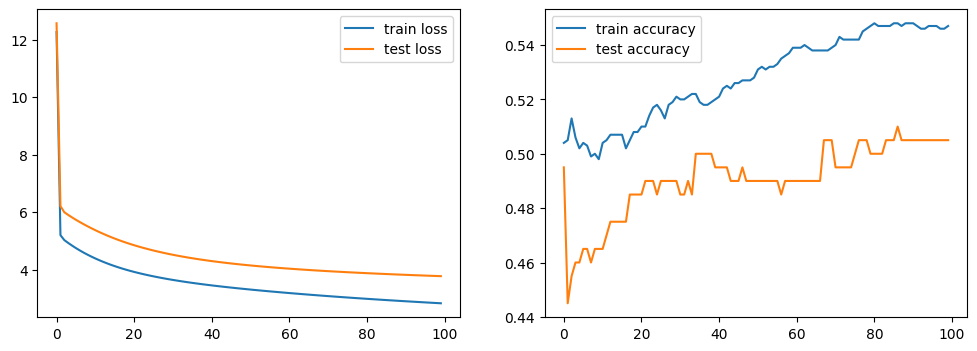

In [63]:
W, b = artificial_neuron(X_train_reshape, y_train, X_test_reshape, y_test, learning_rate = 0.01, n_iterations=1000)

1000 photos n'est pas suffisant pour entrainer notre model de deep learning

de plus, notre model est bien trop simple, nous n'avons ici qu'un seul et unique neurone
il va donc nous falloir faire notre premier réseau de neurone